In [1]:
import numpy as np
import matplotlib.pyplot as plt
import math

In [2]:
a = -2 * math.pi
b = 4 * math.pi

def f(x):
    """Funkcja: f(x) = exp(-3*sin(x)) + 3*cos(x)"""
    return np.array([math.exp(-3*math.sin(xi)) + 3*math.cos(xi) for xi in x])

def f_deriv(x):
    """Pochodna: f'(x) = -3*exp(-3*sin(x))*cos(x) - 3*sin(x)"""
    return np.array([-3*math.exp(-3*math.sin(xi))*math.cos(xi) - 3*math.sin(xi) for xi in x])

In [3]:
def uniform_nodes(a, b, n):
    """Generuje n równomiernych węzłów w przedziale [a, b]."""
    return np.linspace(a, b, n)

def chebyshev_nodes(a, b, n):
    """Generuje węzły Czebyszewa dla przedziału [a, b]."""
    i = np.arange(1, n + 1)
    nodes = np.cos((2 * i - 1) * np.pi / (2 * n))
    nodes = 0.5 * (b - a) * (nodes + 1) + a
    return nodes

In [4]:
# -----------------------------------------------------------
# Funkcje pomocnicze: obliczanie błędów i rysowanie wykresów
# -----------------------------------------------------------
def calculate_error(true_func, spline_func, x_vals):
    y_true = true_func(x_vals)
    y_spline = spline_func(x_vals)
    max_error = np.max(np.abs(y_true - y_spline))
    mean_error = np.sqrt(np.sum((y_true - y_spline)**2)) / len(x_vals)
    return max_error, mean_error

def plot_splines(x_nodes, y_nodes, spline_funcs, labels, title, true_func, a, b):
    x_plot = np.linspace(a, b, 500)
    y_true = true_func(x_plot)
    plt.figure(figsize=(10, 6))
    plt.plot(x_plot, y_true, label="Funkcja f(x)", color='blue')
    
    colors = ['red', 'green', 'orange', 'purple']
    full_title = title + "\n"

    for i, spline in enumerate(spline_funcs):
        y_spline = spline(x_plot)
        max_error = np.max(np.abs(y_true - y_spline))
        mean_error = np.sqrt(np.sum((y_true - y_spline)**2)) / len(x_plot)
        plt.plot(x_plot, y_spline, label=labels[i], color=colors[i])
        full_title += f"{labels[i]}: max={max_error:.2e}, avg={mean_error:.2e}\n"

    plt.scatter(x_nodes, y_nodes, color='black', zorder=5, label="Węzły")
    plt.title(full_title.strip())
    plt.xlabel("x")
    plt.ylabel("y")
    plt.legend()
    plt.grid(True)
    plt.show()


In [5]:
# -----------------------------
# Spline kwadratowe (quadratic)
# -----------------------------
def quadratic_spline_coeffs(x, y, bc_type='natural', f_deriv_func=None):
    """
    Wyznacza współczynniki spline kwadratowego.
    Przyjmujemy postać: s_i(x) = a_i + b_i*(x-x_i) + c_i*(x-x_i)^2, dla i = 0,..., n-2
    Warunki:
      - Interpolacja: s_i(x_i) = y[i], s_i(x_{i+1}) = y[i+1]
      - Ciągłość pierwszej pochodnej: s_i'(x_{i+1}) = s_{i+1}'(x_{i+1]), i = 0,...,n-3
    bc_type:
      - natural: ustalamy c[0] = 0
      - clamped: ustalamy b[0] = f'(x[0])
        (w tej wersji warunek na prawym końcu nie jest dodatkowo wymuszany)
    """
    n = len(x)
    N = n - 1  # liczba przedziałów
    h = np.diff(x)
    b = np.zeros(N)
    c = np.zeros(N)
    
    if bc_type == 'natural':
        c[0] = 0
        b[0] = (y[1] - y[0]) / h[0]
        # Rekurencyjnie wyznaczamy b[i] i c[i] dla i = 1,..., N-1
        for i in range(1, N):
            # Ciągłość pierwszej pochodnej: b[i] = b[i-1] + 2*c[i-1]*h[i-1]
            b[i] = b[i-1] + 2 * c[i-1] * h[i-1]
            # Warunek interpolacji: y[i+1] = y[i] + b[i]*h[i] + c[i]*h[i]**2
            c[i] = (y[i+1] - y[i] - b[i]*h[i]) / (h[i]**2)
    elif bc_type == 'clamped':
        b[0] = f_deriv_func(np.array([x[0]]))[0]
        c[0] = (y[1] - y[0] - b[0]*h[0]) / (h[0]**2)
        for i in range(1, N):
            b[i] = b[i-1] + 2 * c[i-1] * h[i-1]
            c[i] = (y[i+1] - y[i] - b[i]*h[i]) / (h[i]**2)
    else:
        raise ValueError("Nieznany typ warunku brzegowego: wybierz 'natural' lub 'clamped'")
    
    # Dla każdego przedziału s_i(x) = y[i] + b[i]*(x - x[i]) + c[i]*(x - x[i])**2
    coeffs = []
    for i in range(N):
        a = y[i]
        coeffs.append((a, b[i], c[i]))
    return coeffs

def eval_quadratic_spline(x_eval, x_nodes, coeffs):
    """
    Oblicza wartość spline kwadratowego dla x_eval.
    """
    x_eval = np.atleast_1d(x_eval)
    s = np.zeros_like(x_eval)
    N = len(coeffs)
    for i, xi in enumerate(x_eval):
        if xi <= x_nodes[0]:
            j = 0
        elif xi >= x_nodes[-1]:
            j = N - 1
        else:
            j = np.searchsorted(x_nodes, xi) - 1
        dx = xi - x_nodes[j]
        a, b, c = coeffs[j]
        s[i] = a + b*dx + c*dx**2
    return s


In [6]:
# ---------------------------
# Spline sześcienne (cubic)
# ---------------------------

def cubic_spline_coeffs(x, y, bc_type='natural', f_deriv_func=None):
    """
    Wyznacza współczynniki spline sześciennego.
    bc_type: 'natural' lub 'clamped'
      - natural: s''(x[0]) = s''(x[-1]) = 0
      - clamped: s'(x[0]) = f'(x[0]), s'(x[-1]) = f'(x[-1])
    """
    n = len(x)
    h = np.diff(x)
    A = np.zeros((n, n))
    d = np.zeros(n)
    
    if bc_type == 'natural':
        # Warunki naturalne: m0 = m_n = 0
        A[0,0] = 1
        A[-1,-1] = 1
        d[0] = 0
        d[-1] = 0
    elif bc_type == 'clamped':
        # Warunki clamped: s'(x0)=f'(x0) i s'(xn)=f'(xn)
        A[0,0] = 2 * h[0]
        A[0,1] = h[0]
        d[0] = 6 * ((y[1] - y[0]) / h[0] - f_deriv_func(np.array([x[0]]))[0])
        A[-1,-2] = h[-1]
        A[-1,-1] = 2 * h[-1]
        d[-1] = 6 * (f_deriv_func(np.array([x[-1]]))[0] - (y[-1] - y[-2]) / h[-1])
    else:
        raise ValueError("Nieznany typ warunku brzegowego: wybierz 'natural' lub 'clamped'")
        
    # Równania dla węzłów wewnętrznych
    for i in range(1, n-1):
        A[i, i-1] = h[i-1]
        A[i, i]   = 2 * (h[i-1] + h[i])
        A[i, i+1] = h[i]
        d[i] = 6 * ((y[i+1] - y[i]) / h[i] - (y[i] - y[i-1]) / h[i-1])
        
    # Rozwiązanie układu A*m = d, gdzie m to wartości s''(x)
    m = np.linalg.solve(A, d)
    
    # Wyznaczanie współczynników dla przedziału [x_i, x_{i+1}]
    coeffs = []
    for i in range(n-1):
        a = y[i]
        b = (y[i+1] - y[i]) / h[i] - h[i]*(2*m[i] + m[i+1]) / 6
        c = m[i] / 2
        d_coef = (m[i+1] - m[i]) / (6 * h[i])
        coeffs.append((a, b, c, d_coef))
    return coeffs

def eval_cubic_spline(x_eval, x_nodes, coeffs):
    """
    Oblicza wartość spline sześciennego dla x_eval.
    x_eval może być skalarem lub wektorem.
    """
    x_eval = np.atleast_1d(x_eval)
    s = np.zeros_like(x_eval)
    for i, xi in enumerate(x_eval):
        # Znajdź odpowiedni przedział
        if xi <= x_nodes[0]:
            j = 0
        elif xi >= x_nodes[-1]:
            j = len(x_nodes) - 2
        else:
            j = np.searchsorted(x_nodes, xi) - 1
        dx = xi - x_nodes[j]
        a, b, c, d_coef = coeffs[j]
        s[i] = a + b*dx + c*dx**2 + d_coef*dx**3
    return s

In [7]:
import csv

def run_spline_experiment(degree='quadratic', node_type='uniform', a=-2*math.pi, b=4*math.pi, n_min=3, n_max=100):
    if degree == 'quadratic':
        filename = 'spline_quadratic_errors.csv'
        spline_func = quadratic_spline_coeffs
        spline_eval = eval_quadratic_spline
    elif degree == 'cubic':
        filename = 'spline_cubic_errors.csv'
        spline_func = cubic_spline_coeffs
        spline_eval = eval_cubic_spline
    else:
        raise ValueError("Stopień spline'a musi być 'quadratic' albo 'cubic'.")

    get_nodes = chebyshev_nodes if node_type == 'chebyshev' else uniform_nodes

    with open(filename, mode="w", newline="") as csvfile:
        writer = csv.writer(csvfile)
        writer.writerow(["n", "Stopień", "Rodzaj węzłów", "Typ warunku", "Błąd średni", "Błąd maksymalny"])

        for n in range(n_min, n_max + 1):
            x_nodes = get_nodes(a, b, n)
            y_nodes = f(x_nodes)

            for bc_type in ['natural', 'clamped']:
                if bc_type == 'clamped':
                    coeffs = spline_func(x_nodes, y_nodes, bc_type='clamped', f_deriv_func=f_deriv)
                else:
                    coeffs = spline_func(x_nodes, y_nodes, bc_type='natural')

                def spline_interp(x):
                    return spline_eval(x, x_nodes, coeffs)

                x_eval = np.linspace(a, b, 500)
                max_err, mean_err = calculate_error(f, spline_interp, x_eval)

                writer.writerow([
                    n,
                    "2" if degree == 'quadratic' else "3",
                    "Czebyszew" if node_type == 'chebyshev' else "Równomierne",
                    bc_type.capitalize(),
                    f"{mean_err:.6e}",
                    f"{max_err:.6e}"
                ])


In [8]:
run_spline_experiment(degree='quadratic', node_type='uniform')

run_spline_experiment(degree='cubic', node_type='uniform')

------------------
 Dla n = 3 węzłów
------------------



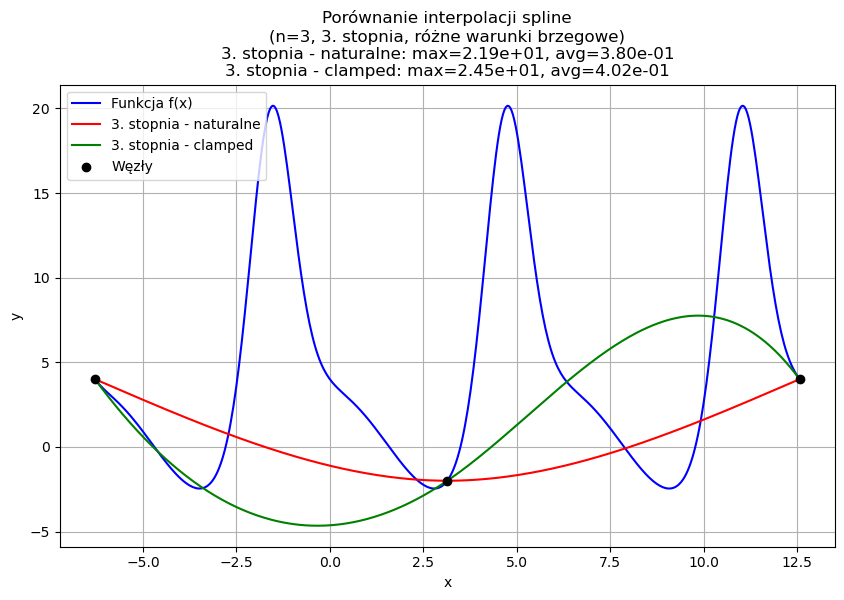

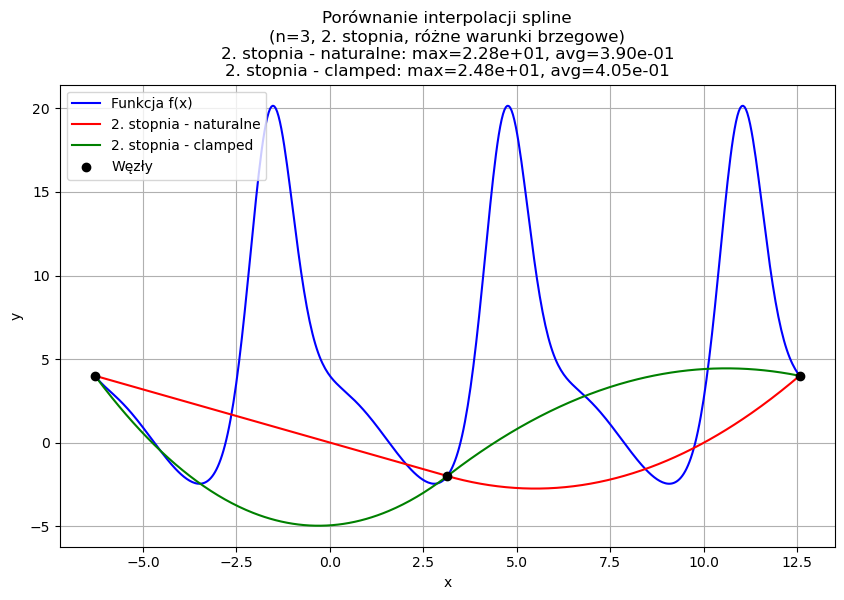

------------------
 Dla n = 3 węzłów
------------------

Cubic natural: błąd maksymalny = 2.191e+01, błąd średni = 3.801e-01
Cubic clamped: błąd maksymalny = 2.449e+01, błąd średni = 4.018e-01
Quadratic natural: błąd maksymalny = 2.283e+01, błąd średni = 3.897e-01
Quadratic clamped: błąd maksymalny = 2.476e+01, błąd średni = 4.046e-01
------------------
 Dla n = 4 węzłów
------------------



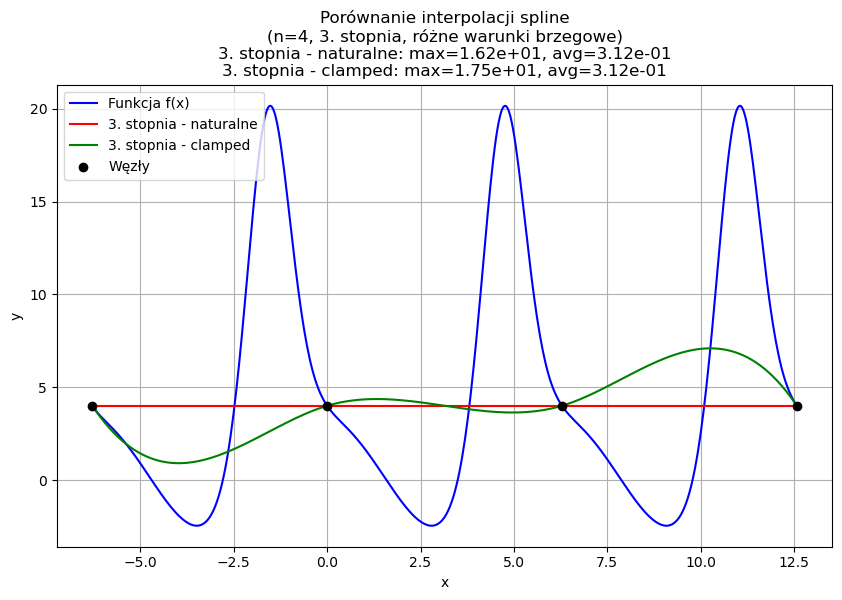

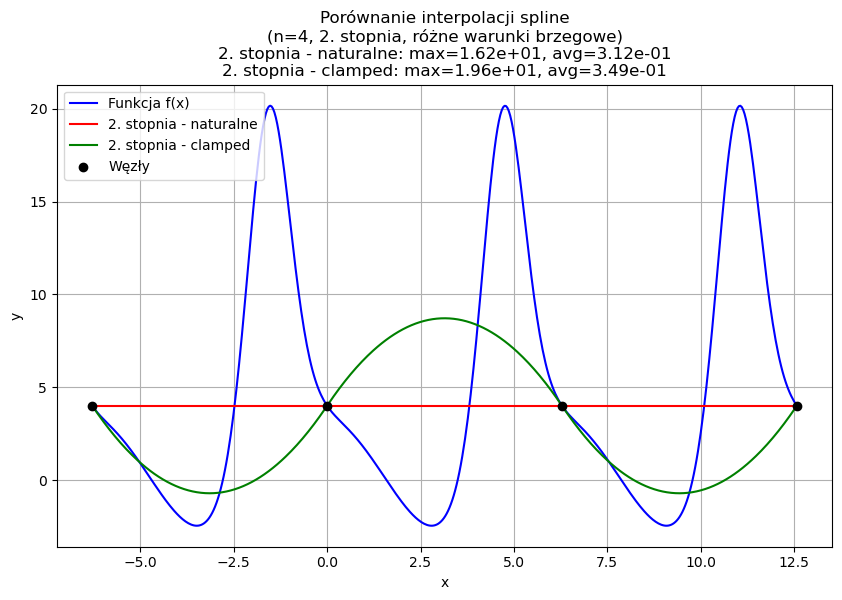

------------------
 Dla n = 4 węzłów
------------------

Cubic natural: błąd maksymalny = 1.616e+01, błąd średni = 3.117e-01
Cubic clamped: błąd maksymalny = 1.752e+01, błąd średni = 3.123e-01
Quadratic natural: błąd maksymalny = 1.616e+01, błąd średni = 3.117e-01
Quadratic clamped: błąd maksymalny = 1.964e+01, błąd średni = 3.494e-01
------------------
 Dla n = 5 węzłów
------------------



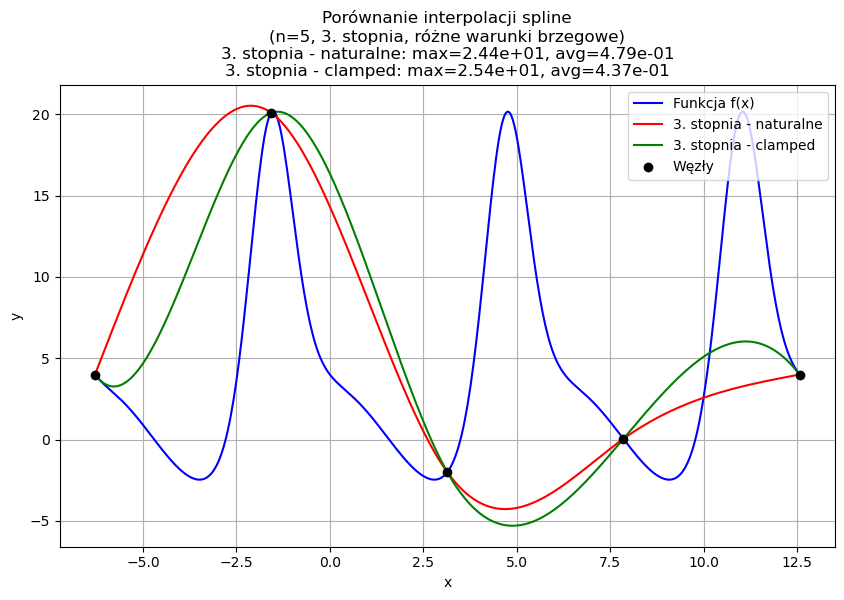

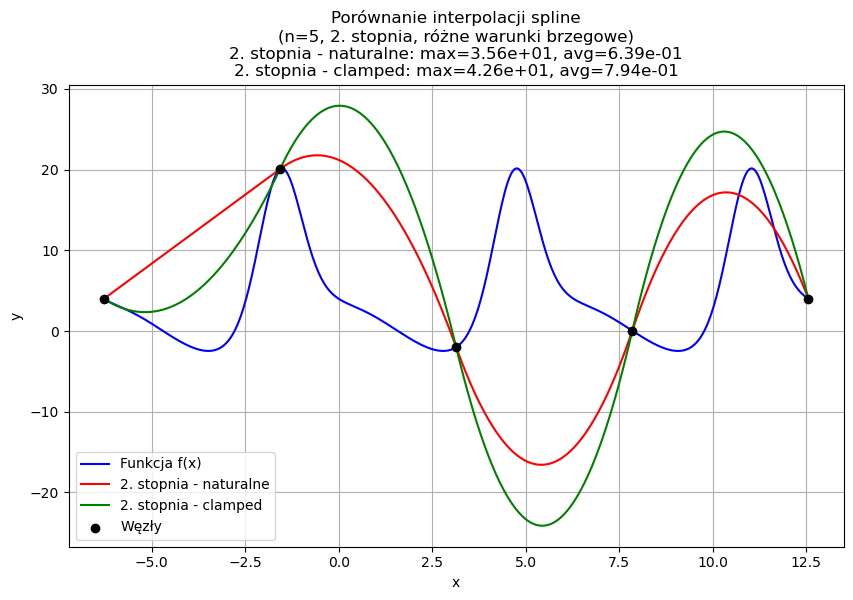

------------------
 Dla n = 5 węzłów
------------------

Cubic natural: błąd maksymalny = 2.442e+01, błąd średni = 4.793e-01
Cubic clamped: błąd maksymalny = 2.543e+01, błąd średni = 4.370e-01
Quadratic natural: błąd maksymalny = 3.562e+01, błąd średni = 6.387e-01
Quadratic clamped: błąd maksymalny = 4.257e+01, błąd średni = 7.940e-01
------------------
 Dla n = 6 węzłów
------------------



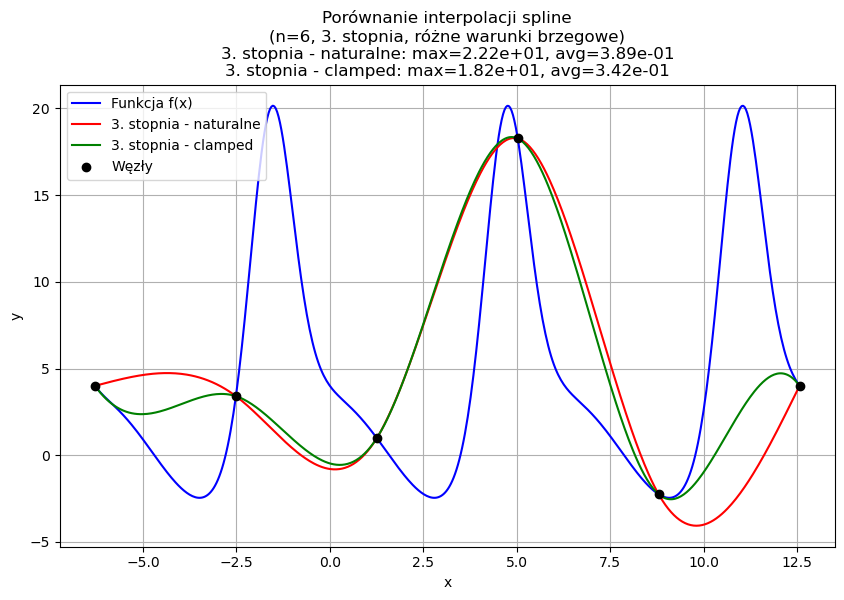

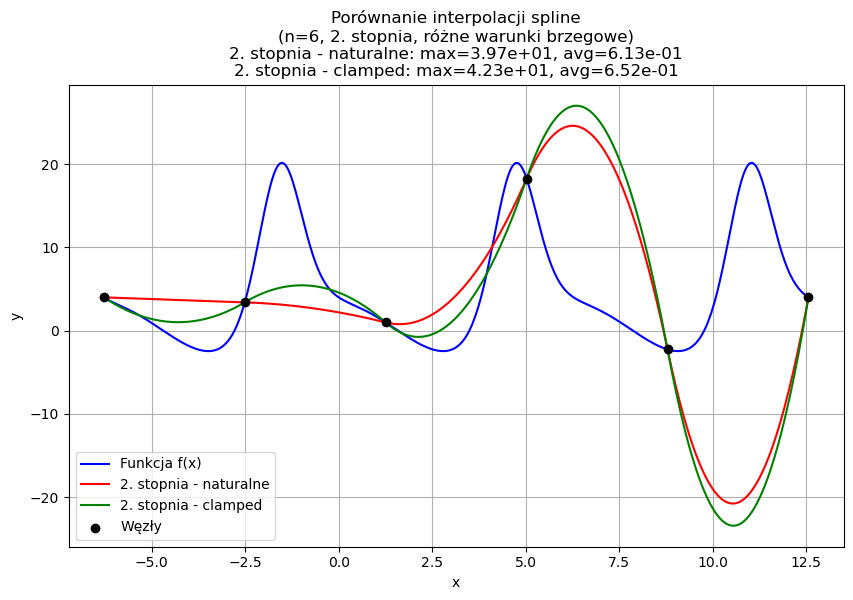

------------------
 Dla n = 6 węzłów
------------------

Cubic natural: błąd maksymalny = 2.222e+01, błąd średni = 3.893e-01
Cubic clamped: błąd maksymalny = 1.823e+01, błąd średni = 3.416e-01
Quadratic natural: błąd maksymalny = 3.965e+01, błąd średni = 6.132e-01
Quadratic clamped: błąd maksymalny = 4.228e+01, błąd średni = 6.516e-01
------------------
 Dla n = 7 węzłów
------------------



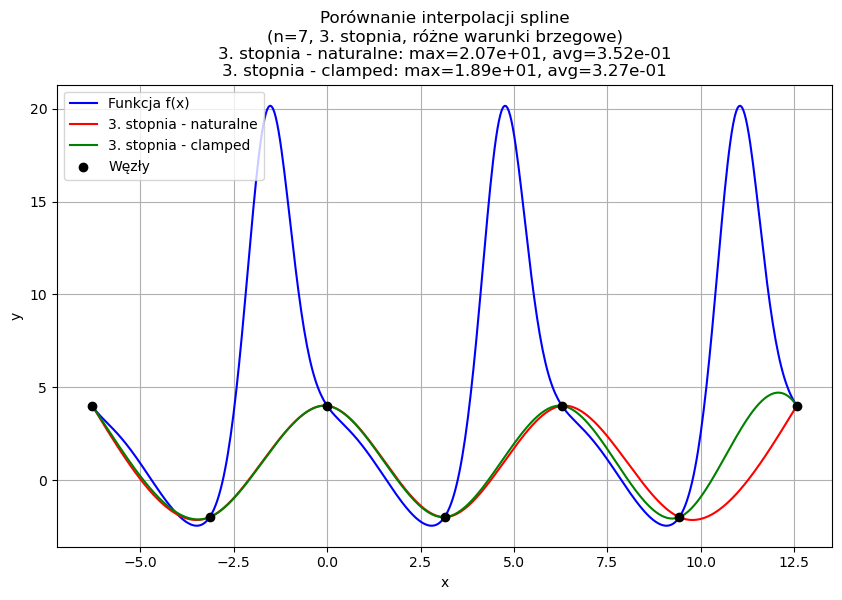

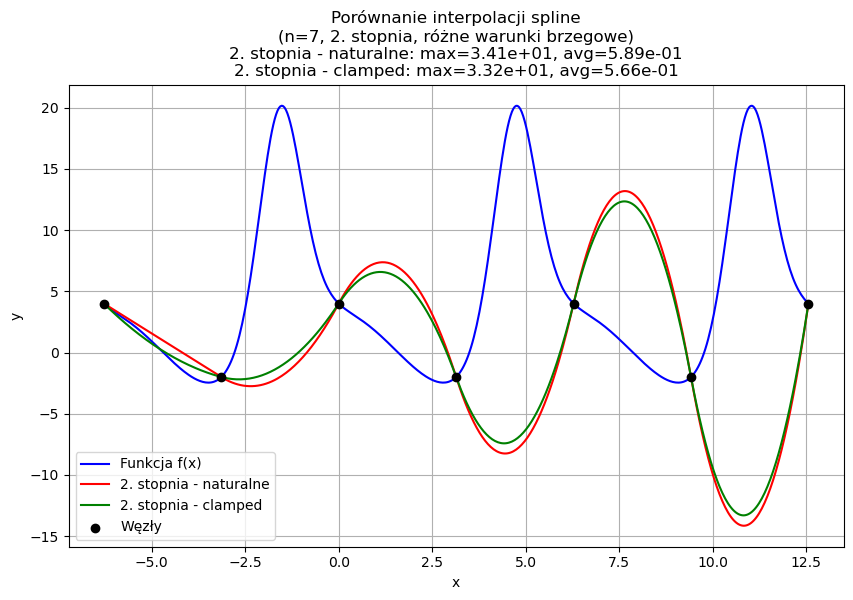

------------------
 Dla n = 7 węzłów
------------------

Cubic natural: błąd maksymalny = 2.073e+01, błąd średni = 3.518e-01
Cubic clamped: błąd maksymalny = 1.895e+01, błąd średni = 3.266e-01
Quadratic natural: błąd maksymalny = 3.409e+01, błąd średni = 5.889e-01
Quadratic clamped: błąd maksymalny = 3.324e+01, błąd średni = 5.657e-01
------------------
 Dla n = 8 węzłów
------------------



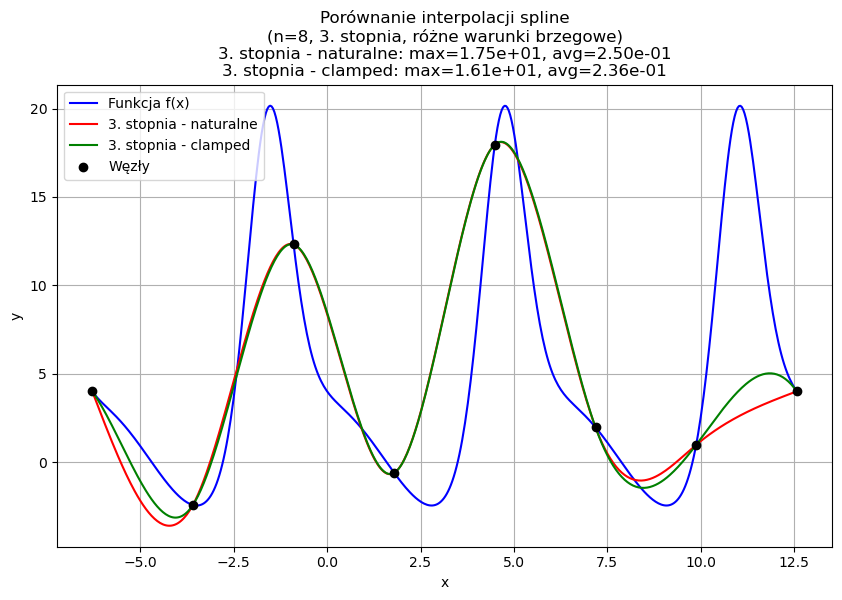

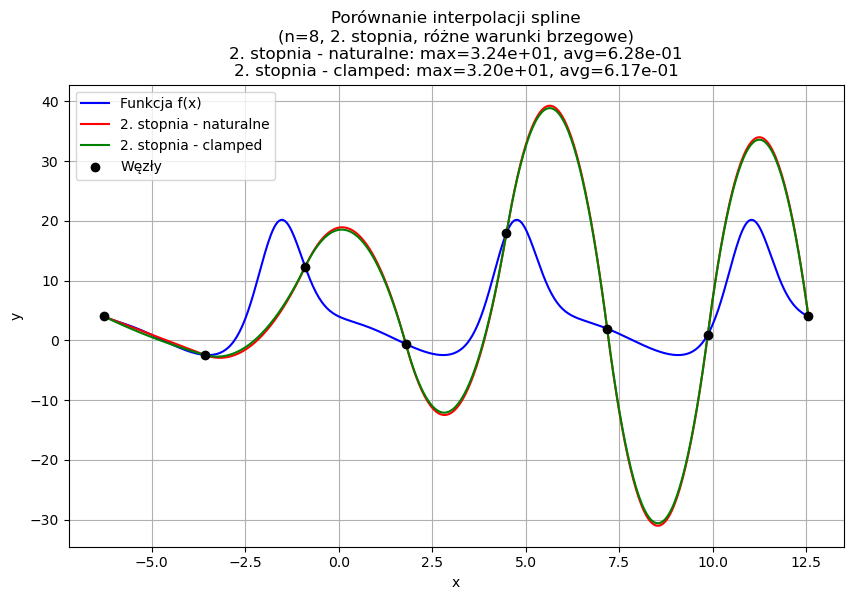

------------------
 Dla n = 8 węzłów
------------------

Cubic natural: błąd maksymalny = 1.754e+01, błąd średni = 2.500e-01
Cubic clamped: błąd maksymalny = 1.609e+01, błąd średni = 2.363e-01
Quadratic natural: błąd maksymalny = 3.238e+01, błąd średni = 6.279e-01
Quadratic clamped: błąd maksymalny = 3.197e+01, błąd średni = 6.168e-01
------------------
 Dla n = 9 węzłów
------------------



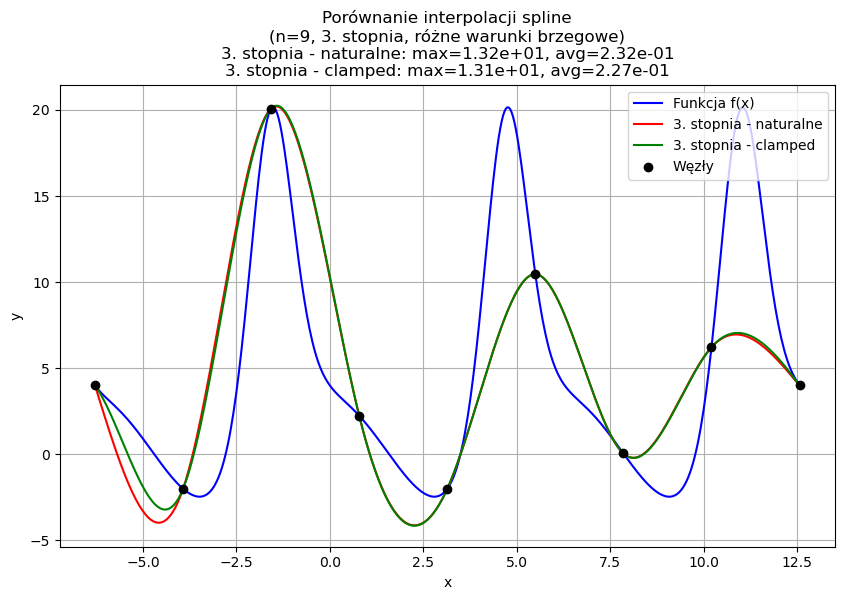

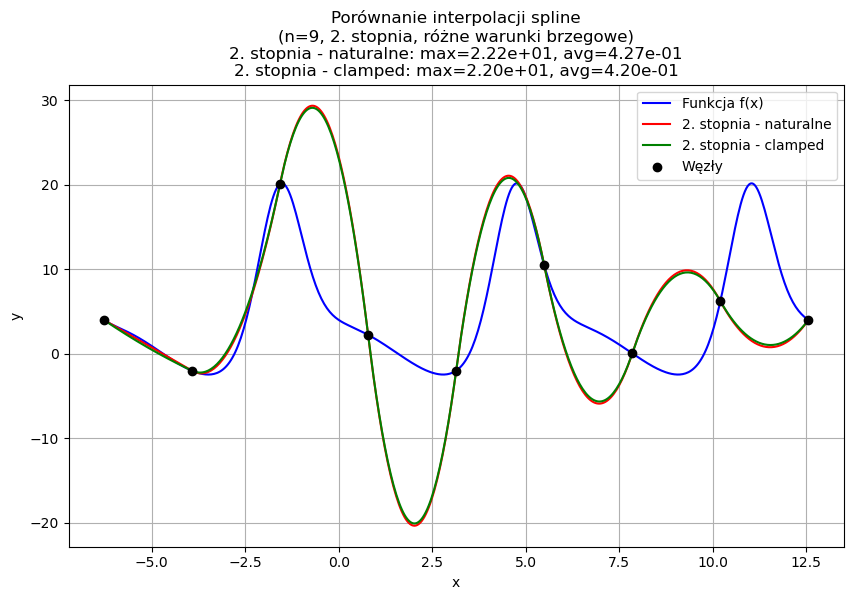

------------------
 Dla n = 9 węzłów
------------------

Cubic natural: błąd maksymalny = 1.325e+01, błąd średni = 2.317e-01
Cubic clamped: błąd maksymalny = 1.314e+01, błąd średni = 2.266e-01
Quadratic natural: błąd maksymalny = 2.224e+01, błąd średni = 4.266e-01
Quadratic clamped: błąd maksymalny = 2.198e+01, błąd średni = 4.198e-01
------------------
 Dla n = 10 węzłów
------------------



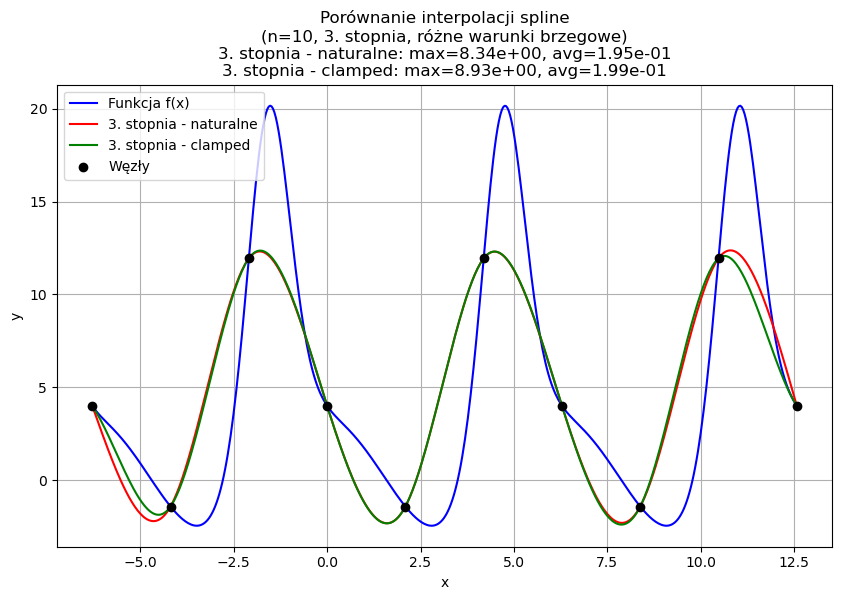

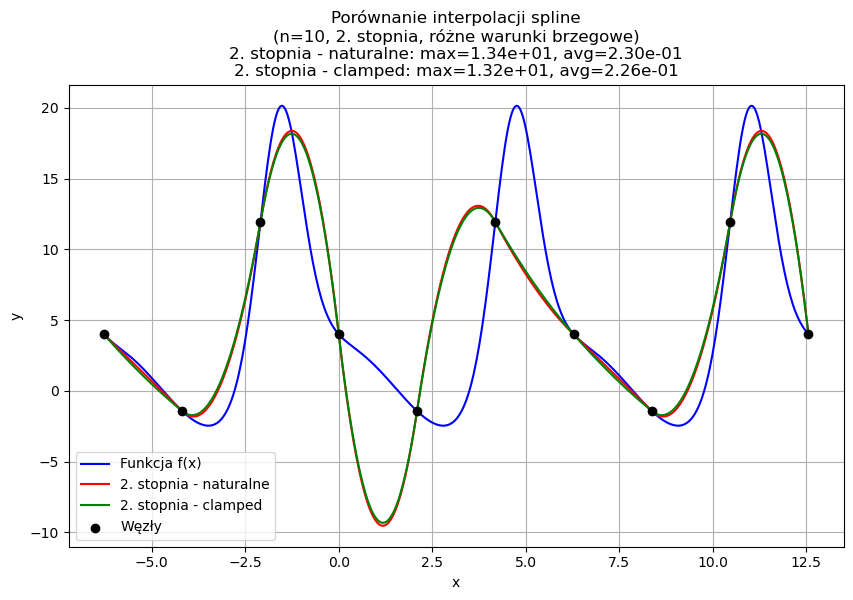

------------------
 Dla n = 10 węzłów
------------------

Cubic natural: błąd maksymalny = 8.343e+00, błąd średni = 1.954e-01
Cubic clamped: błąd maksymalny = 8.929e+00, błąd średni = 1.986e-01
Quadratic natural: błąd maksymalny = 1.345e+01, błąd średni = 2.298e-01
Quadratic clamped: błąd maksymalny = 1.324e+01, błąd średni = 2.263e-01
------------------
 Dla n = 11 węzłów
------------------



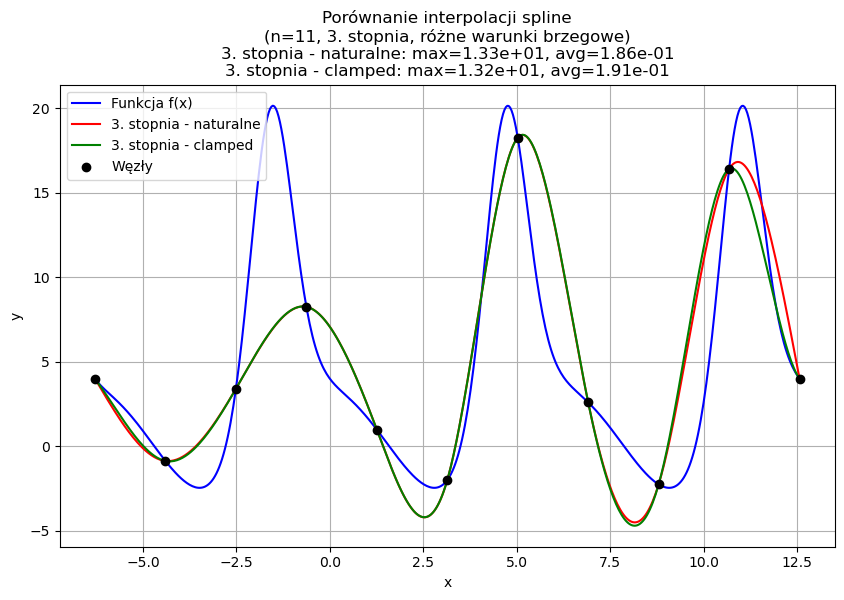

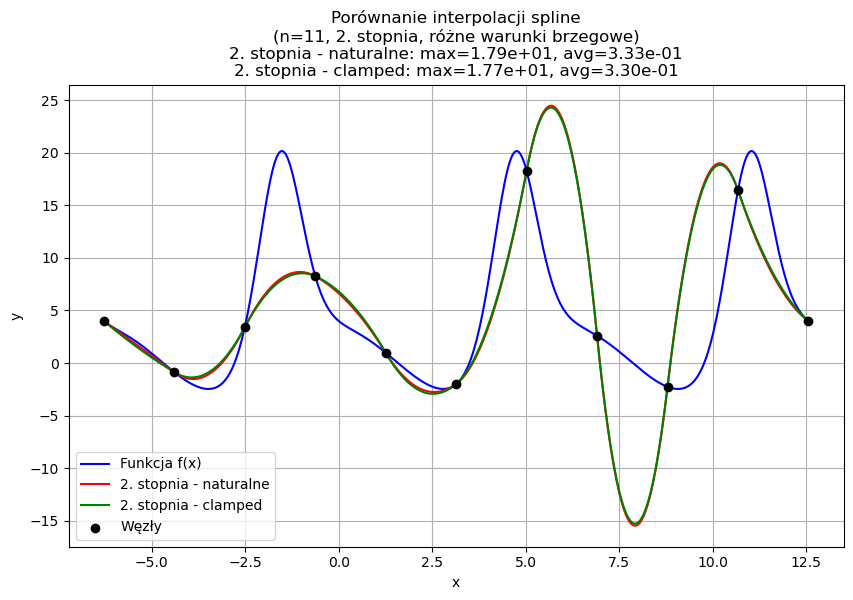

------------------
 Dla n = 11 węzłów
------------------

Cubic natural: błąd maksymalny = 1.325e+01, błąd średni = 1.862e-01
Cubic clamped: błąd maksymalny = 1.323e+01, błąd średni = 1.907e-01
Quadratic natural: błąd maksymalny = 1.793e+01, błąd średni = 3.331e-01
Quadratic clamped: błąd maksymalny = 1.774e+01, błąd średni = 3.303e-01
------------------
 Dla n = 12 węzłów
------------------



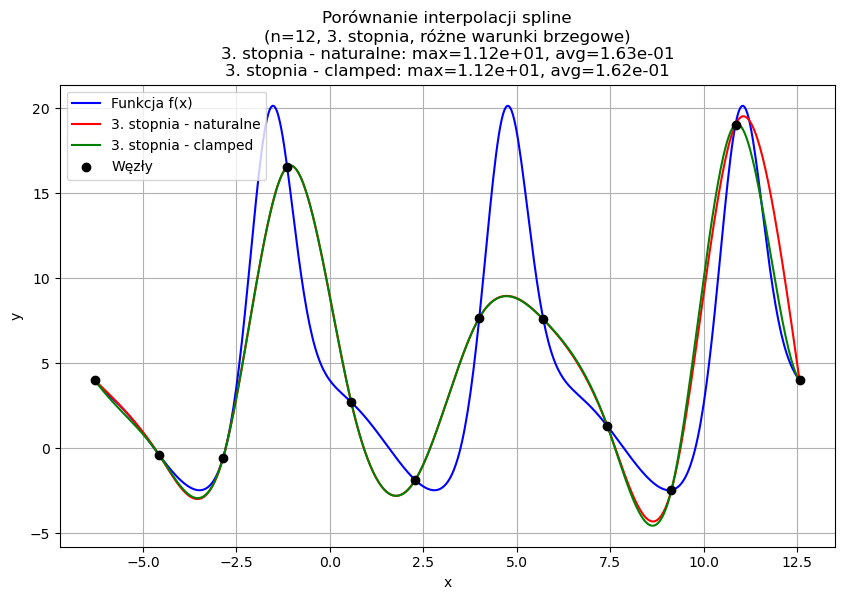

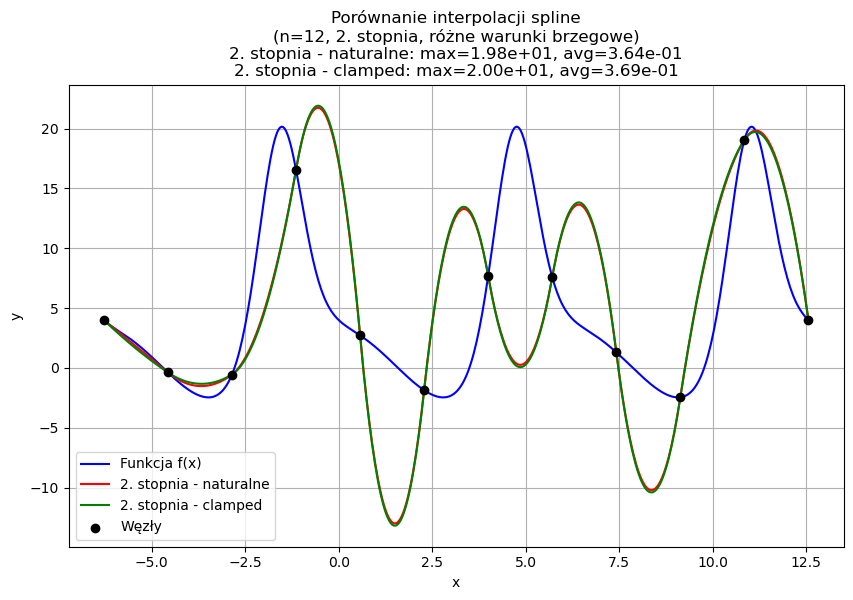

------------------
 Dla n = 12 węzłów
------------------

Cubic natural: błąd maksymalny = 1.118e+01, błąd średni = 1.626e-01
Cubic clamped: błąd maksymalny = 1.120e+01, błąd średni = 1.621e-01
Quadratic natural: błąd maksymalny = 1.983e+01, błąd średni = 3.640e-01
Quadratic clamped: błąd maksymalny = 2.002e+01, błąd średni = 3.689e-01
------------------
 Dla n = 13 węzłów
------------------



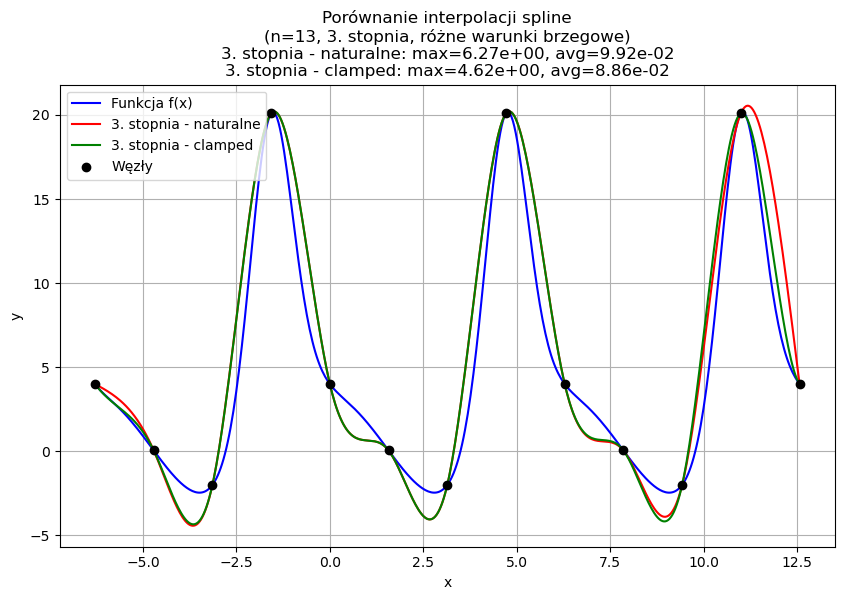

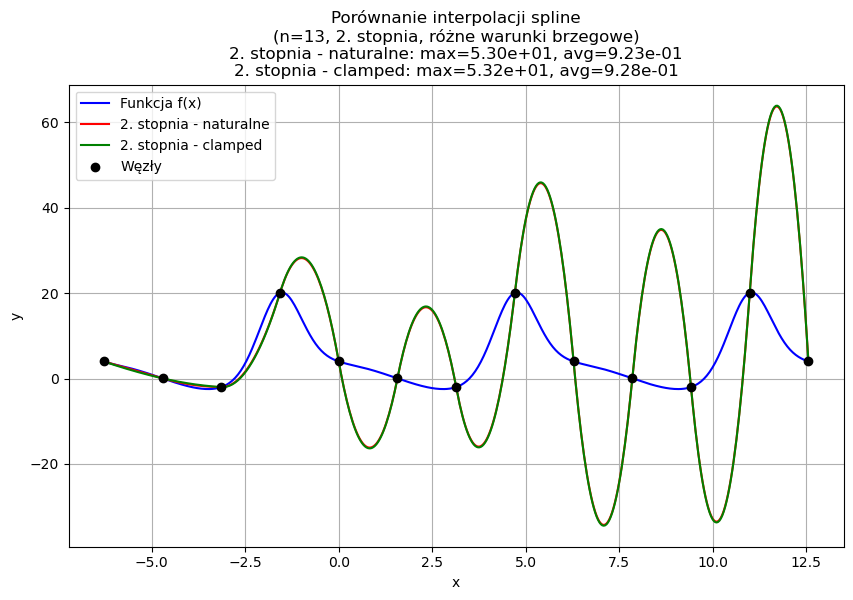

------------------
 Dla n = 13 węzłów
------------------

Cubic natural: błąd maksymalny = 6.274e+00, błąd średni = 9.915e-02
Cubic clamped: błąd maksymalny = 4.616e+00, błąd średni = 8.860e-02
Quadratic natural: błąd maksymalny = 5.303e+01, błąd średni = 9.234e-01
Quadratic clamped: błąd maksymalny = 5.322e+01, błąd średni = 9.285e-01
------------------
 Dla n = 14 węzłów
------------------



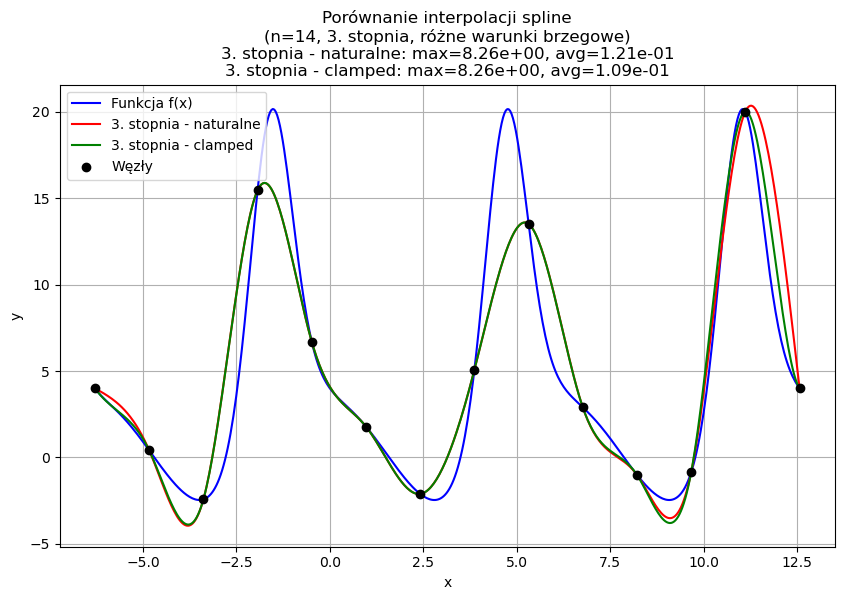

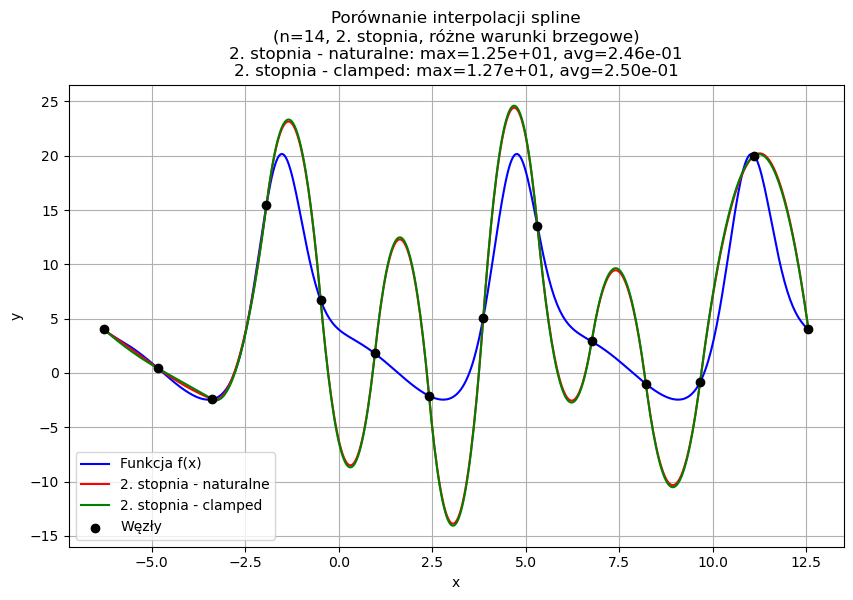

------------------
 Dla n = 14 węzłów
------------------

Cubic natural: błąd maksymalny = 8.261e+00, błąd średni = 1.207e-01
Cubic clamped: błąd maksymalny = 8.256e+00, błąd średni = 1.090e-01
Quadratic natural: błąd maksymalny = 1.253e+01, błąd średni = 2.459e-01
Quadratic clamped: błąd maksymalny = 1.272e+01, błąd średni = 2.502e-01
------------------
 Dla n = 15 węzłów
------------------



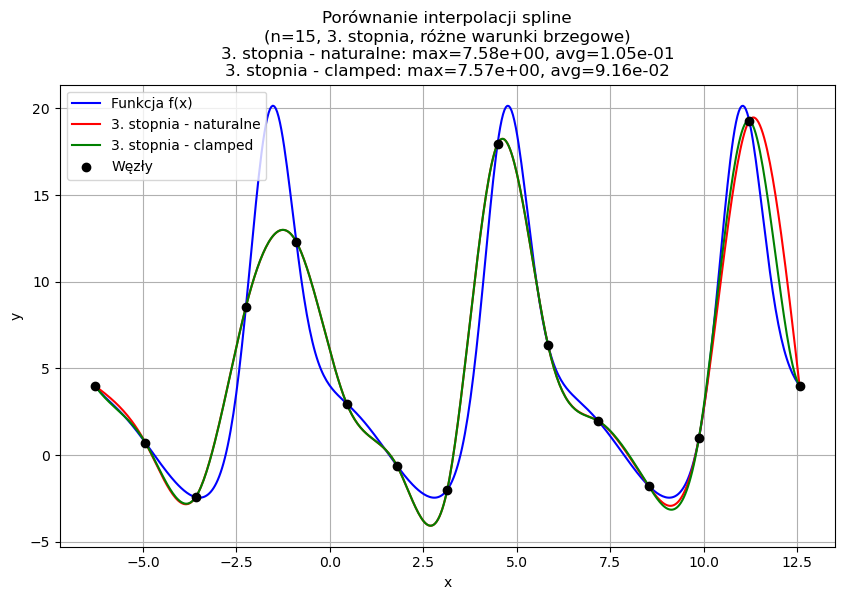

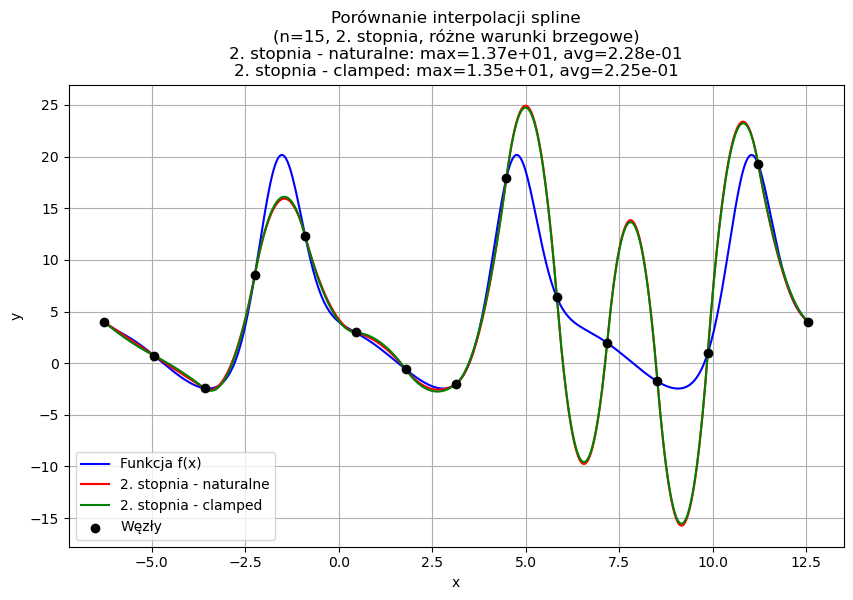

------------------
 Dla n = 15 węzłów
------------------

Cubic natural: błąd maksymalny = 7.579e+00, błąd średni = 1.048e-01
Cubic clamped: błąd maksymalny = 7.574e+00, błąd średni = 9.159e-02
Quadratic natural: błąd maksymalny = 1.372e+01, błąd średni = 2.285e-01
Quadratic clamped: błąd maksymalny = 1.353e+01, błąd średni = 2.247e-01
------------------
 Dla n = 16 węzłów
------------------



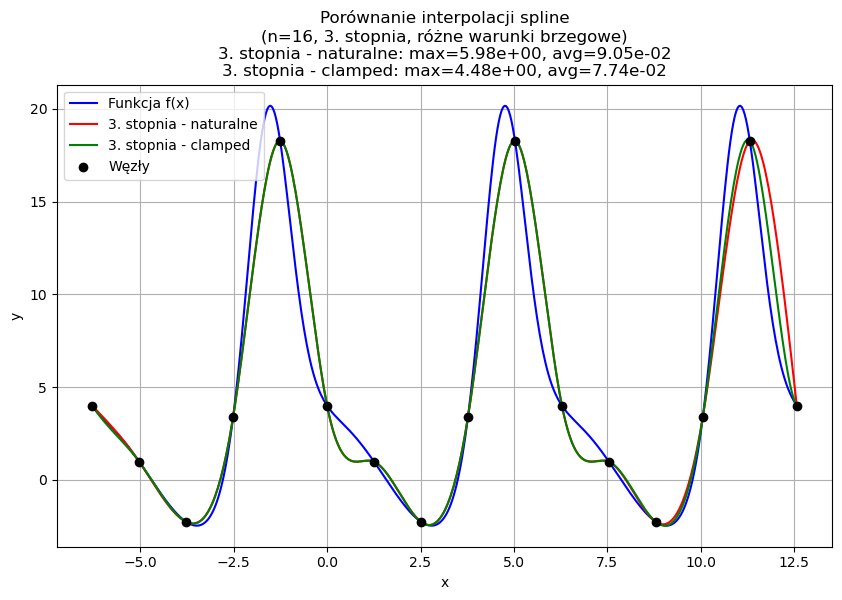

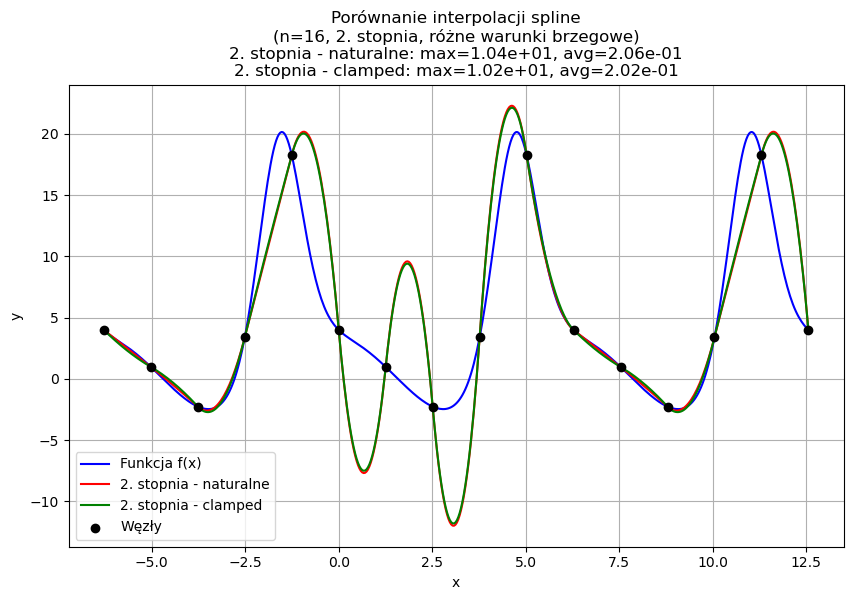

------------------
 Dla n = 16 węzłów
------------------

Cubic natural: błąd maksymalny = 5.981e+00, błąd średni = 9.045e-02
Cubic clamped: błąd maksymalny = 4.478e+00, błąd średni = 7.742e-02
Quadratic natural: błąd maksymalny = 1.040e+01, błąd średni = 2.059e-01
Quadratic clamped: błąd maksymalny = 1.021e+01, błąd średni = 2.017e-01
------------------
 Dla n = 17 węzłów
------------------



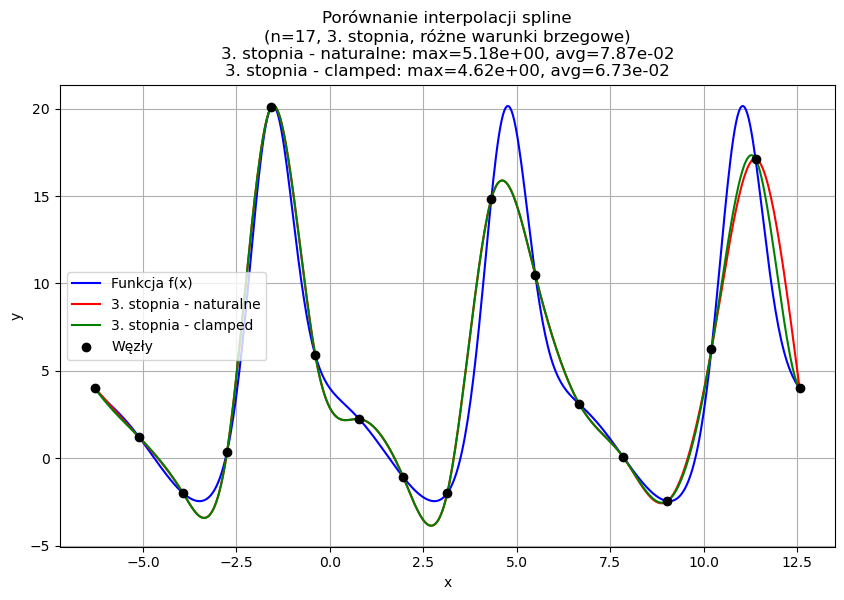

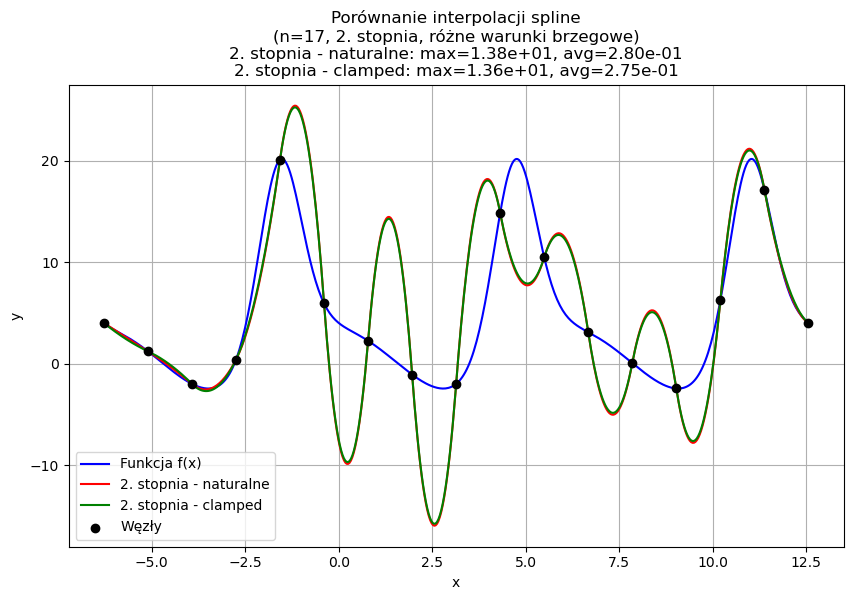

------------------
 Dla n = 17 węzłów
------------------

Cubic natural: błąd maksymalny = 5.183e+00, błąd średni = 7.870e-02
Cubic clamped: błąd maksymalny = 4.618e+00, błąd średni = 6.728e-02
Quadratic natural: błąd maksymalny = 1.376e+01, błąd średni = 2.796e-01
Quadratic clamped: błąd maksymalny = 1.358e+01, błąd średni = 2.749e-01
------------------
 Dla n = 18 węzłów
------------------



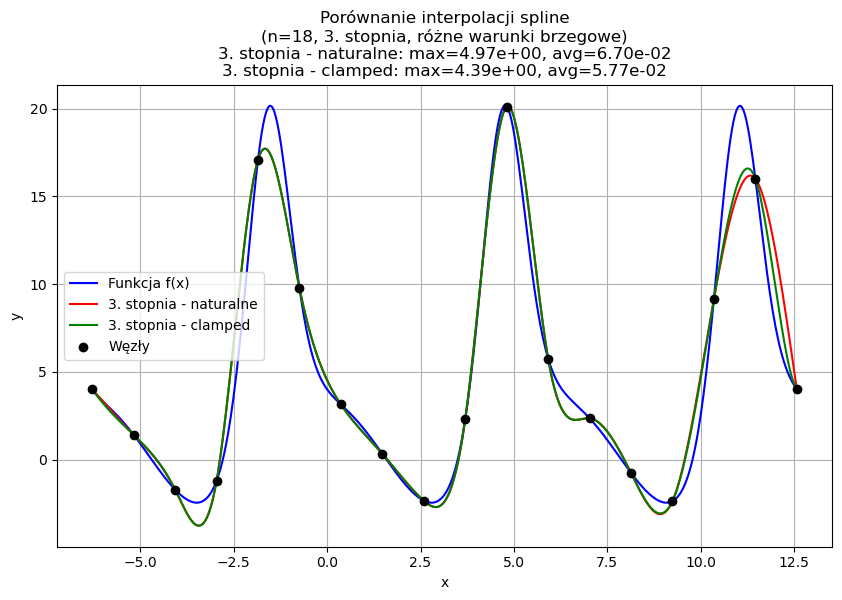

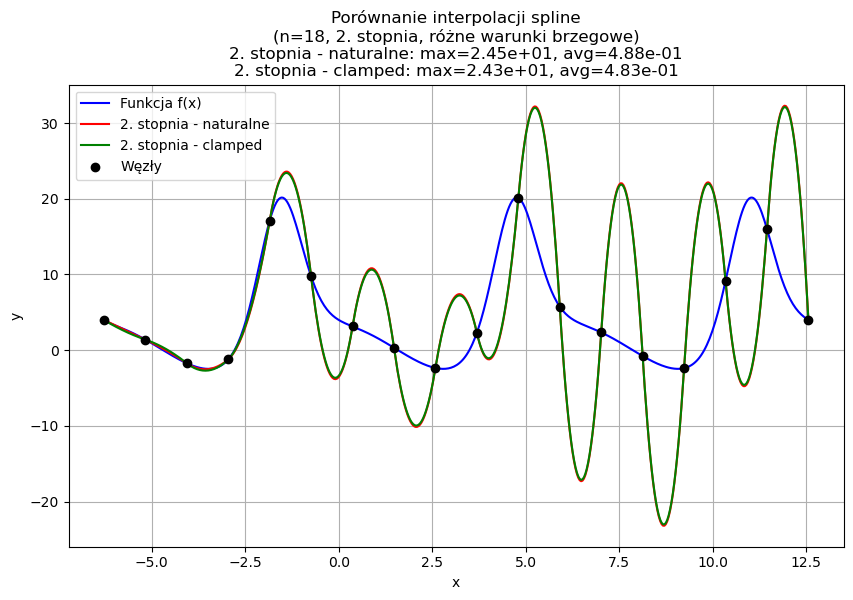

------------------
 Dla n = 18 węzłów
------------------

Cubic natural: błąd maksymalny = 4.970e+00, błąd średni = 6.696e-02
Cubic clamped: błąd maksymalny = 4.392e+00, błąd średni = 5.773e-02
Quadratic natural: błąd maksymalny = 2.447e+01, błąd średni = 4.876e-01
Quadratic clamped: błąd maksymalny = 2.429e+01, błąd średni = 4.828e-01
------------------
 Dla n = 19 węzłów
------------------



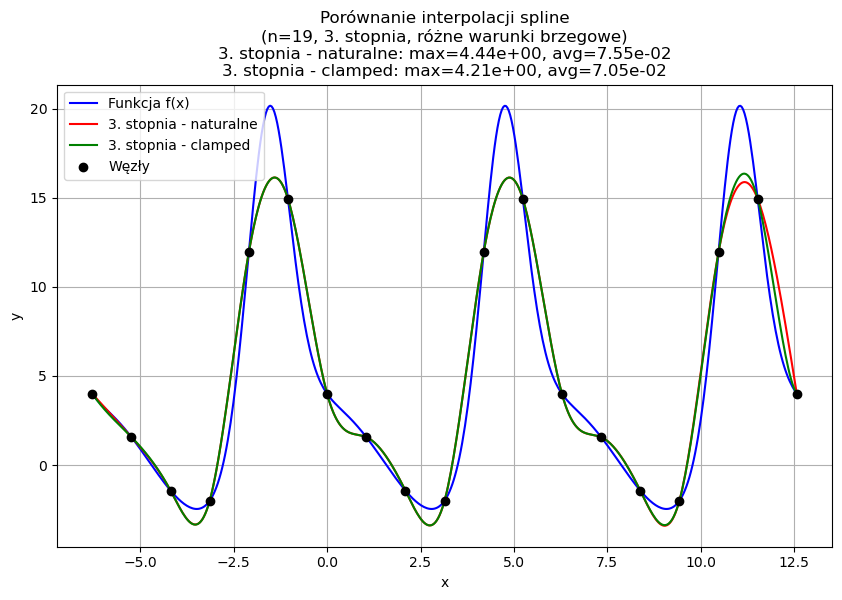

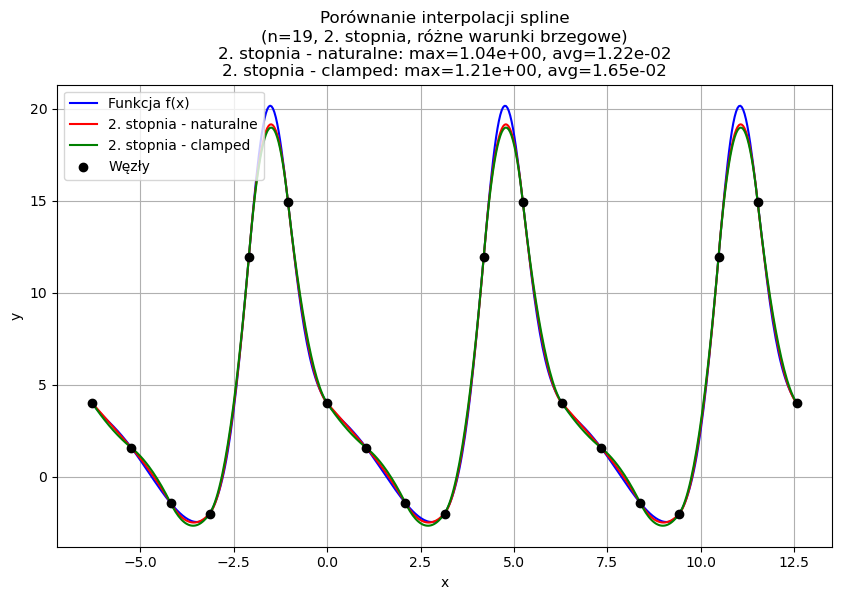

------------------
 Dla n = 19 węzłów
------------------

Cubic natural: błąd maksymalny = 4.439e+00, błąd średni = 7.551e-02
Cubic clamped: błąd maksymalny = 4.206e+00, błąd średni = 7.055e-02
Quadratic natural: błąd maksymalny = 1.036e+00, błąd średni = 1.222e-02
Quadratic clamped: błąd maksymalny = 1.215e+00, błąd średni = 1.654e-02
------------------
 Dla n = 20 węzłów
------------------



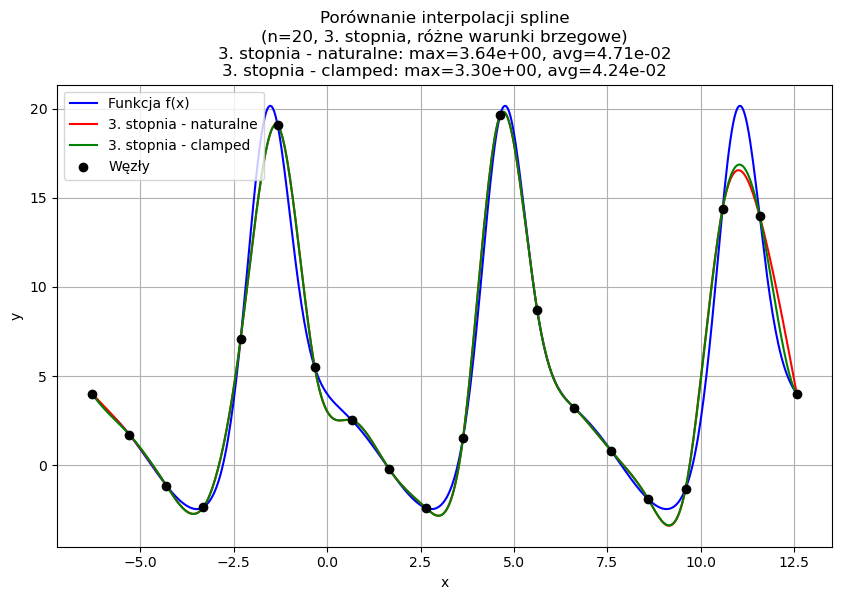

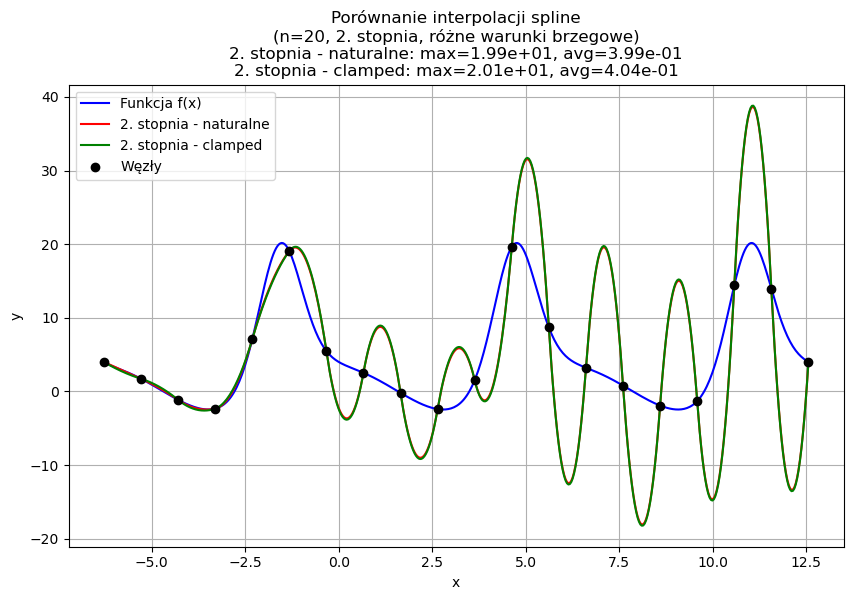

------------------
 Dla n = 20 węzłów
------------------

Cubic natural: błąd maksymalny = 3.637e+00, błąd średni = 4.709e-02
Cubic clamped: błąd maksymalny = 3.302e+00, błąd średni = 4.241e-02
Quadratic natural: błąd maksymalny = 1.992e+01, błąd średni = 3.989e-01
Quadratic clamped: błąd maksymalny = 2.009e+01, błąd średni = 4.035e-01
------------------
 Dla n = 21 węzłów
------------------



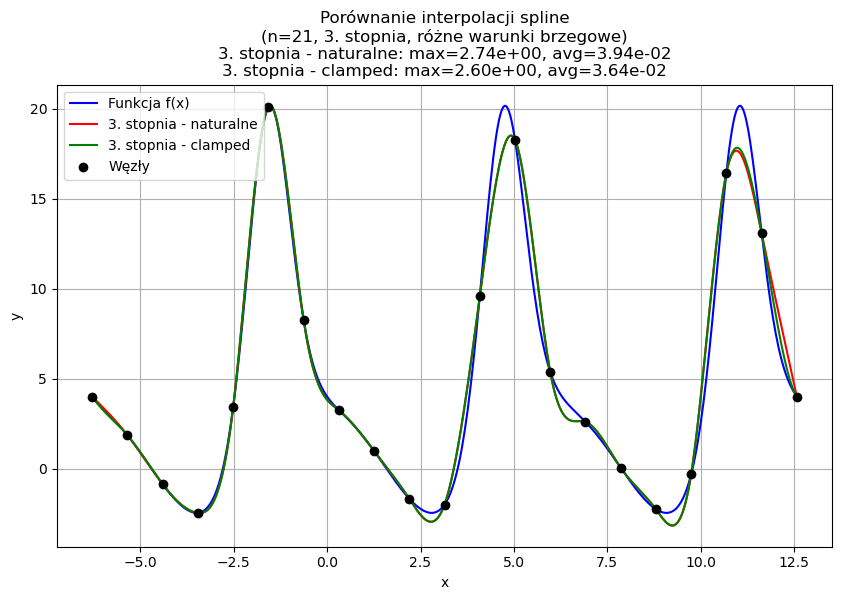

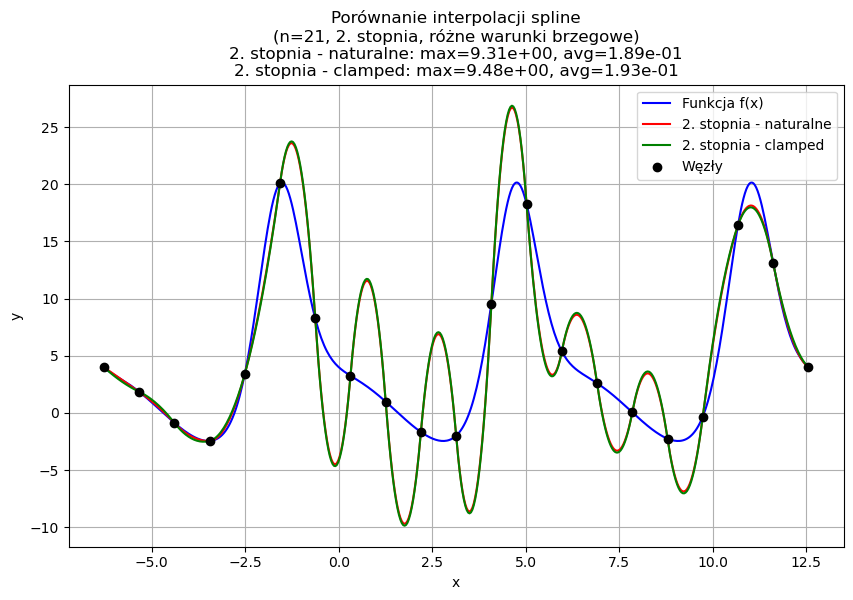

------------------
 Dla n = 21 węzłów
------------------

Cubic natural: błąd maksymalny = 2.742e+00, błąd średni = 3.935e-02
Cubic clamped: błąd maksymalny = 2.596e+00, błąd średni = 3.639e-02
Quadratic natural: błąd maksymalny = 9.309e+00, błąd średni = 1.889e-01
Quadratic clamped: błąd maksymalny = 9.479e+00, błąd średni = 1.934e-01
------------------
 Dla n = 22 węzłów
------------------



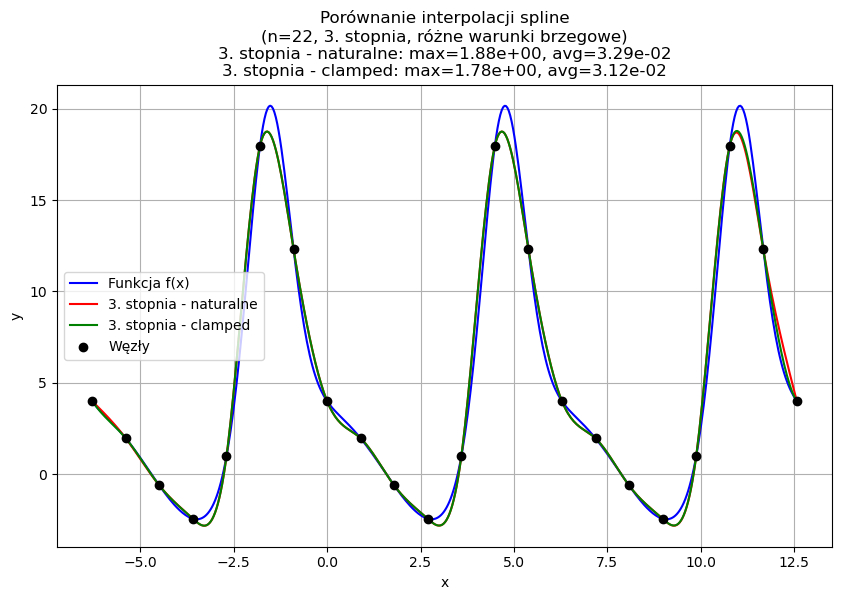

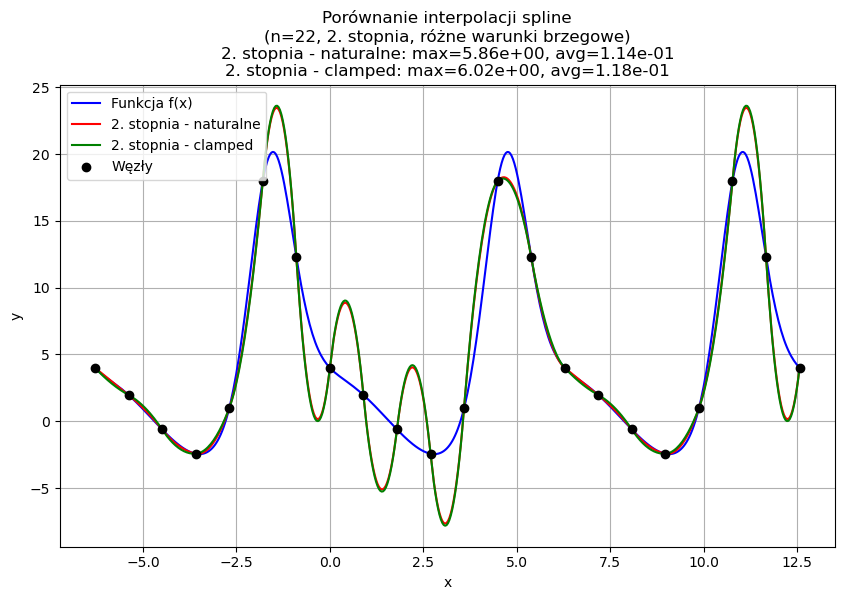

------------------
 Dla n = 22 węzłów
------------------

Cubic natural: błąd maksymalny = 1.884e+00, błąd średni = 3.294e-02
Cubic clamped: błąd maksymalny = 1.781e+00, błąd średni = 3.123e-02
Quadratic natural: błąd maksymalny = 5.856e+00, błąd średni = 1.140e-01
Quadratic clamped: błąd maksymalny = 6.020e+00, błąd średni = 1.179e-01
------------------
 Dla n = 23 węzłów
------------------



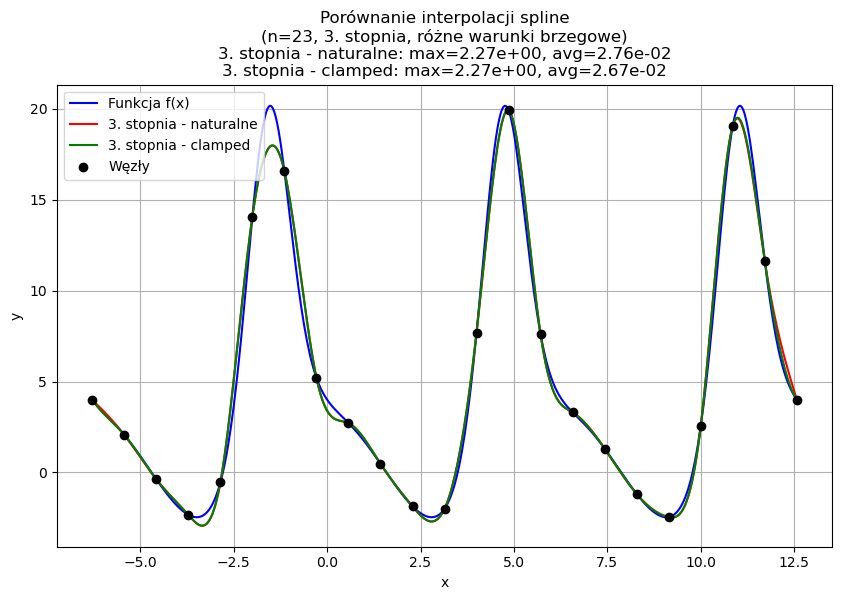

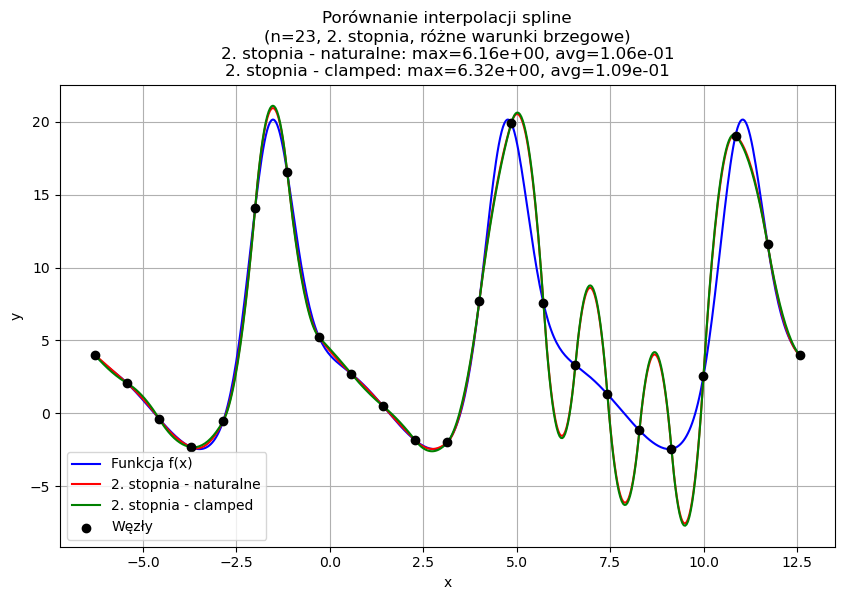

------------------
 Dla n = 23 węzłów
------------------

Cubic natural: błąd maksymalny = 2.270e+00, błąd średni = 2.763e-02
Cubic clamped: błąd maksymalny = 2.270e+00, błąd średni = 2.674e-02
Quadratic natural: błąd maksymalny = 6.162e+00, błąd średni = 1.060e-01
Quadratic clamped: błąd maksymalny = 6.322e+00, błąd średni = 1.094e-01
------------------
 Dla n = 24 węzłów
------------------



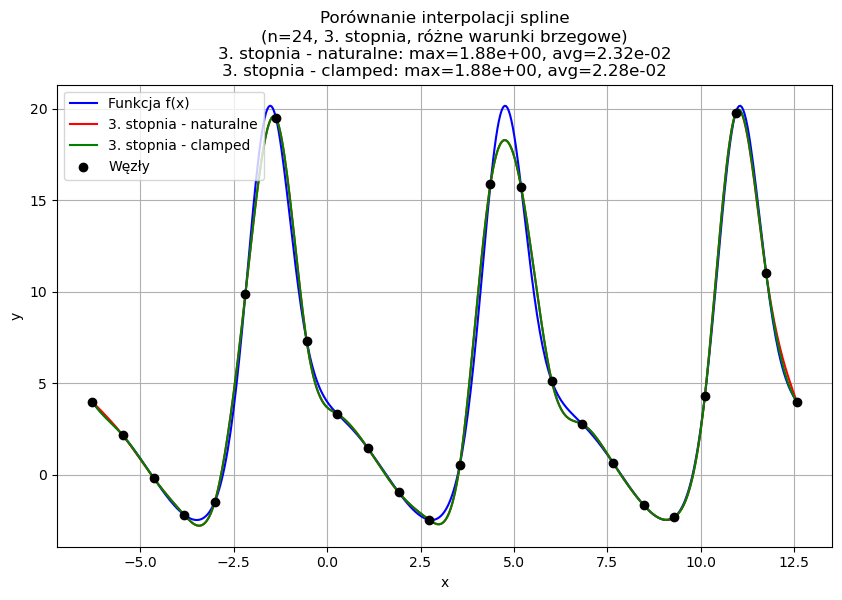

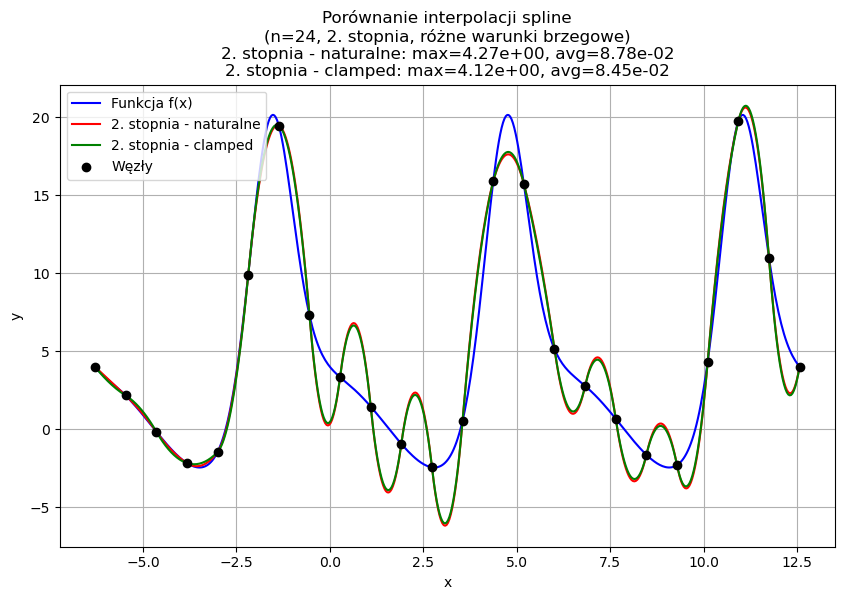

------------------
 Dla n = 24 węzłów
------------------

Cubic natural: błąd maksymalny = 1.876e+00, błąd średni = 2.321e-02
Cubic clamped: błąd maksymalny = 1.876e+00, błąd średni = 2.282e-02
Quadratic natural: błąd maksymalny = 4.271e+00, błąd średni = 8.784e-02
Quadratic clamped: błąd maksymalny = 4.117e+00, błąd średni = 8.453e-02
------------------
 Dla n = 25 węzłów
------------------



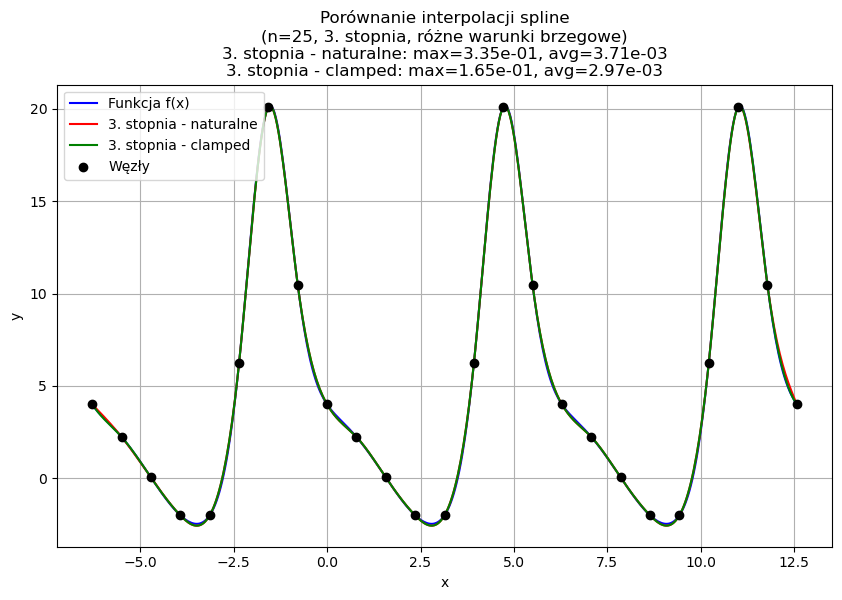

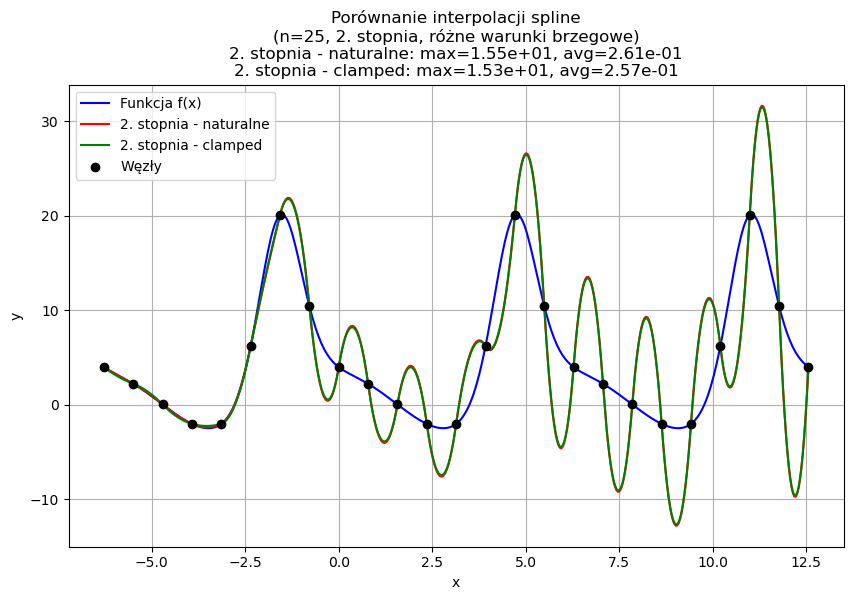

------------------
 Dla n = 25 węzłów
------------------

Cubic natural: błąd maksymalny = 3.351e-01, błąd średni = 3.706e-03
Cubic clamped: błąd maksymalny = 1.654e-01, błąd średni = 2.966e-03
Quadratic natural: błąd maksymalny = 1.549e+01, błąd średni = 2.606e-01
Quadratic clamped: błąd maksymalny = 1.534e+01, błąd średni = 2.566e-01
------------------
 Dla n = 26 węzłów
------------------



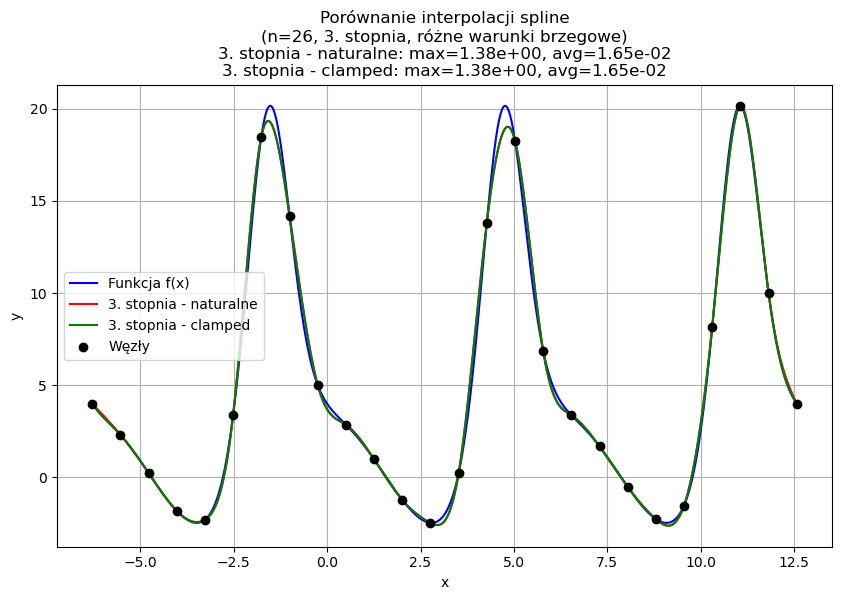

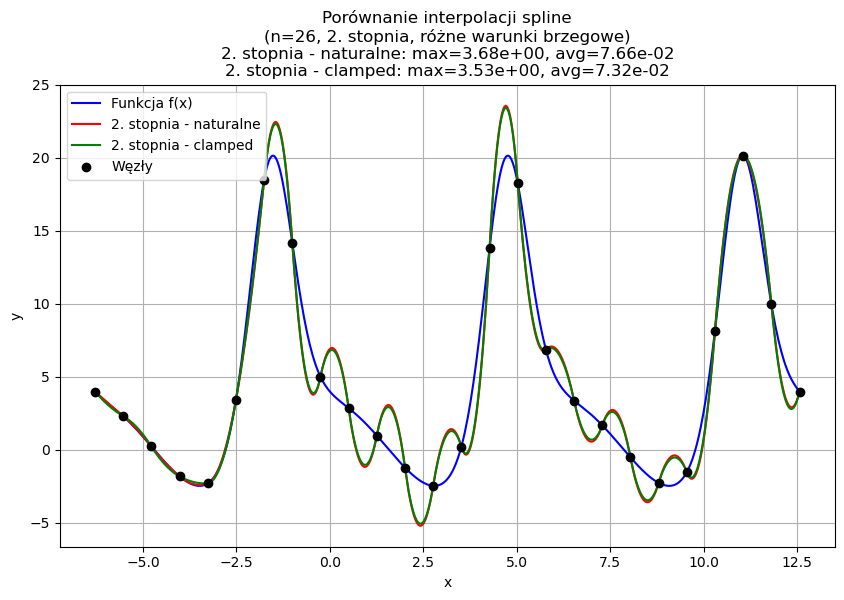

------------------
 Dla n = 26 węzłów
------------------

Cubic natural: błąd maksymalny = 1.383e+00, błąd średni = 1.646e-02
Cubic clamped: błąd maksymalny = 1.383e+00, błąd średni = 1.645e-02
Quadratic natural: błąd maksymalny = 3.675e+00, błąd średni = 7.662e-02
Quadratic clamped: błąd maksymalny = 3.531e+00, błąd średni = 7.323e-02
------------------
 Dla n = 27 węzłów
------------------



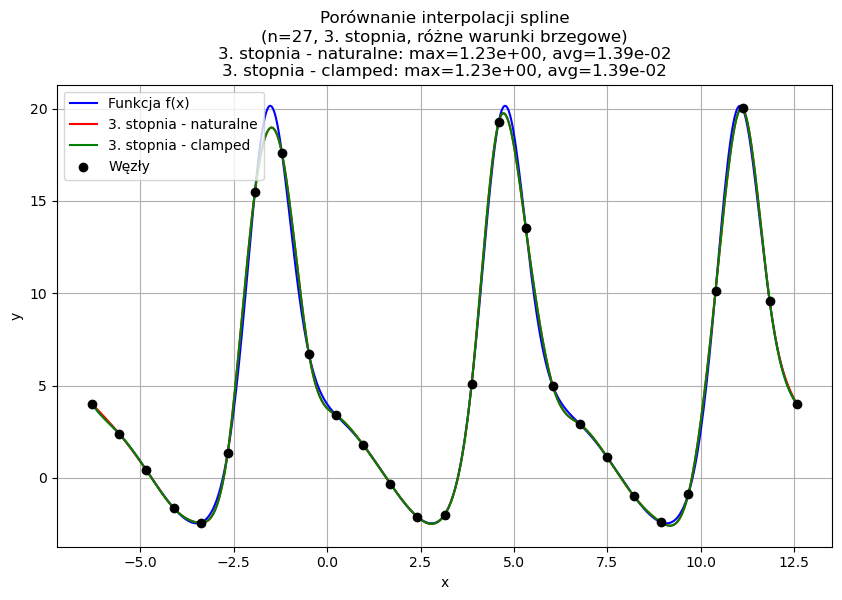

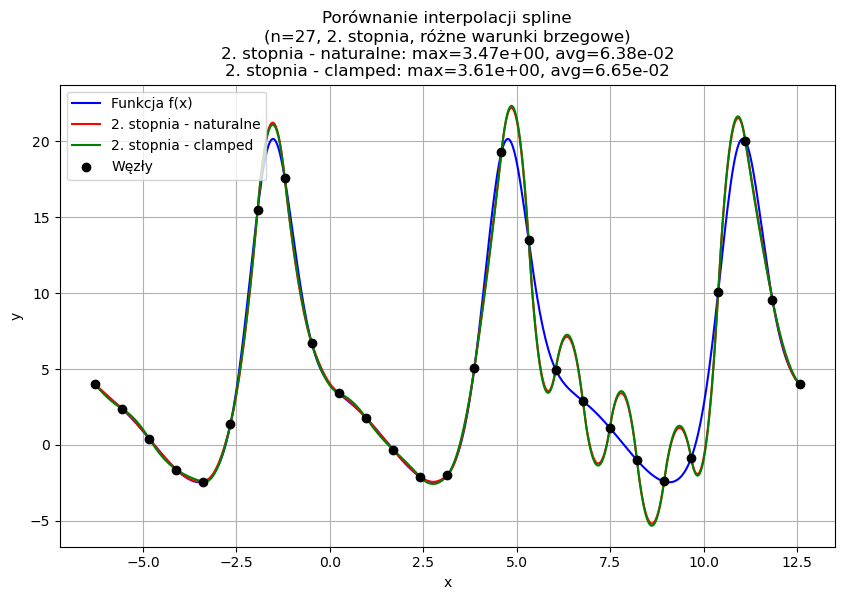

------------------
 Dla n = 27 węzłów
------------------

Cubic natural: błąd maksymalny = 1.230e+00, błąd średni = 1.390e-02
Cubic clamped: błąd maksymalny = 1.230e+00, błąd średni = 1.394e-02
Quadratic natural: błąd maksymalny = 3.472e+00, błąd średni = 6.382e-02
Quadratic clamped: błąd maksymalny = 3.611e+00, błąd średni = 6.648e-02
------------------
 Dla n = 28 węzłów
------------------



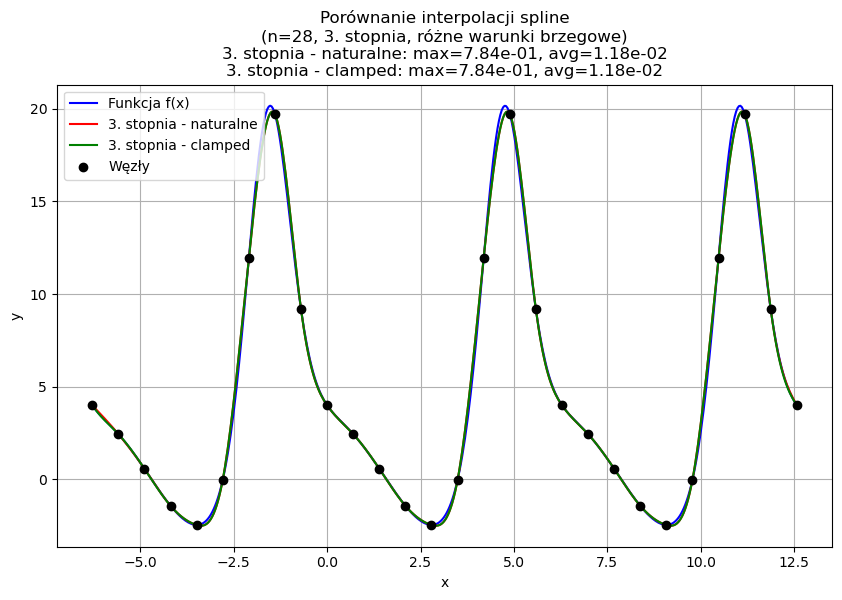

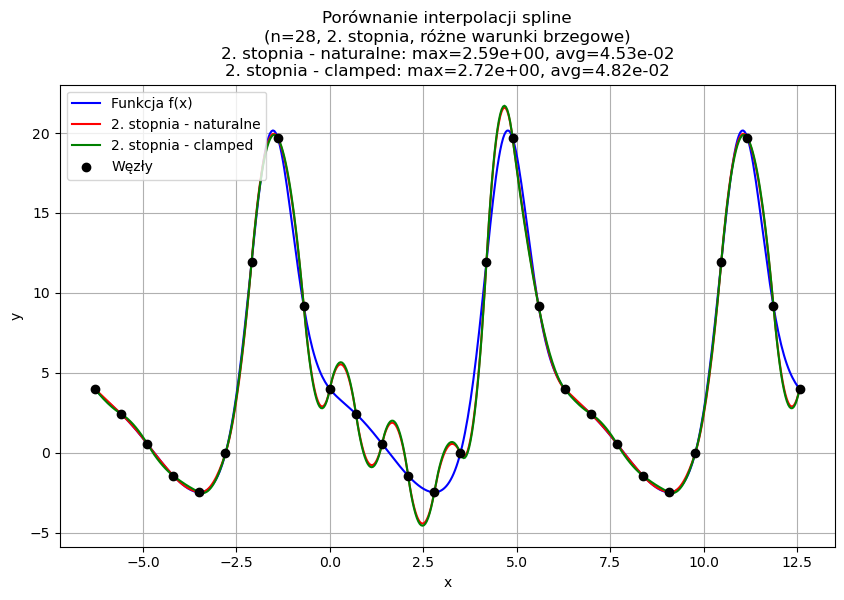

------------------
 Dla n = 28 węzłów
------------------

Cubic natural: błąd maksymalny = 7.839e-01, błąd średni = 1.177e-02
Cubic clamped: błąd maksymalny = 7.843e-01, błąd średni = 1.181e-02
Quadratic natural: błąd maksymalny = 2.590e+00, błąd średni = 4.535e-02
Quadratic clamped: błąd maksymalny = 2.724e+00, błąd średni = 4.820e-02
------------------
 Dla n = 29 węzłów
------------------



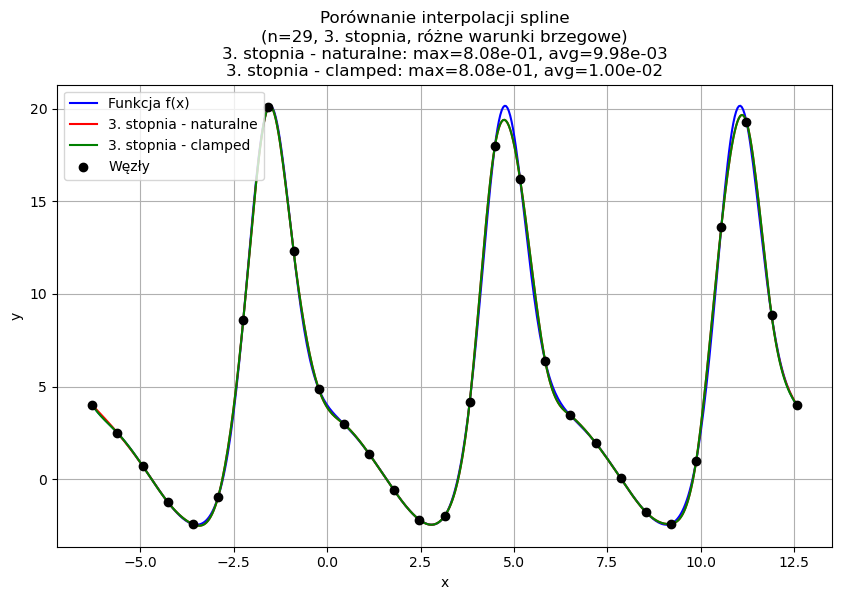

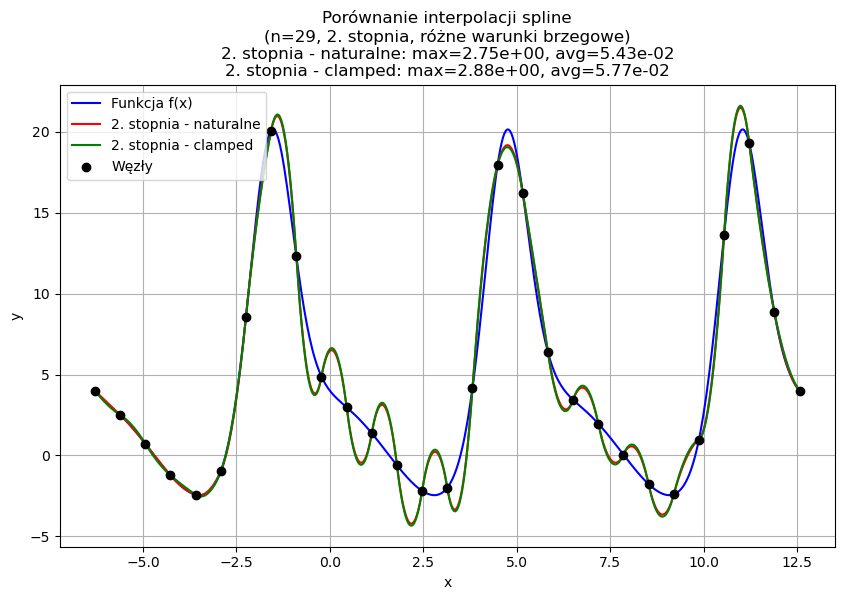

------------------
 Dla n = 29 węzłów
------------------

Cubic natural: błąd maksymalny = 8.081e-01, błąd średni = 9.983e-03
Cubic clamped: błąd maksymalny = 8.081e-01, błąd średni = 1.002e-02
Quadratic natural: błąd maksymalny = 2.754e+00, błąd średni = 5.429e-02
Quadratic clamped: błąd maksymalny = 2.884e+00, błąd średni = 5.772e-02
------------------
 Dla n = 30 węzłów
------------------



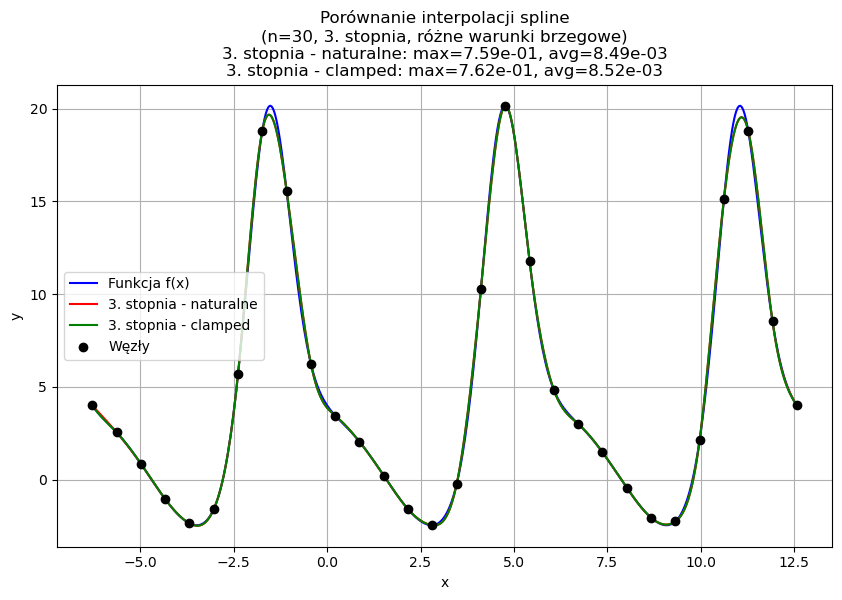

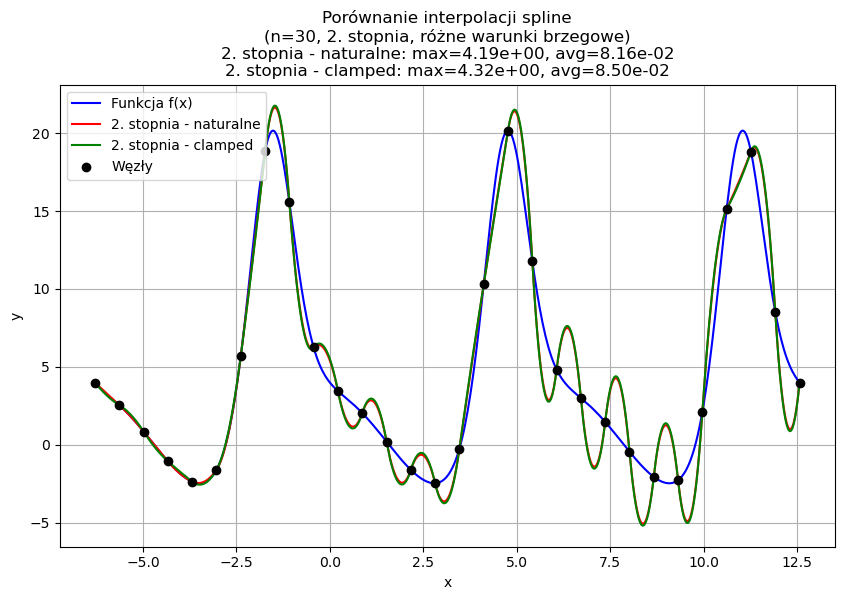

------------------
 Dla n = 30 węzłów
------------------

Cubic natural: błąd maksymalny = 7.592e-01, błąd średni = 8.487e-03
Cubic clamped: błąd maksymalny = 7.622e-01, błąd średni = 8.520e-03
Quadratic natural: błąd maksymalny = 4.190e+00, błąd średni = 8.157e-02
Quadratic clamped: błąd maksymalny = 4.315e+00, błąd średni = 8.495e-02
------------------
 Dla n = 31 węzłów
------------------



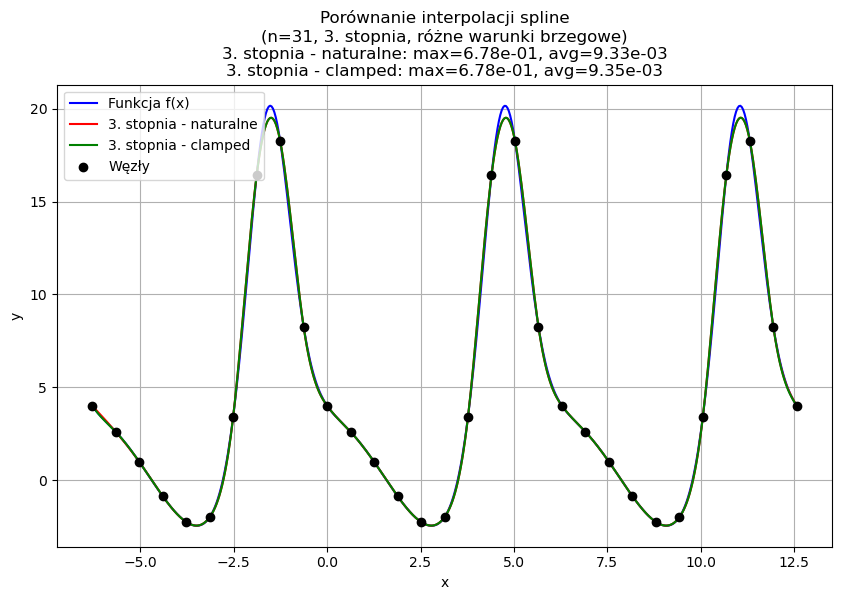

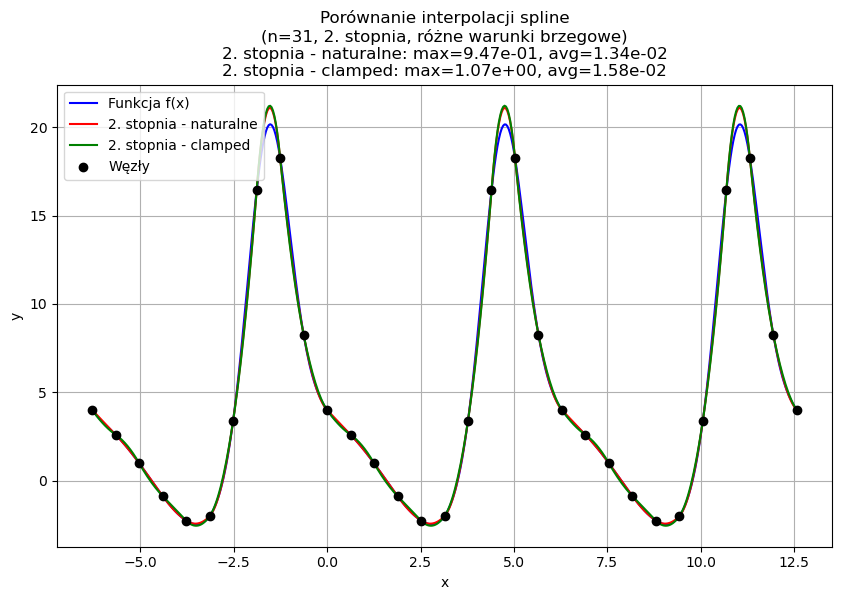

------------------
 Dla n = 31 węzłów
------------------

Cubic natural: błąd maksymalny = 6.782e-01, błąd średni = 9.332e-03
Cubic clamped: błąd maksymalny = 6.782e-01, błąd średni = 9.354e-03
Quadratic natural: błąd maksymalny = 9.469e-01, błąd średni = 1.343e-02
Quadratic clamped: błąd maksymalny = 1.068e+00, błąd średni = 1.576e-02
------------------
 Dla n = 32 węzłów
------------------



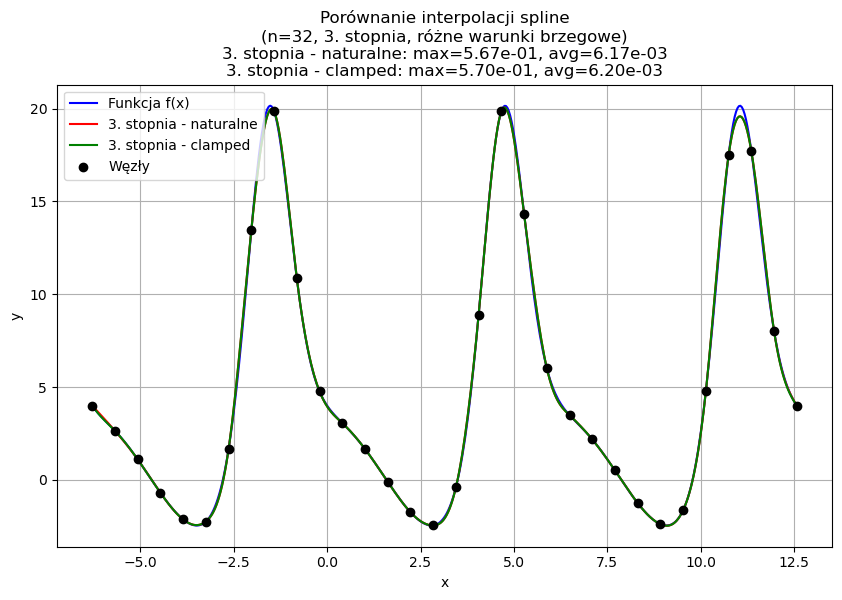

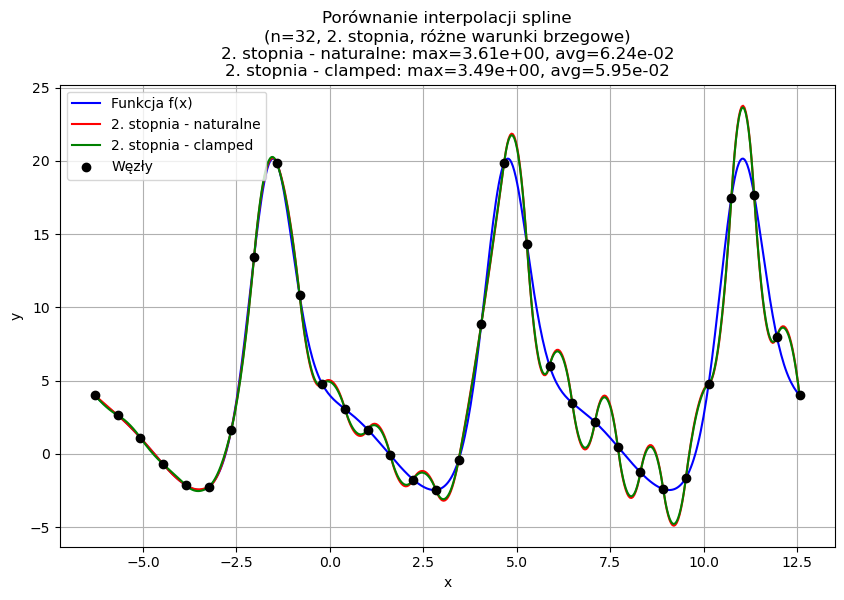

------------------
 Dla n = 32 węzłów
------------------

Cubic natural: błąd maksymalny = 5.671e-01, błąd średni = 6.174e-03
Cubic clamped: błąd maksymalny = 5.696e-01, błąd średni = 6.200e-03
Quadratic natural: błąd maksymalny = 3.608e+00, błąd średni = 6.244e-02
Quadratic clamped: błąd maksymalny = 3.491e+00, błąd średni = 5.954e-02
------------------
 Dla n = 33 węzłów
------------------



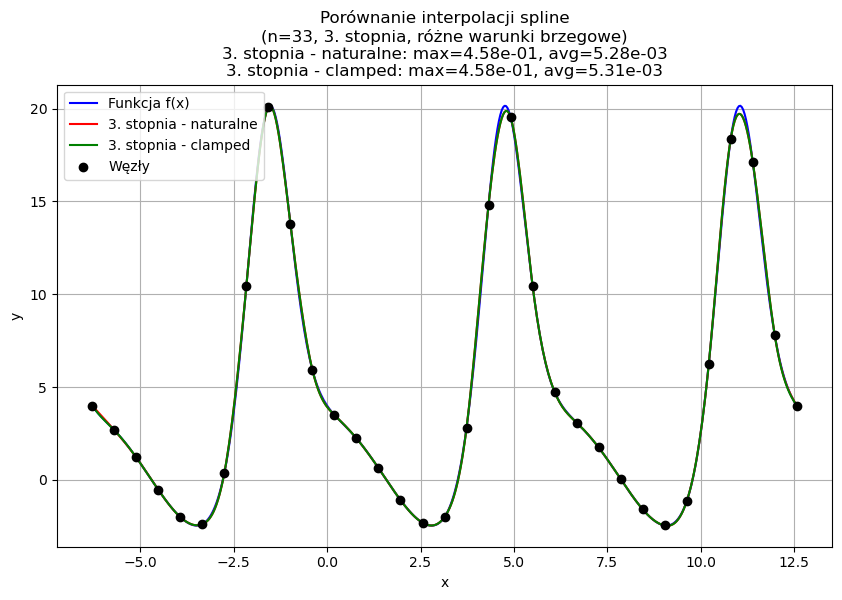

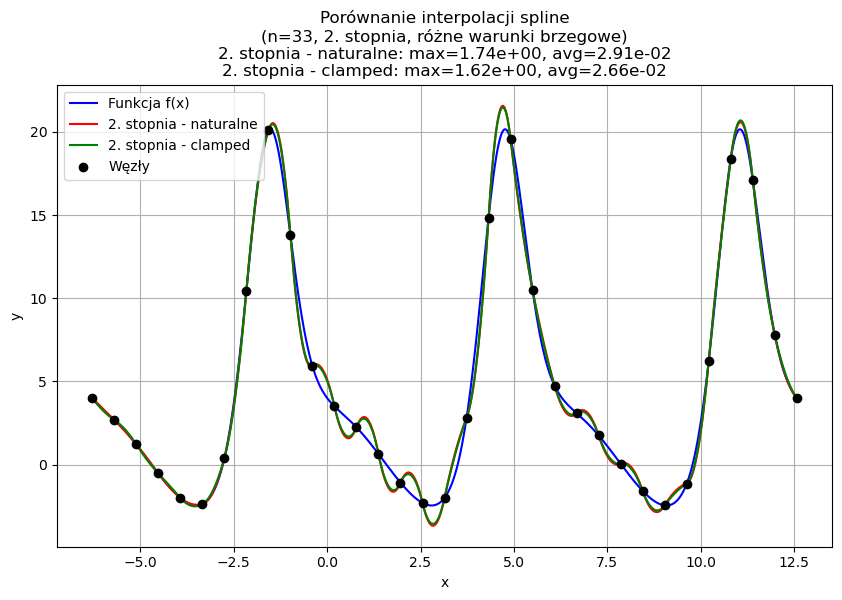

------------------
 Dla n = 33 węzłów
------------------

Cubic natural: błąd maksymalny = 4.579e-01, błąd średni = 5.285e-03
Cubic clamped: błąd maksymalny = 4.585e-01, błąd średni = 5.309e-03
Quadratic natural: błąd maksymalny = 1.736e+00, błąd średni = 2.905e-02
Quadratic clamped: błąd maksymalny = 1.624e+00, błąd średni = 2.656e-02
------------------
 Dla n = 34 węzłów
------------------



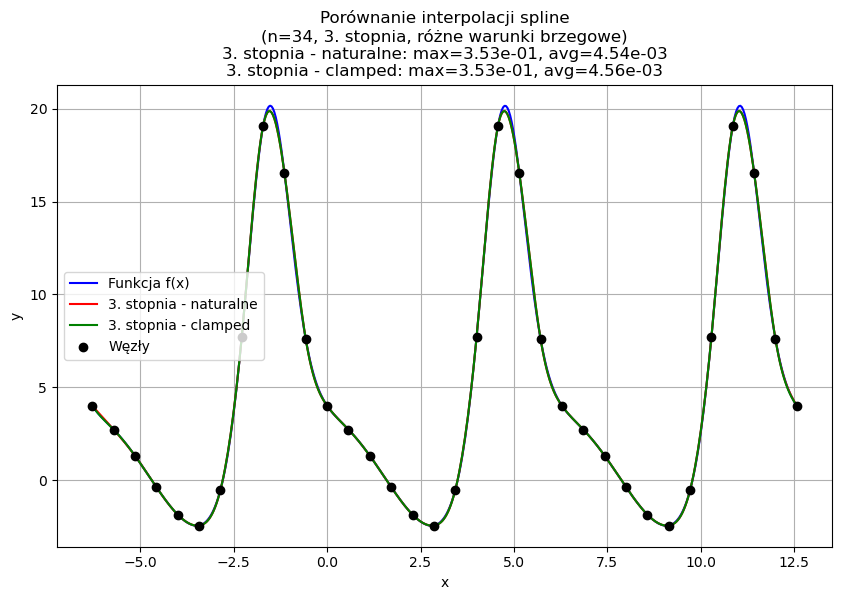

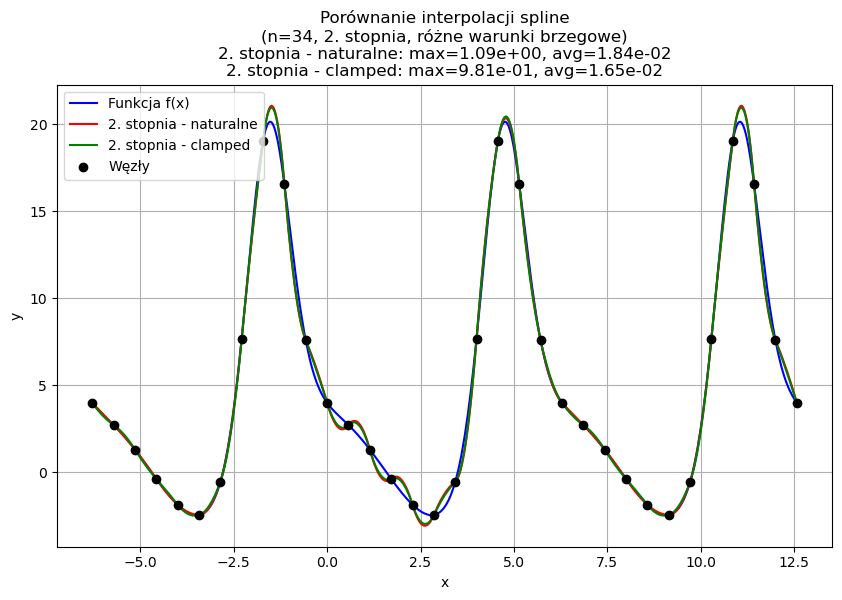

------------------
 Dla n = 34 węzłów
------------------

Cubic natural: błąd maksymalny = 3.531e-01, błąd średni = 4.537e-03
Cubic clamped: błąd maksymalny = 3.531e-01, błąd średni = 4.559e-03
Quadratic natural: błąd maksymalny = 1.086e+00, błąd średni = 1.844e-02
Quadratic clamped: błąd maksymalny = 9.807e-01, błąd średni = 1.646e-02
------------------
 Dla n = 35 węzłów
------------------



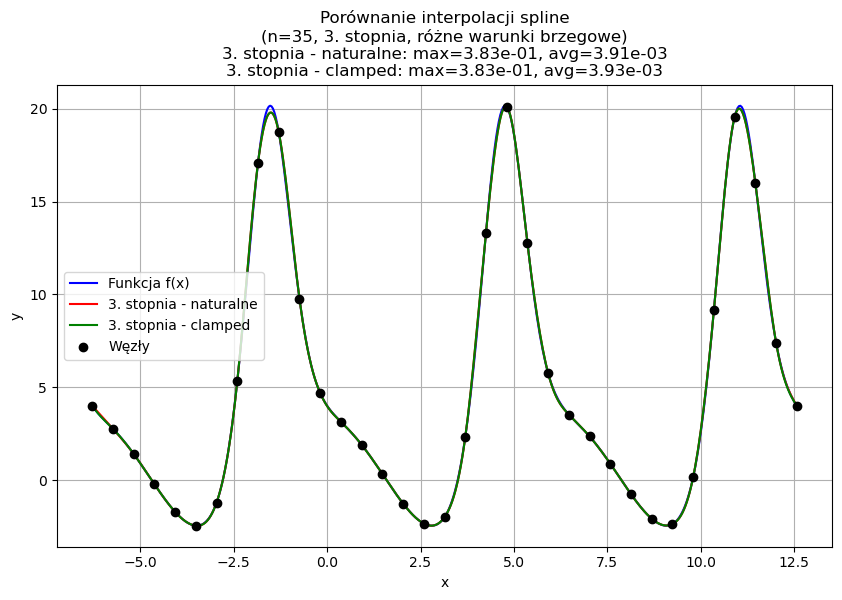

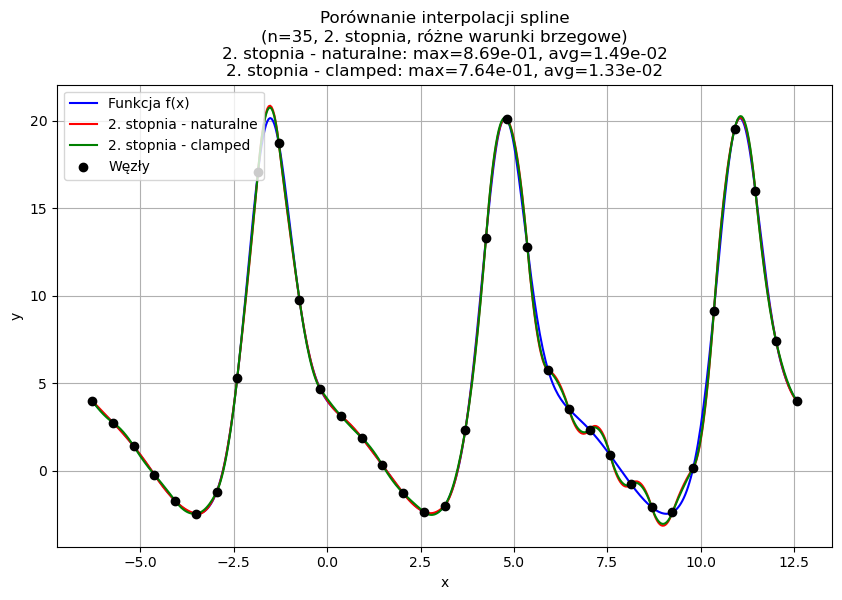

------------------
 Dla n = 35 węzłów
------------------

Cubic natural: błąd maksymalny = 3.834e-01, błąd średni = 3.907e-03
Cubic clamped: błąd maksymalny = 3.834e-01, błąd średni = 3.925e-03
Quadratic natural: błąd maksymalny = 8.691e-01, błąd średni = 1.491e-02
Quadratic clamped: błąd maksymalny = 7.641e-01, błąd średni = 1.326e-02
------------------
 Dla n = 36 węzłów
------------------



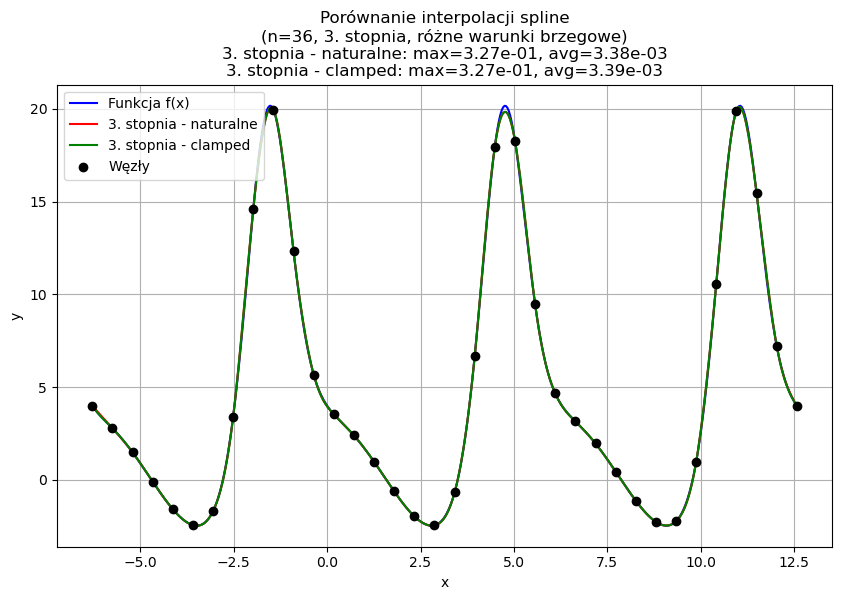

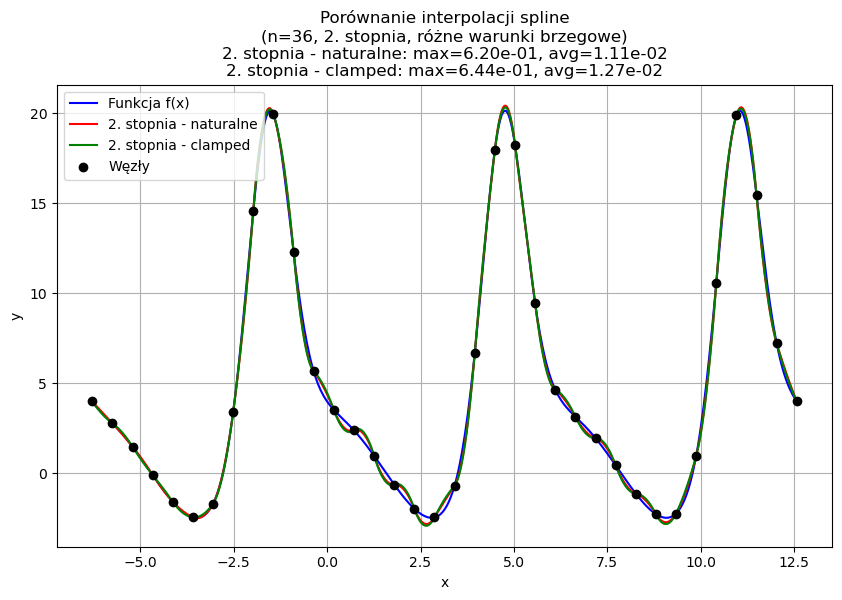

------------------
 Dla n = 36 węzłów
------------------

Cubic natural: błąd maksymalny = 3.269e-01, błąd średni = 3.376e-03
Cubic clamped: błąd maksymalny = 3.269e-01, błąd średni = 3.390e-03
Quadratic natural: błąd maksymalny = 6.204e-01, błąd średni = 1.107e-02
Quadratic clamped: błąd maksymalny = 6.441e-01, błąd średni = 1.268e-02
------------------
 Dla n = 37 węzłów
------------------



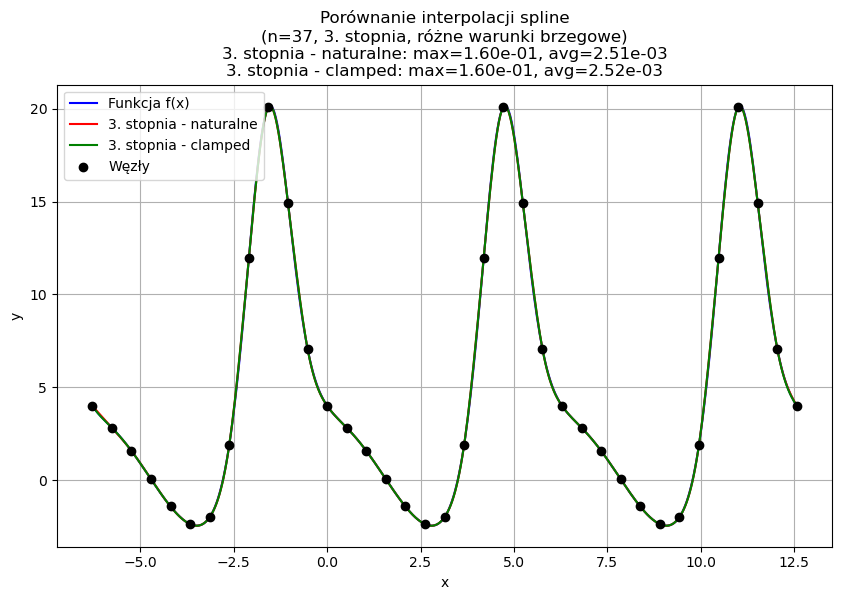

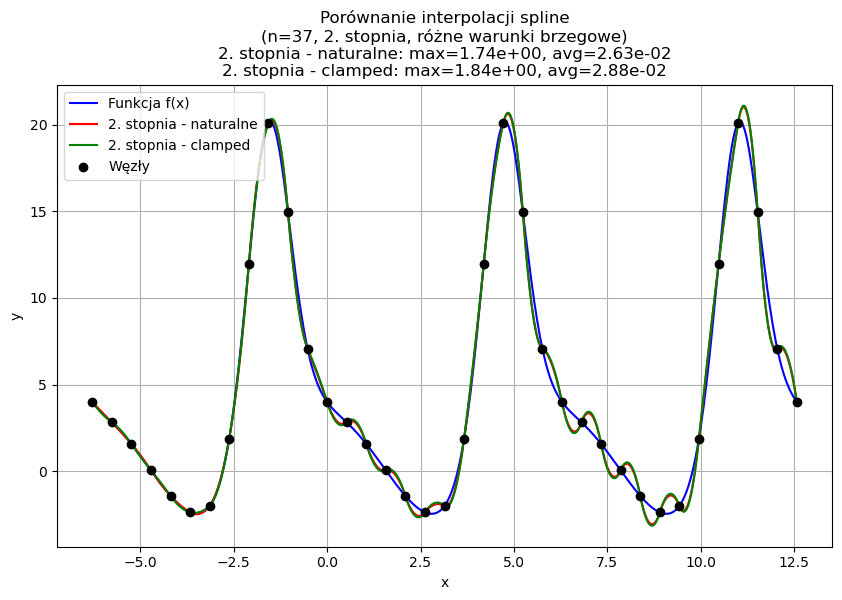

------------------
 Dla n = 37 węzłów
------------------

Cubic natural: błąd maksymalny = 1.600e-01, błąd średni = 2.507e-03
Cubic clamped: błąd maksymalny = 1.598e-01, błąd średni = 2.515e-03
Quadratic natural: błąd maksymalny = 1.738e+00, błąd średni = 2.631e-02
Quadratic clamped: błąd maksymalny = 1.836e+00, błąd średni = 2.884e-02
------------------
 Dla n = 38 węzłów
------------------



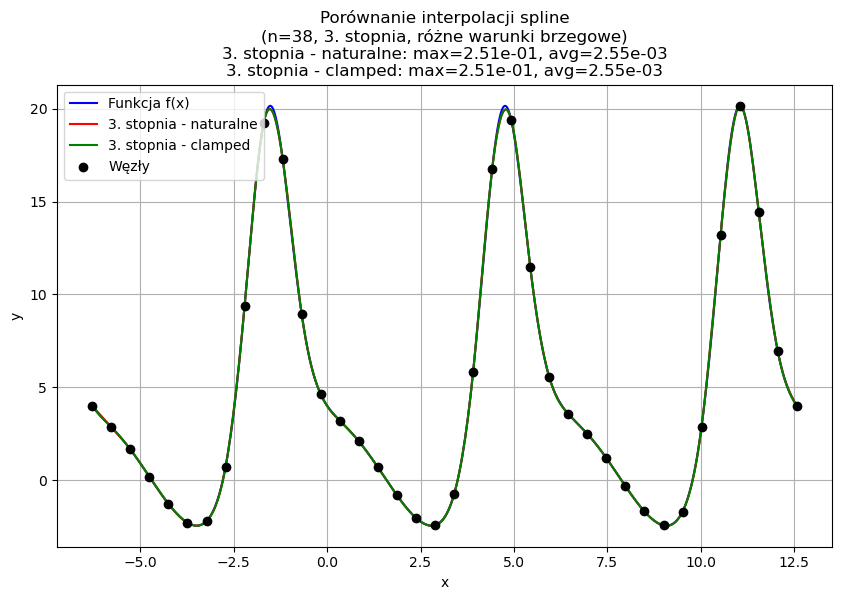

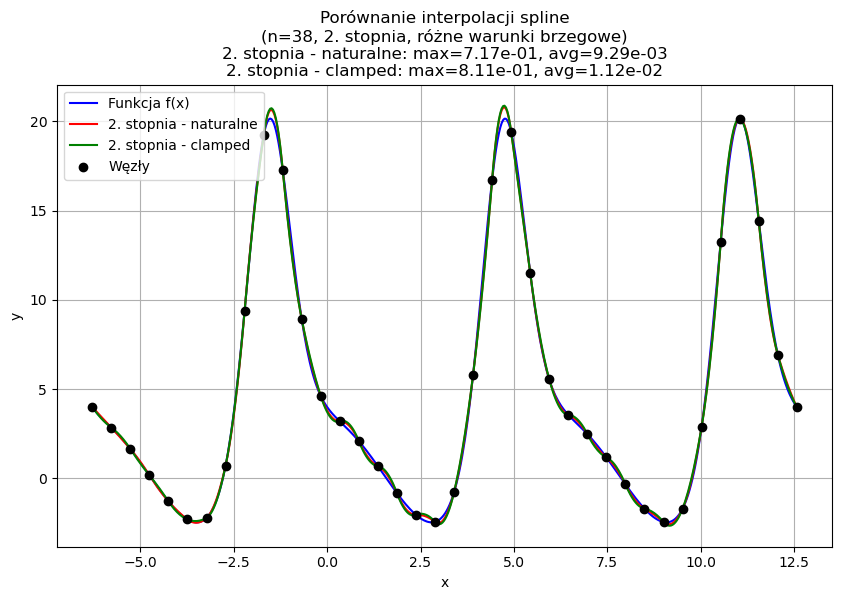

------------------
 Dla n = 38 węzłów
------------------

Cubic natural: błąd maksymalny = 2.513e-01, błąd średni = 2.549e-03
Cubic clamped: błąd maksymalny = 2.513e-01, błąd średni = 2.550e-03
Quadratic natural: błąd maksymalny = 7.166e-01, błąd średni = 9.288e-03
Quadratic clamped: błąd maksymalny = 8.113e-01, błąd średni = 1.125e-02
------------------
 Dla n = 39 węzłów
------------------



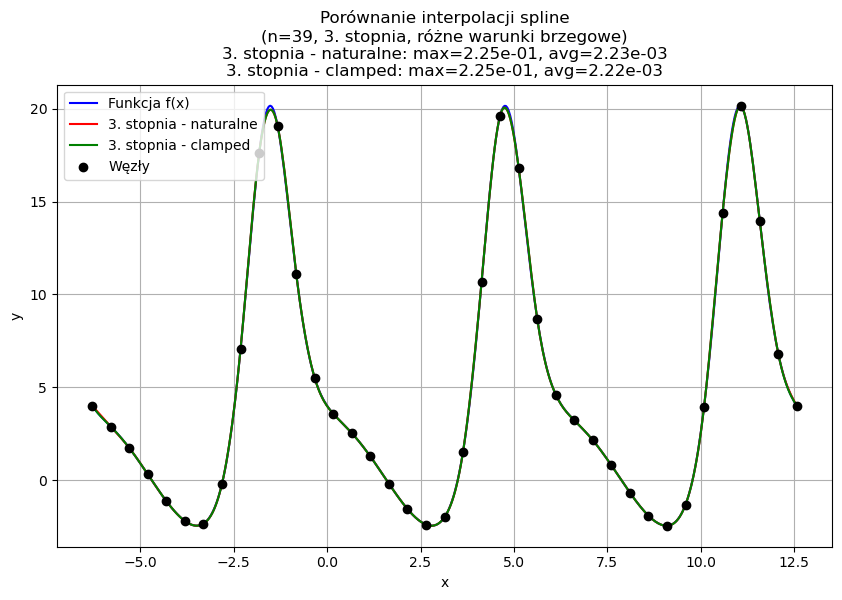

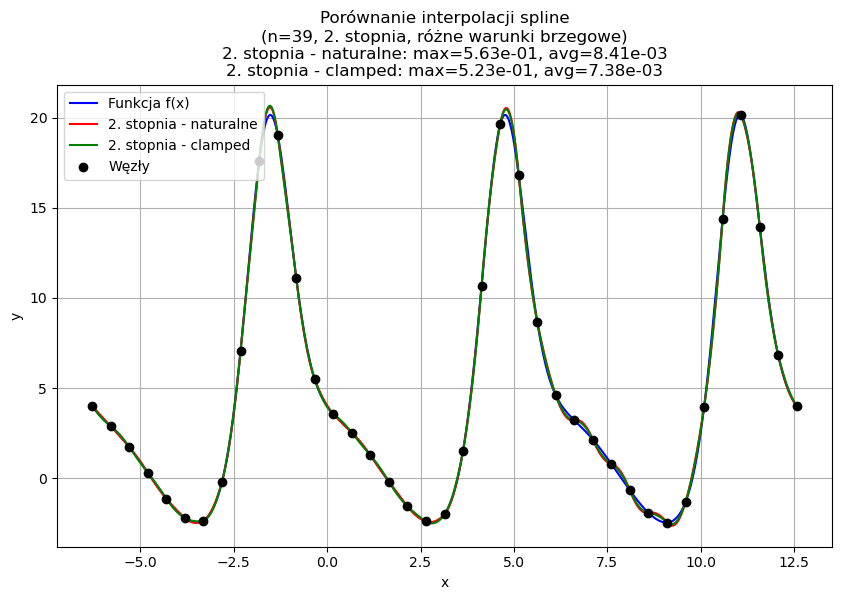

------------------
 Dla n = 39 węzłów
------------------

Cubic natural: błąd maksymalny = 2.247e-01, błąd średni = 2.227e-03
Cubic clamped: błąd maksymalny = 2.247e-01, błąd średni = 2.221e-03
Quadratic natural: błąd maksymalny = 5.631e-01, błąd średni = 8.413e-03
Quadratic clamped: błąd maksymalny = 5.231e-01, błąd średni = 7.379e-03
------------------
 Dla n = 40 węzłów
------------------



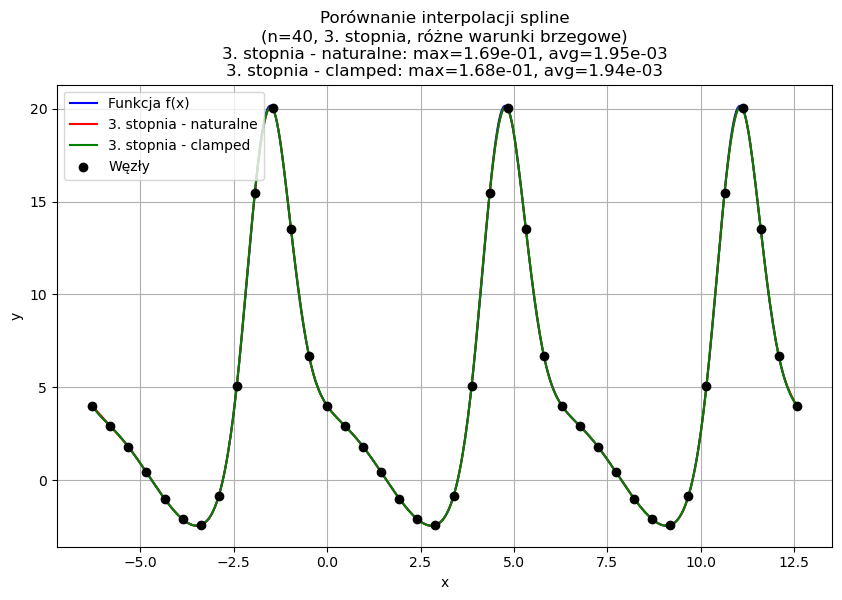

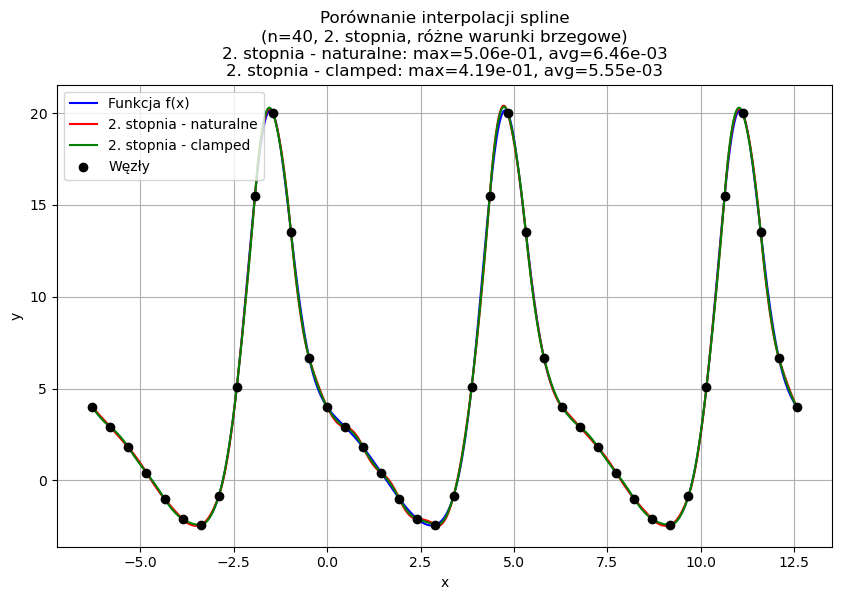

------------------
 Dla n = 40 węzłów
------------------

Cubic natural: błąd maksymalny = 1.687e-01, błąd średni = 1.953e-03
Cubic clamped: błąd maksymalny = 1.678e-01, błąd średni = 1.941e-03
Quadratic natural: błąd maksymalny = 5.062e-01, błąd średni = 6.457e-03
Quadratic clamped: błąd maksymalny = 4.193e-01, błąd średni = 5.552e-03
------------------
 Dla n = 41 węzłów
------------------



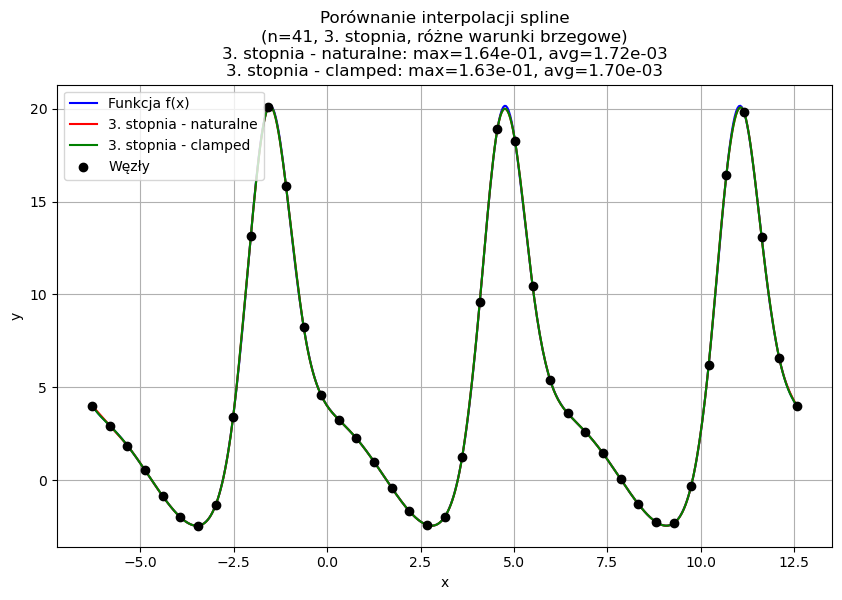

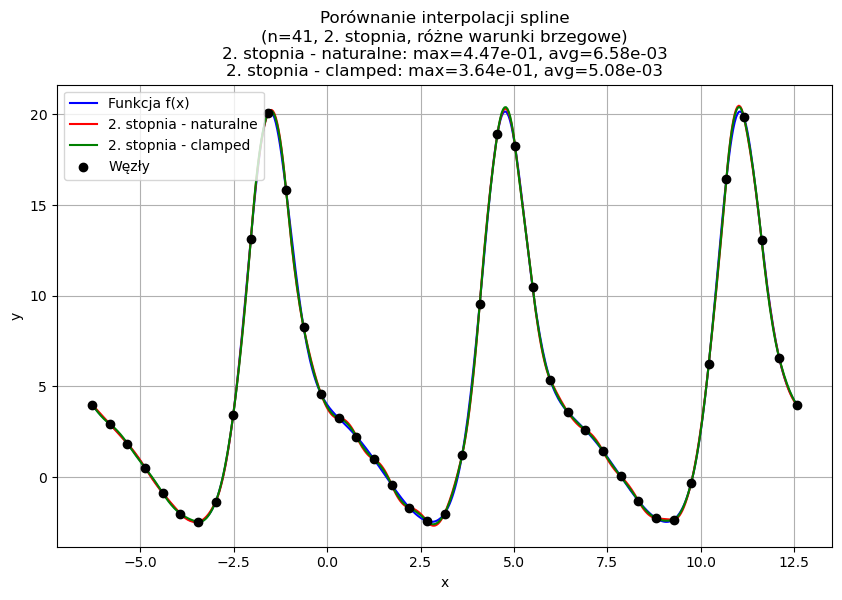

------------------
 Dla n = 41 węzłów
------------------

Cubic natural: błąd maksymalny = 1.639e-01, błąd średni = 1.719e-03
Cubic clamped: błąd maksymalny = 1.631e-01, błąd średni = 1.701e-03
Quadratic natural: błąd maksymalny = 4.467e-01, błąd średni = 6.581e-03
Quadratic clamped: błąd maksymalny = 3.642e-01, błąd średni = 5.085e-03
------------------
 Dla n = 42 węzłów
------------------



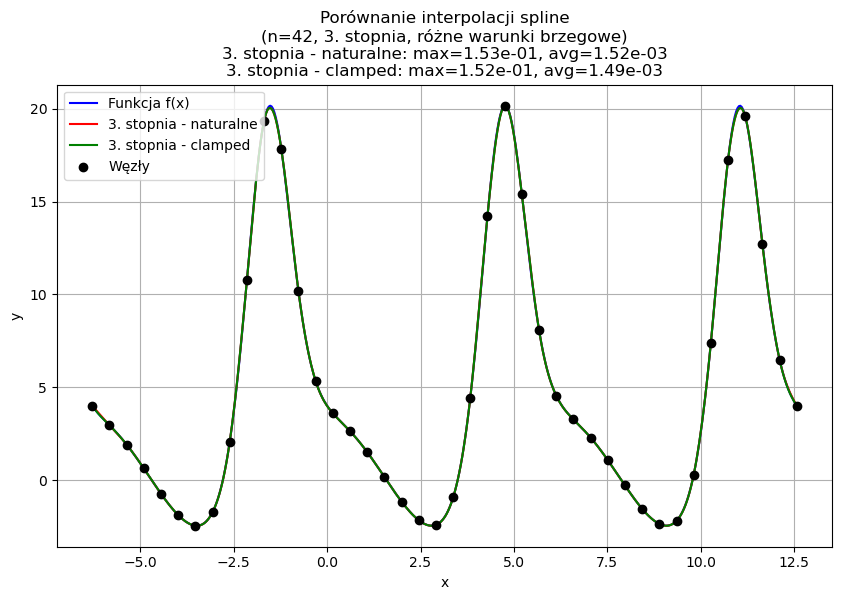

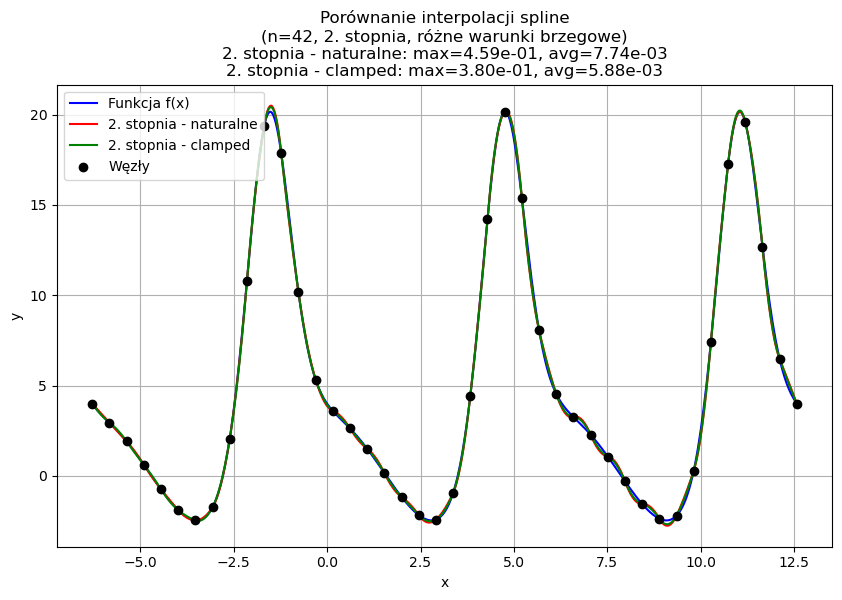

------------------
 Dla n = 42 węzłów
------------------

Cubic natural: błąd maksymalny = 1.525e-01, błąd średni = 1.518e-03
Cubic clamped: błąd maksymalny = 1.517e-01, błąd średni = 1.495e-03
Quadratic natural: błąd maksymalny = 4.586e-01, błąd średni = 7.740e-03
Quadratic clamped: błąd maksymalny = 3.797e-01, błąd średni = 5.876e-03
------------------
 Dla n = 43 węzłów
------------------



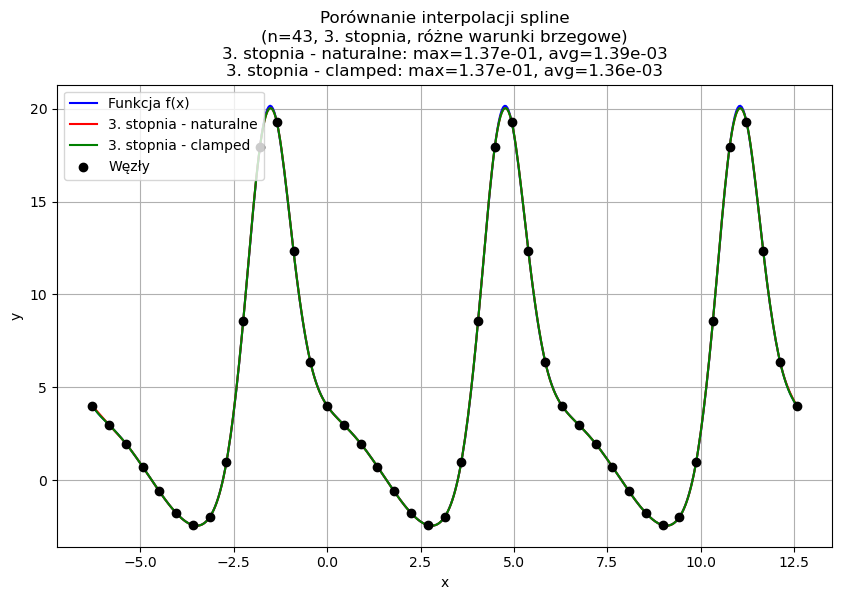

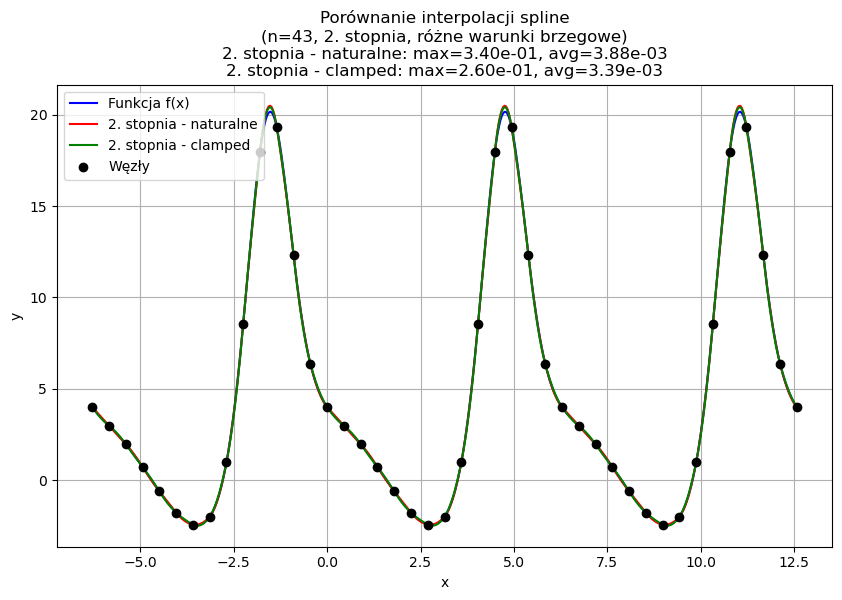

------------------
 Dla n = 43 węzłów
------------------

Cubic natural: błąd maksymalny = 1.373e-01, błąd średni = 1.386e-03
Cubic clamped: błąd maksymalny = 1.373e-01, błąd średni = 1.359e-03
Quadratic natural: błąd maksymalny = 3.405e-01, błąd średni = 3.881e-03
Quadratic clamped: błąd maksymalny = 2.601e-01, błąd średni = 3.387e-03
------------------
 Dla n = 44 węzłów
------------------



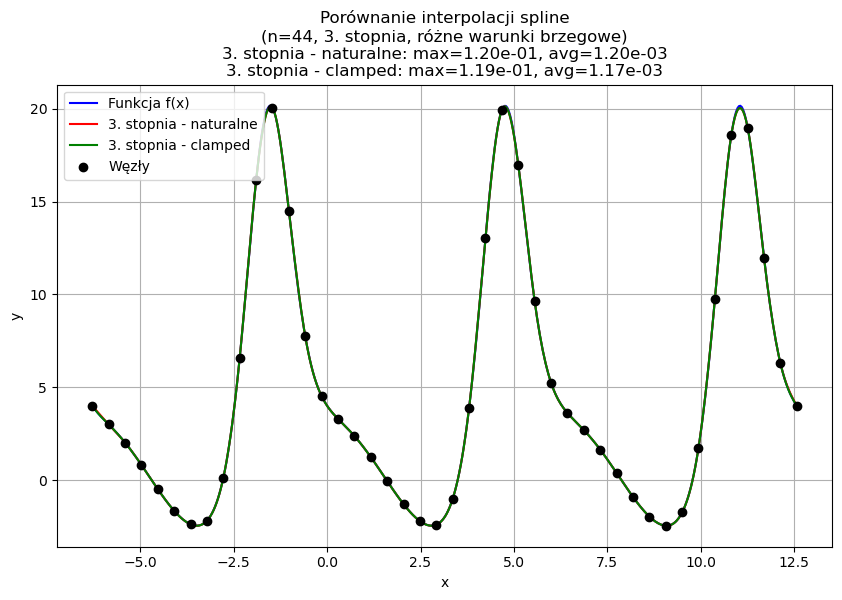

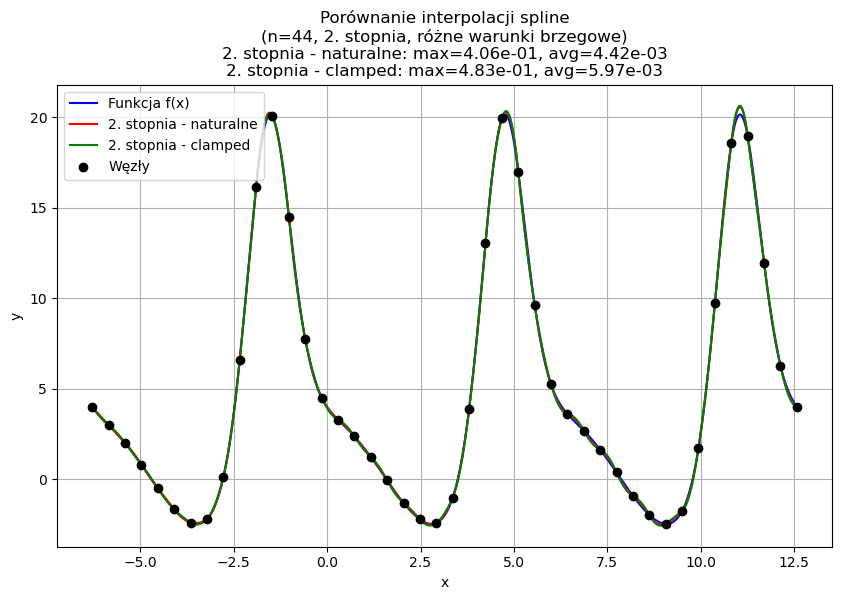

------------------
 Dla n = 44 węzłów
------------------

Cubic natural: błąd maksymalny = 1.201e-01, błąd średni = 1.197e-03
Cubic clamped: błąd maksymalny = 1.193e-01, błąd średni = 1.166e-03
Quadratic natural: błąd maksymalny = 4.060e-01, błąd średni = 4.419e-03
Quadratic clamped: błąd maksymalny = 4.830e-01, błąd średni = 5.971e-03
------------------
 Dla n = 45 węzłów
------------------



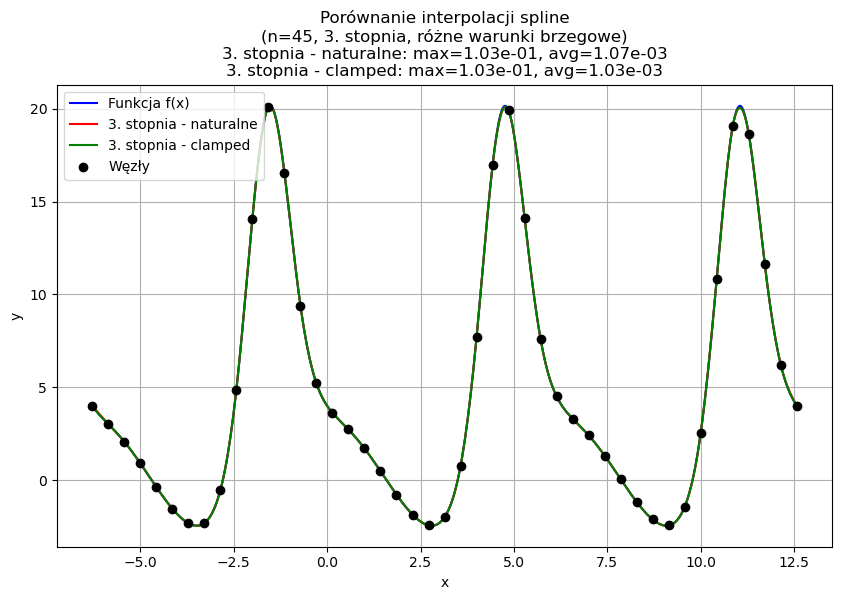

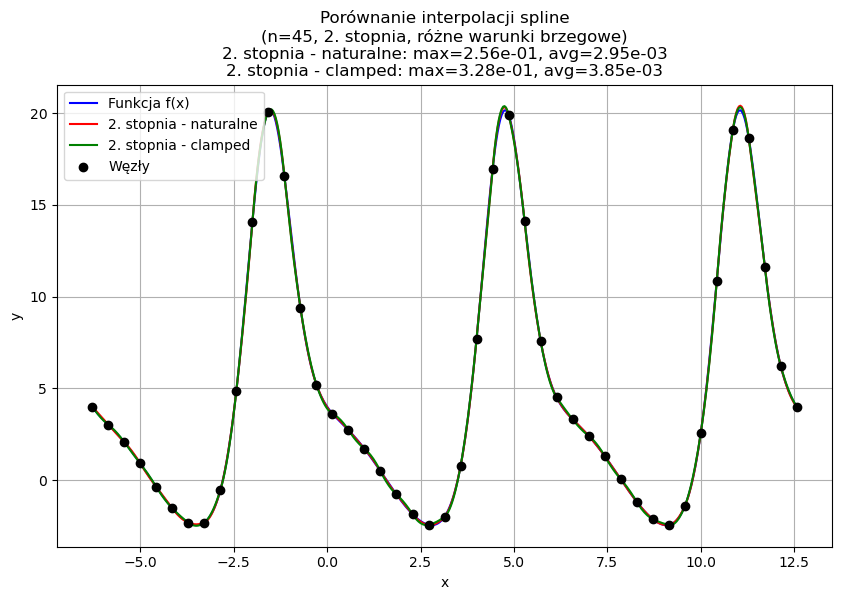

------------------
 Dla n = 45 węzłów
------------------

Cubic natural: błąd maksymalny = 1.028e-01, błąd średni = 1.069e-03
Cubic clamped: błąd maksymalny = 1.028e-01, błąd średni = 1.034e-03
Quadratic natural: błąd maksymalny = 2.560e-01, błąd średni = 2.955e-03
Quadratic clamped: błąd maksymalny = 3.282e-01, błąd średni = 3.849e-03
------------------
 Dla n = 46 węzłów
------------------



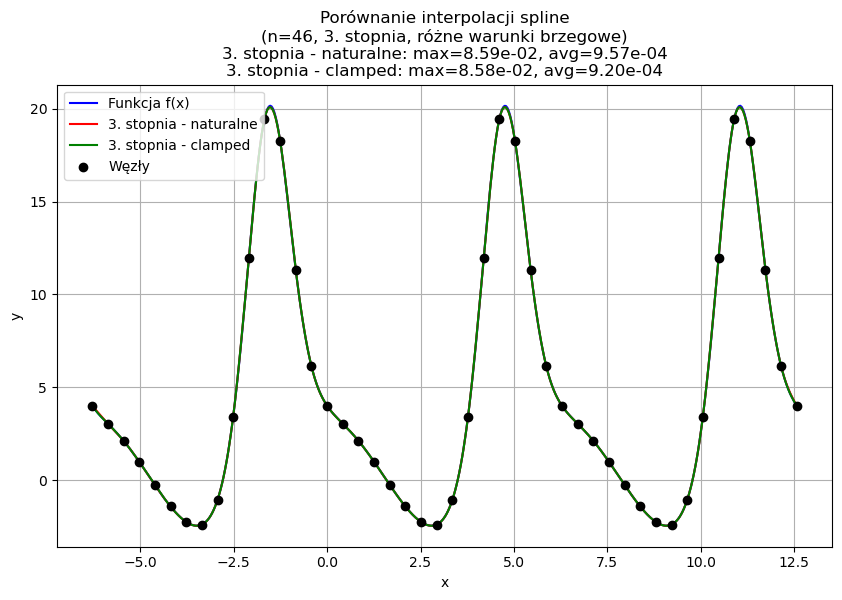

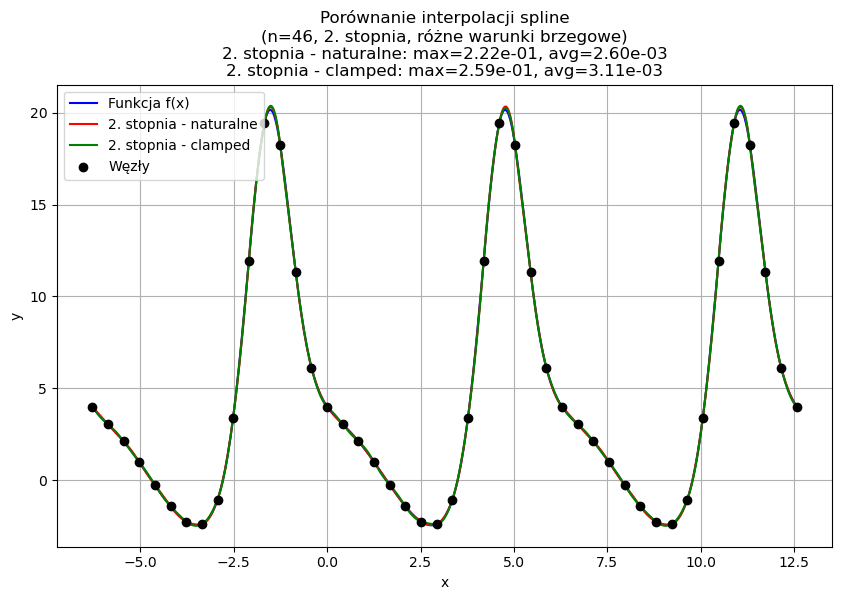

------------------
 Dla n = 46 węzłów
------------------

Cubic natural: błąd maksymalny = 8.594e-02, błąd średni = 9.574e-04
Cubic clamped: błąd maksymalny = 8.584e-02, błąd średni = 9.199e-04
Quadratic natural: błąd maksymalny = 2.216e-01, błąd średni = 2.604e-03
Quadratic clamped: błąd maksymalny = 2.589e-01, błąd średni = 3.111e-03
------------------
 Dla n = 47 węzłów
------------------



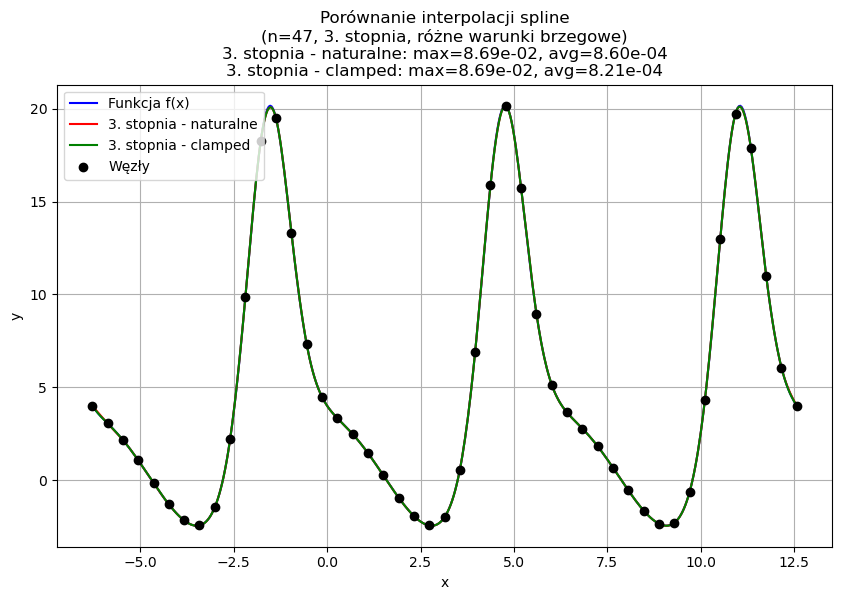

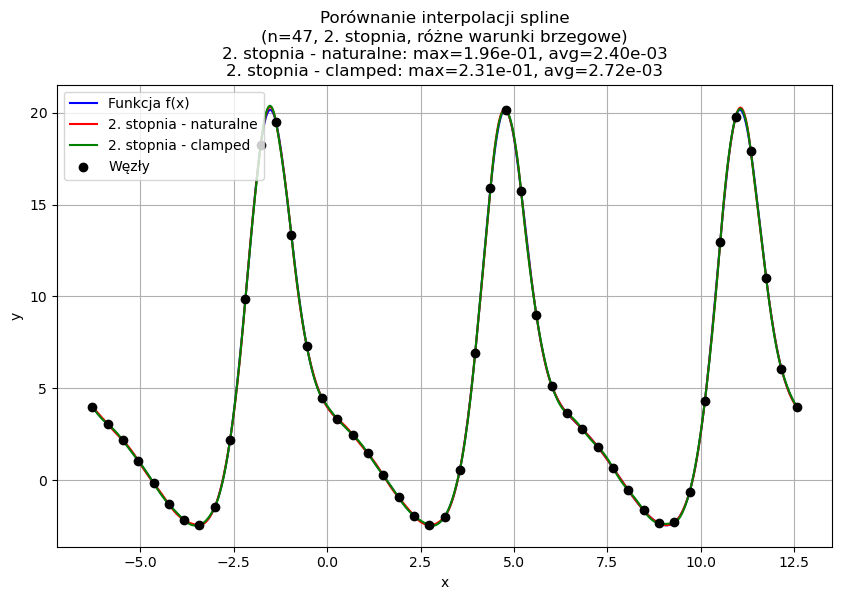

------------------
 Dla n = 47 węzłów
------------------

Cubic natural: błąd maksymalny = 8.690e-02, błąd średni = 8.605e-04
Cubic clamped: błąd maksymalny = 8.690e-02, błąd średni = 8.208e-04
Quadratic natural: błąd maksymalny = 1.955e-01, błąd średni = 2.401e-03
Quadratic clamped: błąd maksymalny = 2.309e-01, błąd średni = 2.721e-03
------------------
 Dla n = 48 węzłów
------------------



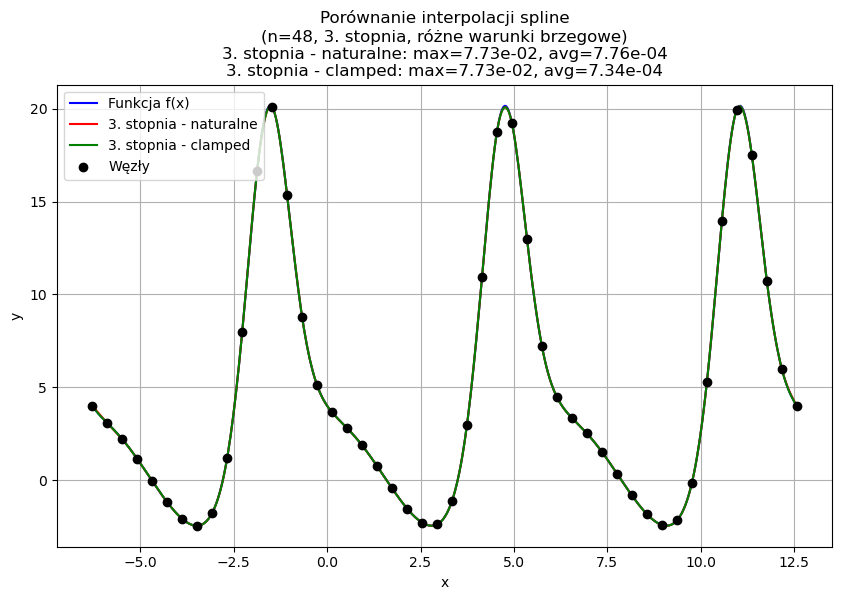

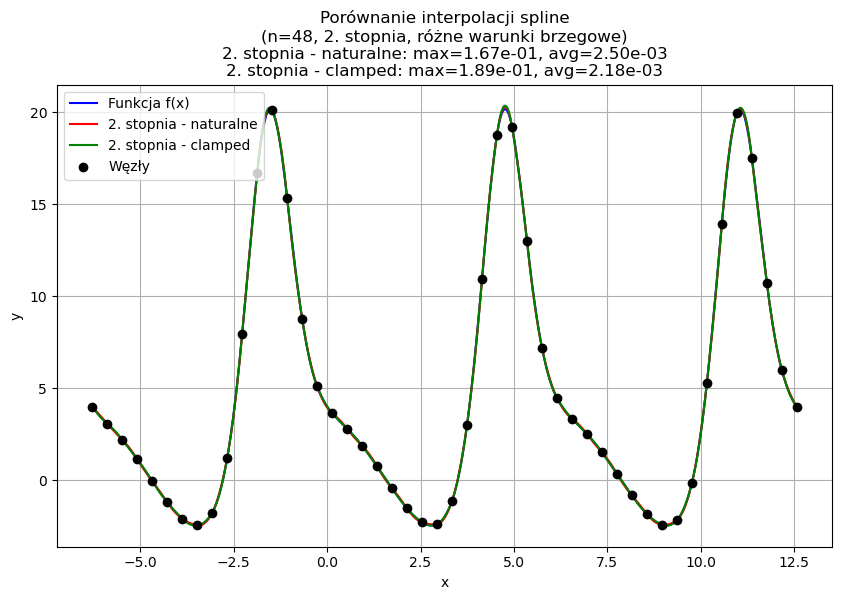

------------------
 Dla n = 48 węzłów
------------------

Cubic natural: błąd maksymalny = 7.734e-02, błąd średni = 7.760e-04
Cubic clamped: błąd maksymalny = 7.734e-02, błąd średni = 7.345e-04
Quadratic natural: błąd maksymalny = 1.666e-01, błąd średni = 2.502e-03
Quadratic clamped: błąd maksymalny = 1.886e-01, błąd średni = 2.184e-03
------------------
 Dla n = 49 węzłów
------------------



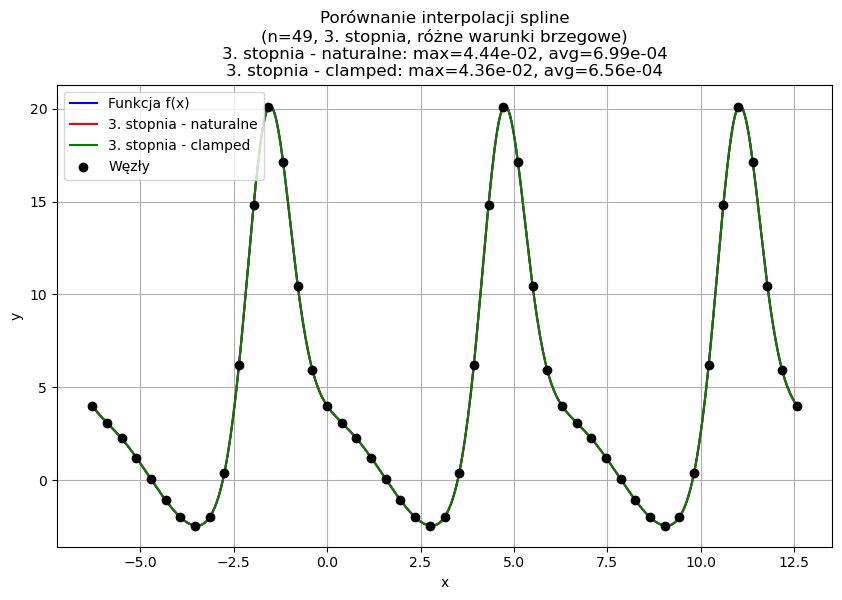

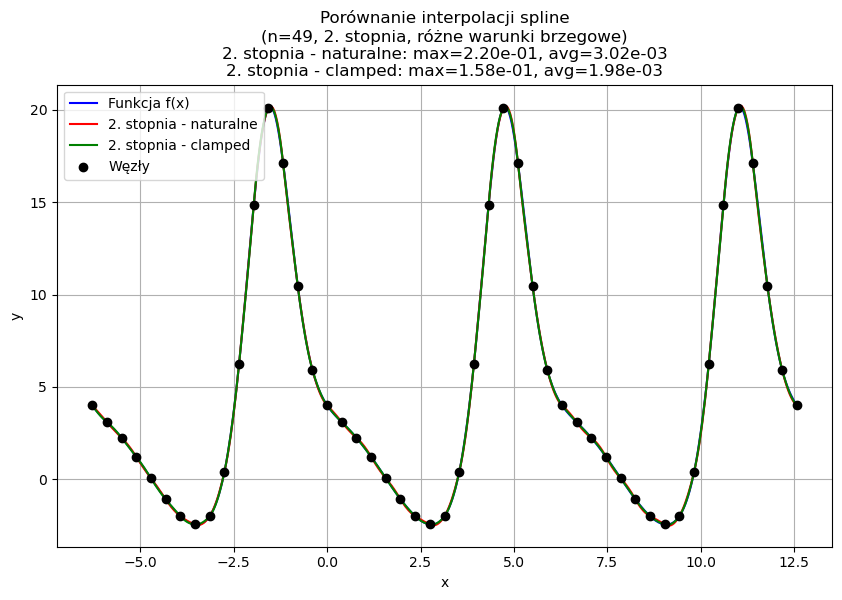

------------------
 Dla n = 49 węzłów
------------------

Cubic natural: błąd maksymalny = 4.436e-02, błąd średni = 6.991e-04
Cubic clamped: błąd maksymalny = 4.363e-02, błąd średni = 6.560e-04
Quadratic natural: błąd maksymalny = 2.204e-01, błąd średni = 3.016e-03
Quadratic clamped: błąd maksymalny = 1.584e-01, błąd średni = 1.983e-03
------------------
 Dla n = 50 węzłów
------------------



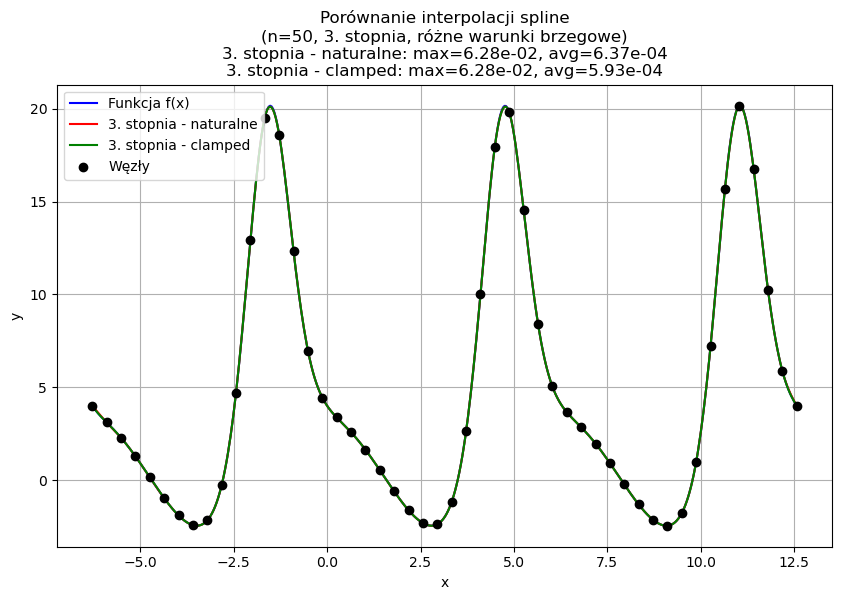

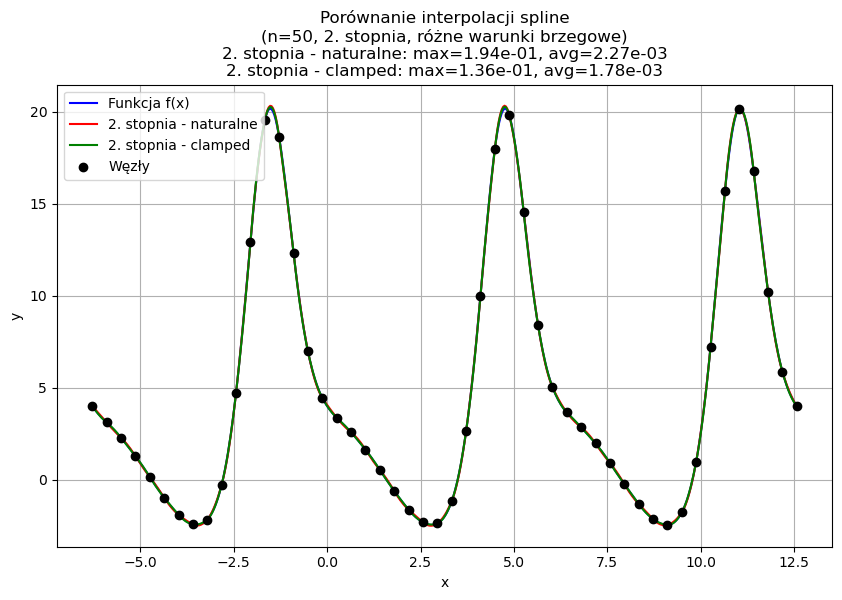

------------------
 Dla n = 50 węzłów
------------------

Cubic natural: błąd maksymalny = 6.278e-02, błąd średni = 6.372e-04
Cubic clamped: błąd maksymalny = 6.278e-02, błąd średni = 5.930e-04
Quadratic natural: błąd maksymalny = 1.936e-01, błąd średni = 2.273e-03
Quadratic clamped: błąd maksymalny = 1.357e-01, błąd średni = 1.784e-03
------------------
 Dla n = 51 węzłów
------------------



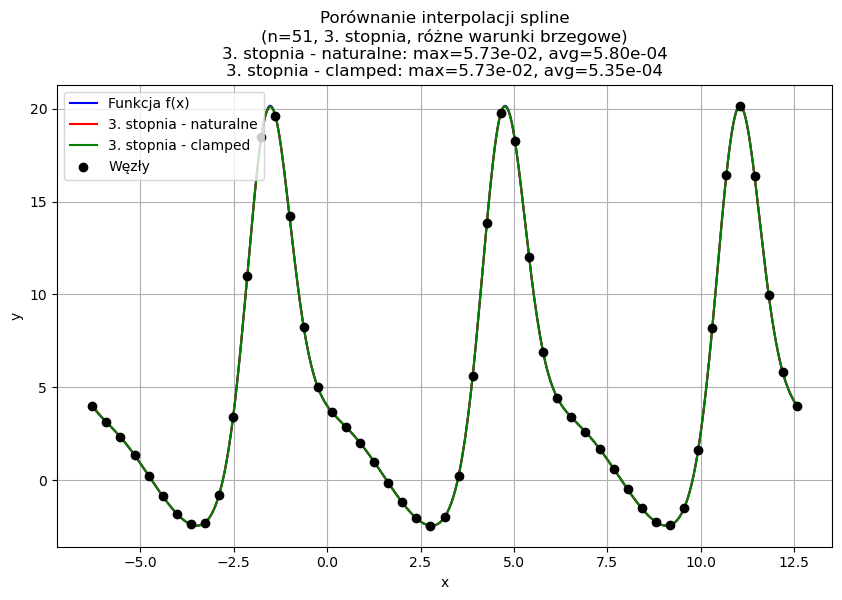

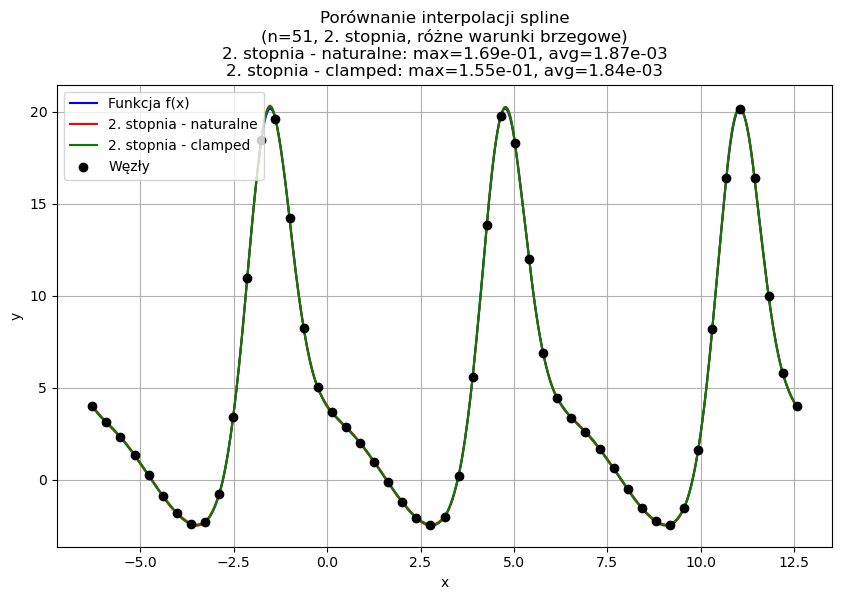

------------------
 Dla n = 51 węzłów
------------------

Cubic natural: błąd maksymalny = 5.730e-02, błąd średni = 5.801e-04
Cubic clamped: błąd maksymalny = 5.730e-02, błąd średni = 5.349e-04
Quadratic natural: błąd maksymalny = 1.686e-01, błąd średni = 1.873e-03
Quadratic clamped: błąd maksymalny = 1.545e-01, błąd średni = 1.841e-03
------------------
 Dla n = 52 węzłów
------------------



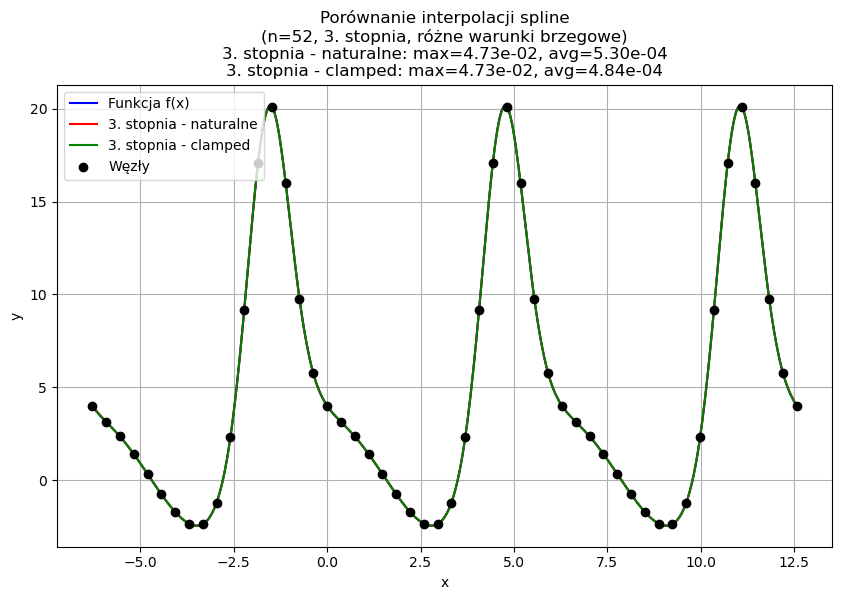

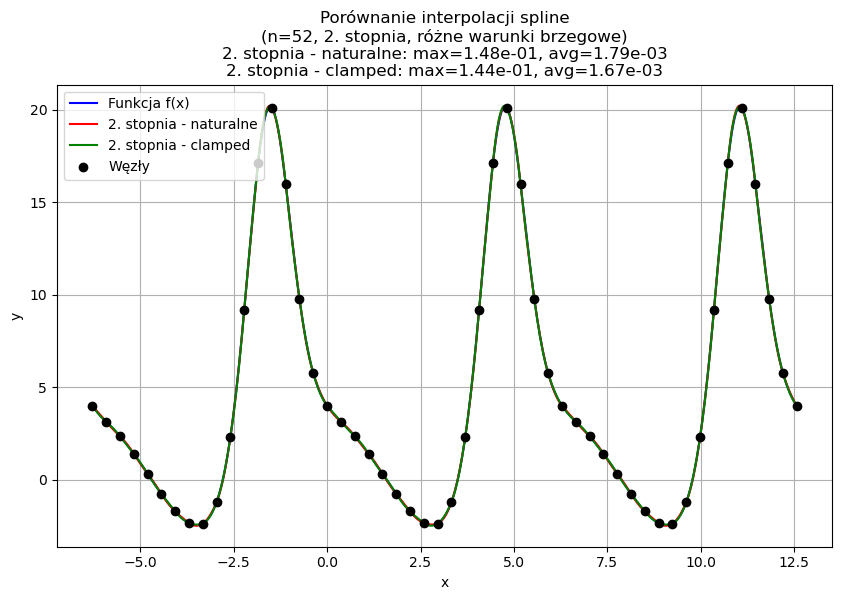

------------------
 Dla n = 52 węzłów
------------------

Cubic natural: błąd maksymalny = 4.735e-02, błąd średni = 5.298e-04
Cubic clamped: błąd maksymalny = 4.735e-02, błąd średni = 4.838e-04
Quadratic natural: błąd maksymalny = 1.483e-01, błąd średni = 1.790e-03
Quadratic clamped: błąd maksymalny = 1.438e-01, błąd średni = 1.669e-03
------------------
 Dla n = 53 węzłów
------------------



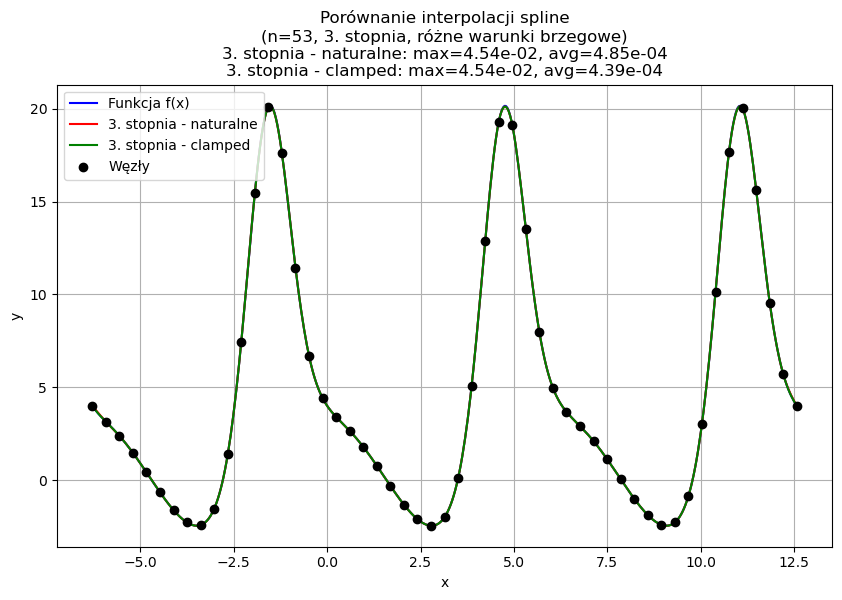

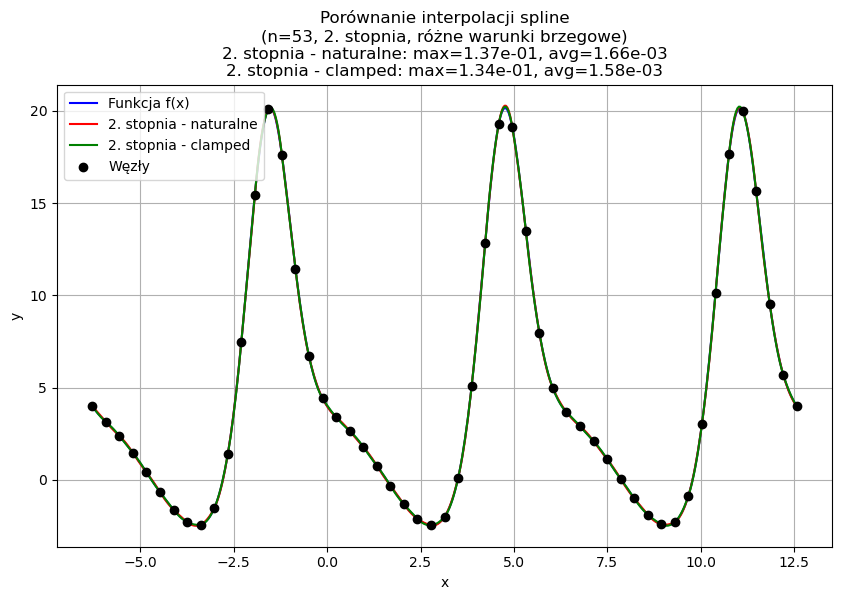

------------------
 Dla n = 53 węzłów
------------------

Cubic natural: błąd maksymalny = 4.540e-02, błąd średni = 4.852e-04
Cubic clamped: błąd maksymalny = 4.540e-02, błąd średni = 4.386e-04
Quadratic natural: błąd maksymalny = 1.366e-01, błąd średni = 1.660e-03
Quadratic clamped: błąd maksymalny = 1.340e-01, błąd średni = 1.581e-03
------------------
 Dla n = 54 węzłów
------------------



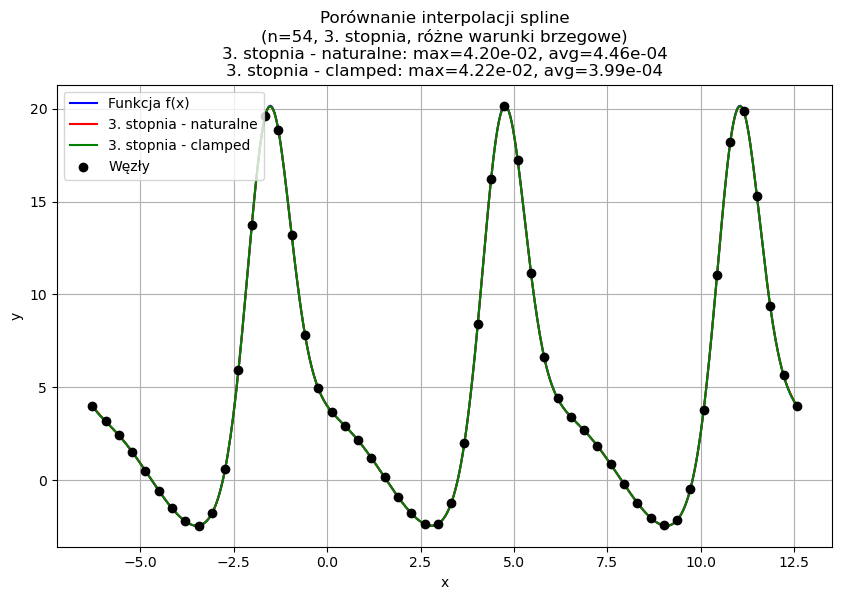

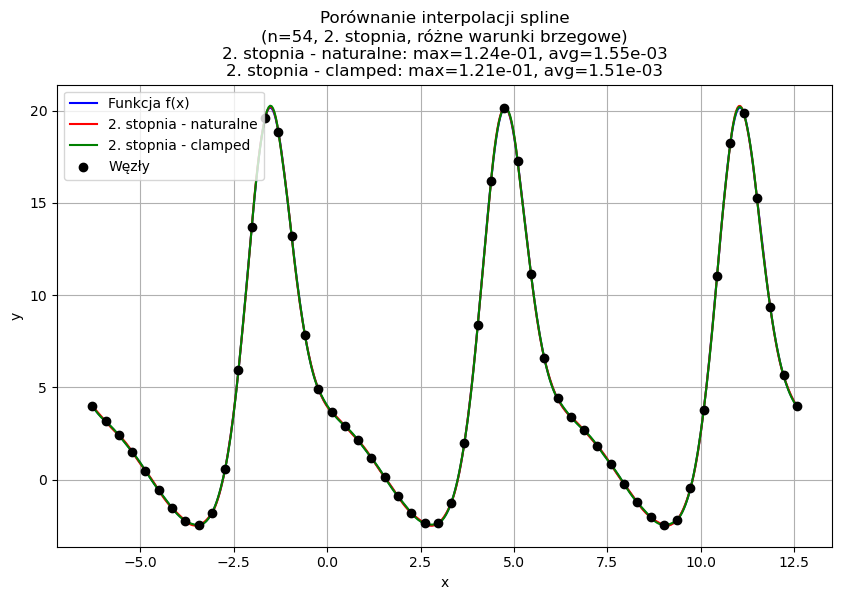

------------------
 Dla n = 54 węzłów
------------------

Cubic natural: błąd maksymalny = 4.199e-02, błąd średni = 4.458e-04
Cubic clamped: błąd maksymalny = 4.216e-02, błąd średni = 3.986e-04
Quadratic natural: błąd maksymalny = 1.239e-01, błąd średni = 1.548e-03
Quadratic clamped: błąd maksymalny = 1.210e-01, błąd średni = 1.506e-03
------------------
 Dla n = 55 węzłów
------------------



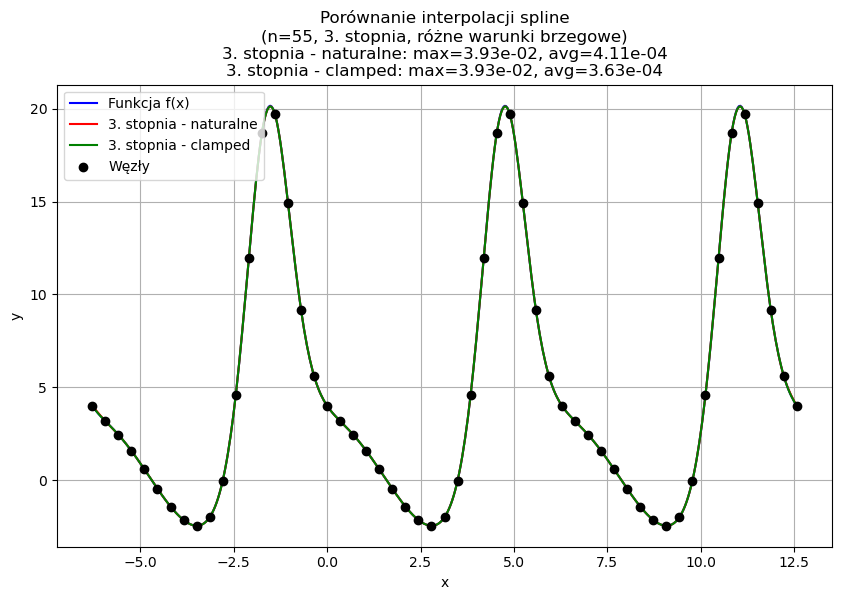

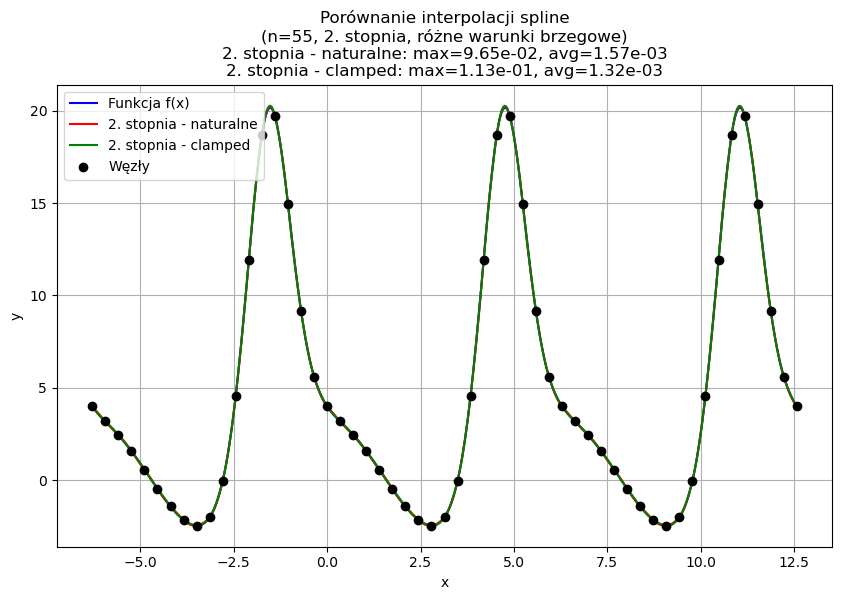

------------------
 Dla n = 55 węzłów
------------------

Cubic natural: błąd maksymalny = 3.932e-02, błąd średni = 4.108e-04
Cubic clamped: błąd maksymalny = 3.932e-02, błąd średni = 3.632e-04
Quadratic natural: błąd maksymalny = 9.649e-02, błąd średni = 1.568e-03
Quadratic clamped: błąd maksymalny = 1.126e-01, błąd średni = 1.322e-03
------------------
 Dla n = 56 węzłów
------------------



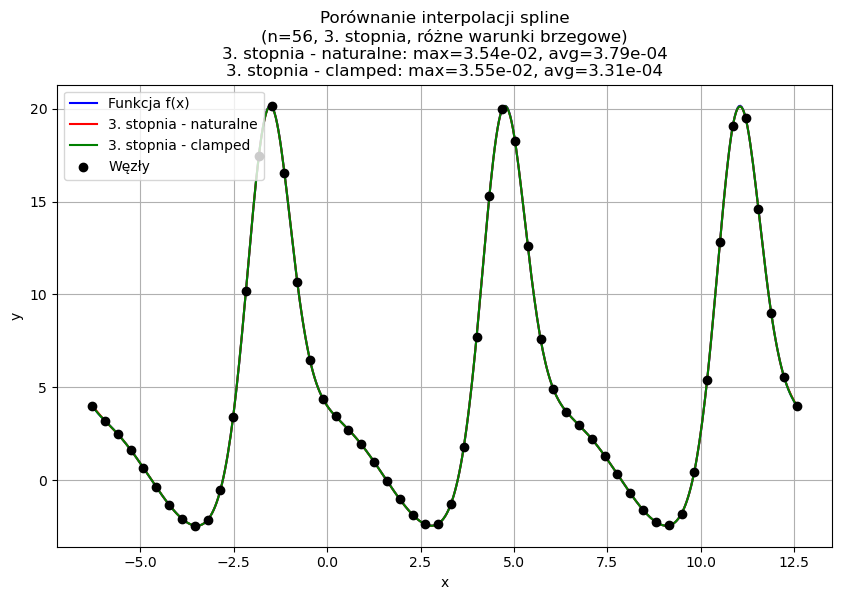

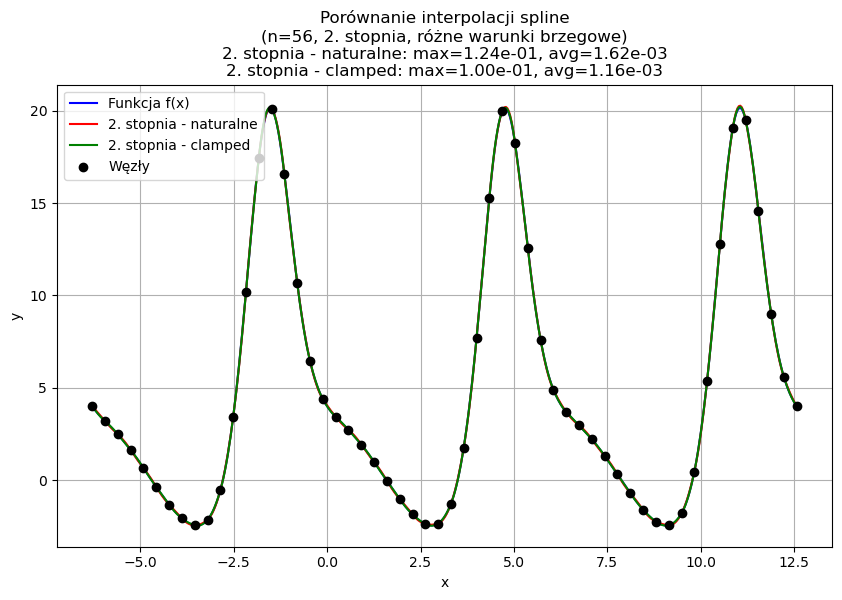

------------------
 Dla n = 56 węzłów
------------------

Cubic natural: błąd maksymalny = 3.535e-02, błąd średni = 3.793e-04
Cubic clamped: błąd maksymalny = 3.550e-02, błąd średni = 3.314e-04
Quadratic natural: błąd maksymalny = 1.238e-01, błąd średni = 1.624e-03
Quadratic clamped: błąd maksymalny = 1.005e-01, błąd średni = 1.161e-03
------------------
 Dla n = 57 węzłów
------------------



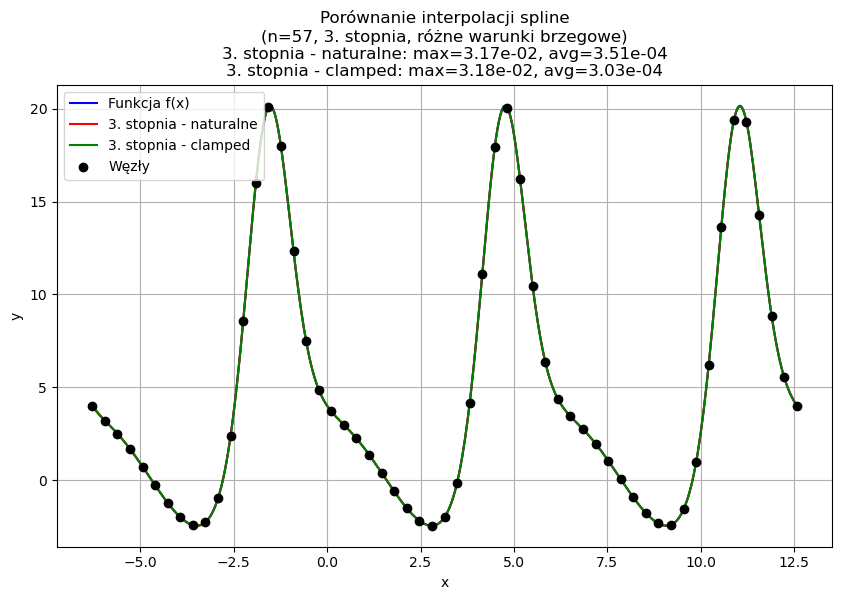

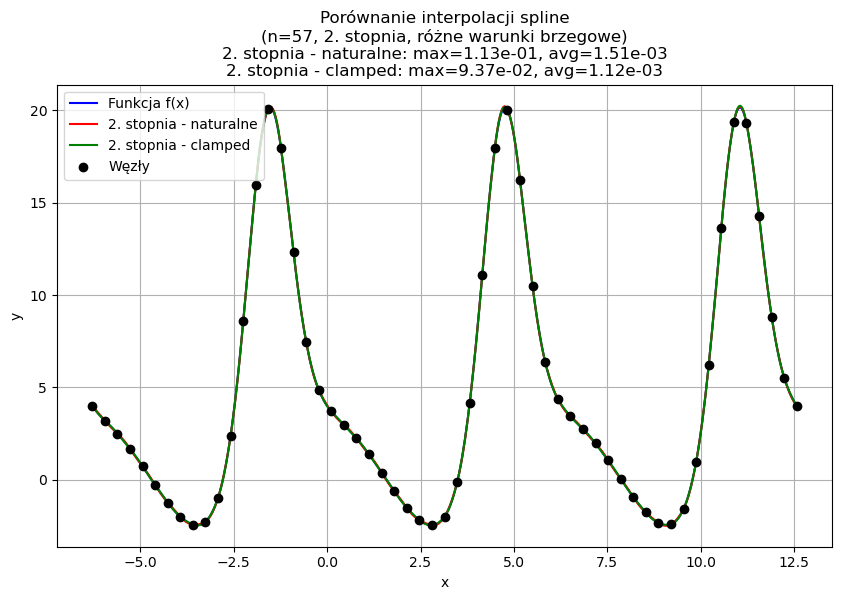

------------------
 Dla n = 57 węzłów
------------------

Cubic natural: błąd maksymalny = 3.168e-02, błąd średni = 3.513e-04
Cubic clamped: błąd maksymalny = 3.183e-02, błąd średni = 3.031e-04
Quadratic natural: błąd maksymalny = 1.129e-01, błąd średni = 1.506e-03
Quadratic clamped: błąd maksymalny = 9.370e-02, błąd średni = 1.116e-03
------------------
 Dla n = 58 węzłów
------------------



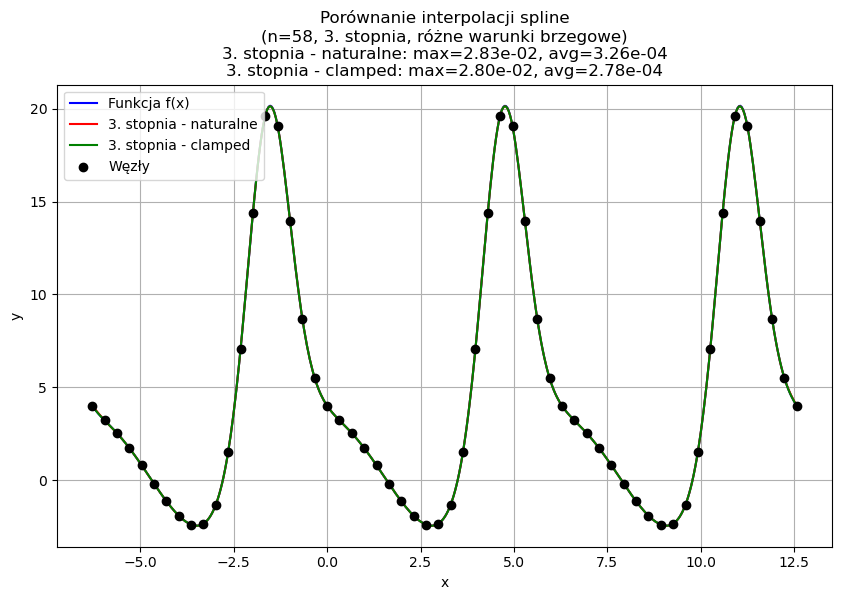

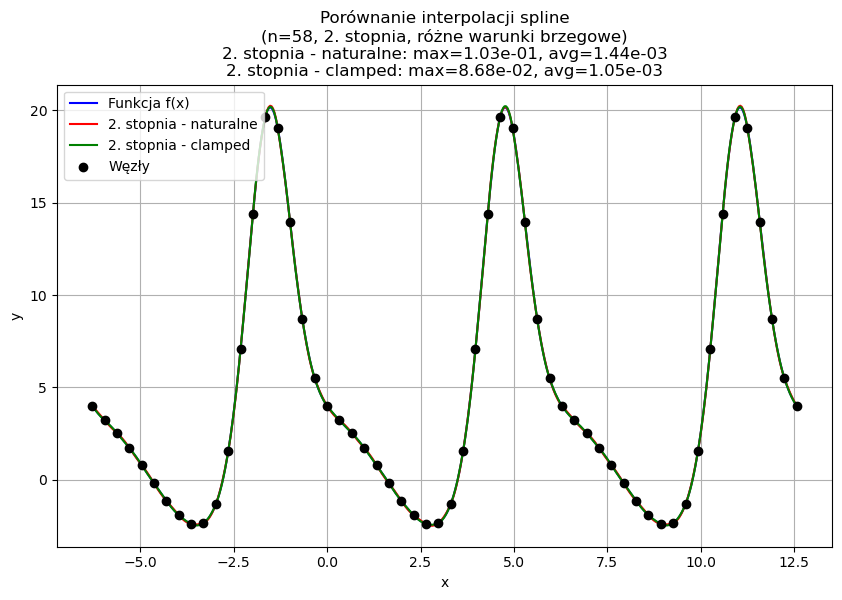

------------------
 Dla n = 58 węzłów
------------------

Cubic natural: błąd maksymalny = 2.831e-02, błąd średni = 3.262e-04
Cubic clamped: błąd maksymalny = 2.803e-02, błąd średni = 2.778e-04
Quadratic natural: błąd maksymalny = 1.032e-01, błąd średni = 1.440e-03
Quadratic clamped: błąd maksymalny = 8.681e-02, błąd średni = 1.052e-03
------------------
 Dla n = 59 węzłów
------------------



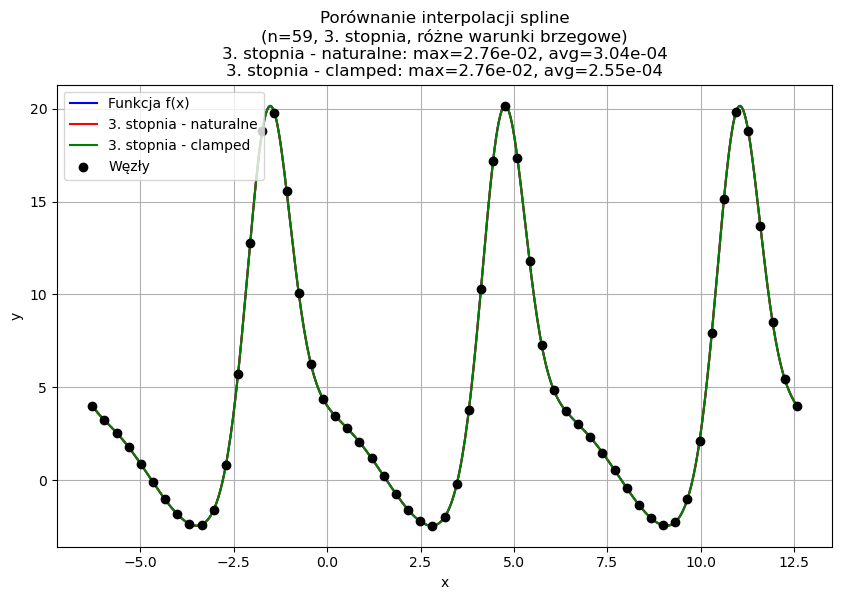

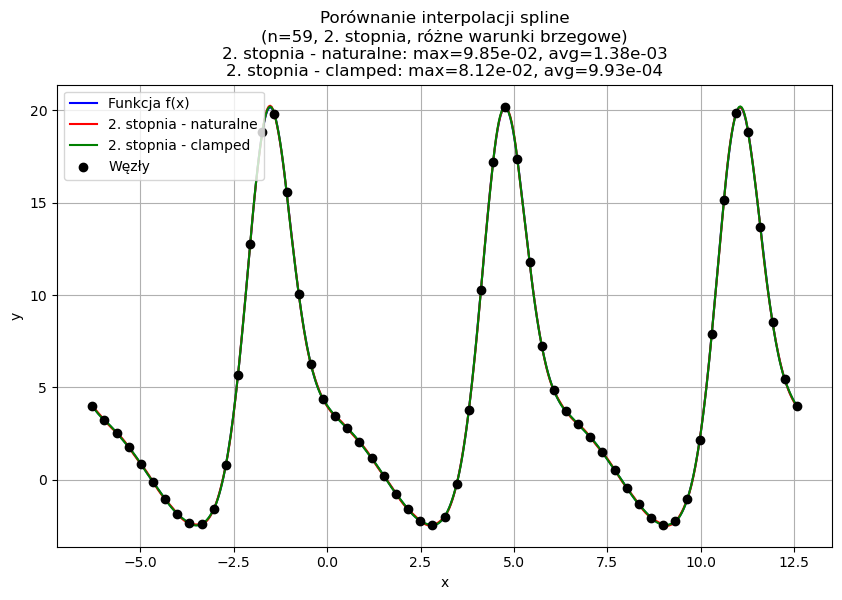

------------------
 Dla n = 59 węzłów
------------------

Cubic natural: błąd maksymalny = 2.762e-02, błąd średni = 3.036e-04
Cubic clamped: błąd maksymalny = 2.762e-02, błąd średni = 2.551e-04
Quadratic natural: błąd maksymalny = 9.849e-02, błąd średni = 1.382e-03
Quadratic clamped: błąd maksymalny = 8.123e-02, błąd średni = 9.934e-04
------------------
 Dla n = 60 węzłów
------------------



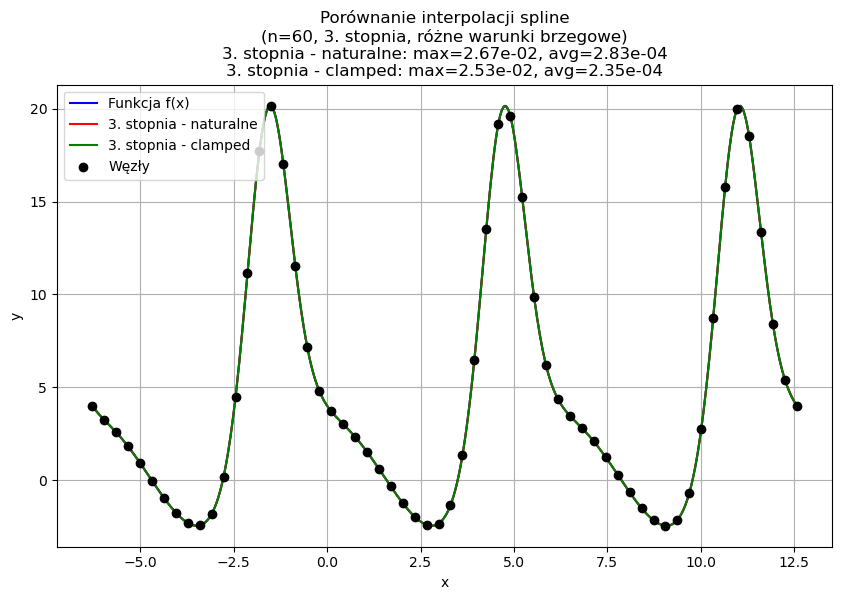

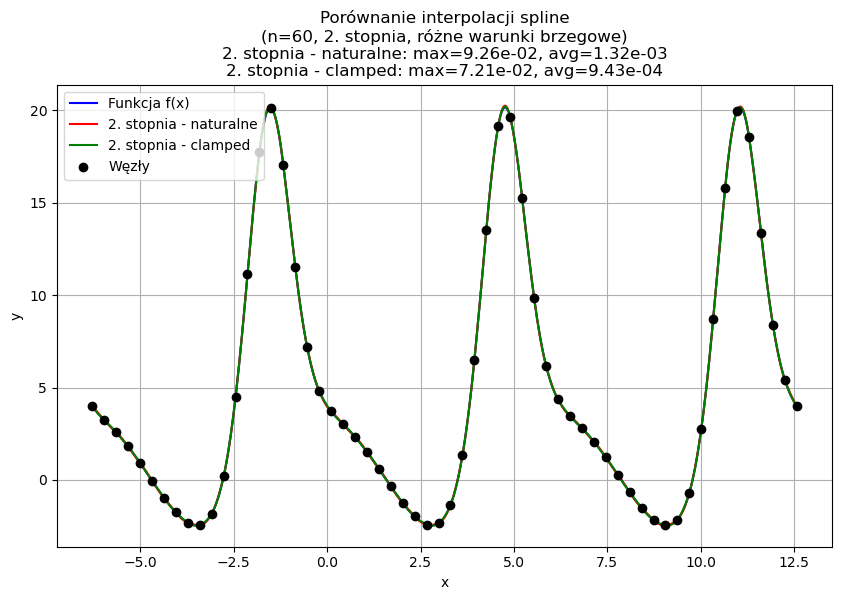

------------------
 Dla n = 60 węzłów
------------------

Cubic natural: błąd maksymalny = 2.672e-02, błąd średni = 2.832e-04
Cubic clamped: błąd maksymalny = 2.532e-02, błąd średni = 2.347e-04
Quadratic natural: błąd maksymalny = 9.264e-02, błąd średni = 1.324e-03
Quadratic clamped: błąd maksymalny = 7.210e-02, błąd średni = 9.428e-04
------------------
 Dla n = 61 węzłów
------------------



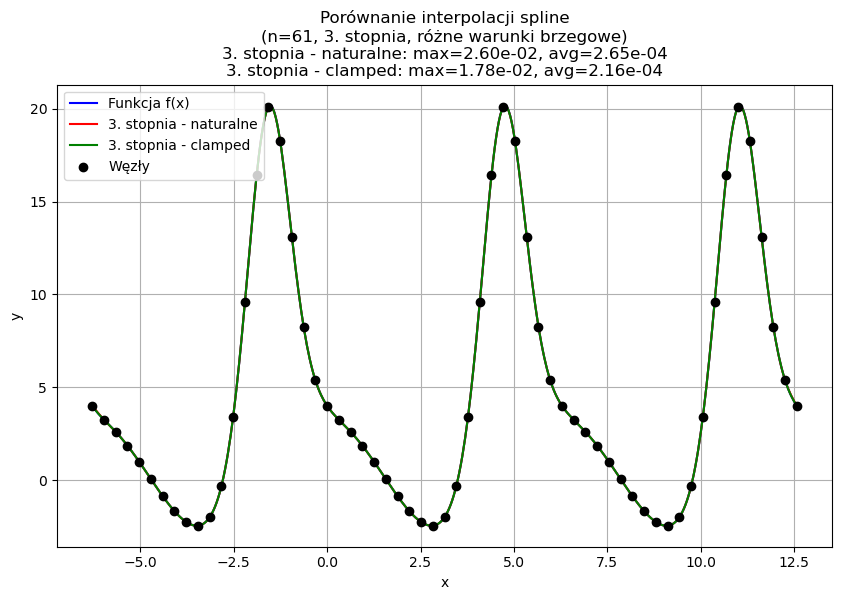

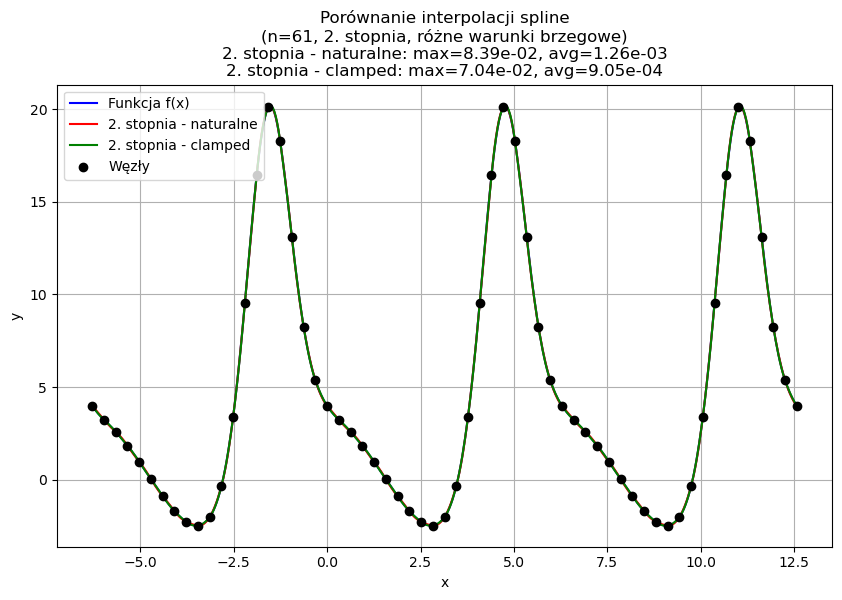

------------------
 Dla n = 61 węzłów
------------------

Cubic natural: błąd maksymalny = 2.596e-02, błąd średni = 2.648e-04
Cubic clamped: błąd maksymalny = 1.785e-02, błąd średni = 2.164e-04
Quadratic natural: błąd maksymalny = 8.389e-02, błąd średni = 1.260e-03
Quadratic clamped: błąd maksymalny = 7.035e-02, błąd średni = 9.047e-04
------------------
 Dla n = 62 węzłów
------------------



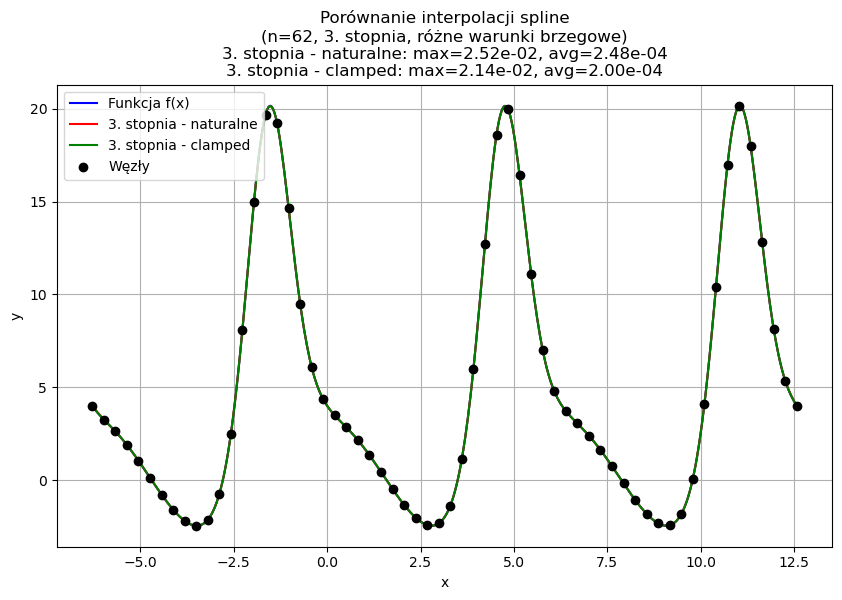

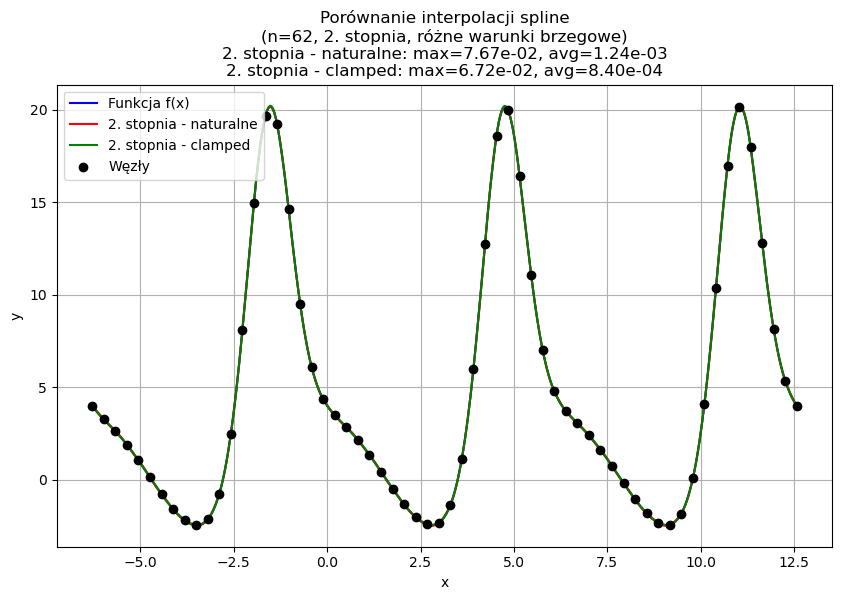

------------------
 Dla n = 62 węzłów
------------------

Cubic natural: błąd maksymalny = 2.523e-02, błąd średni = 2.481e-04
Cubic clamped: błąd maksymalny = 2.137e-02, błąd średni = 1.998e-04
Quadratic natural: błąd maksymalny = 7.668e-02, błąd średni = 1.242e-03
Quadratic clamped: błąd maksymalny = 6.720e-02, błąd średni = 8.396e-04
------------------
 Dla n = 63 węzłów
------------------



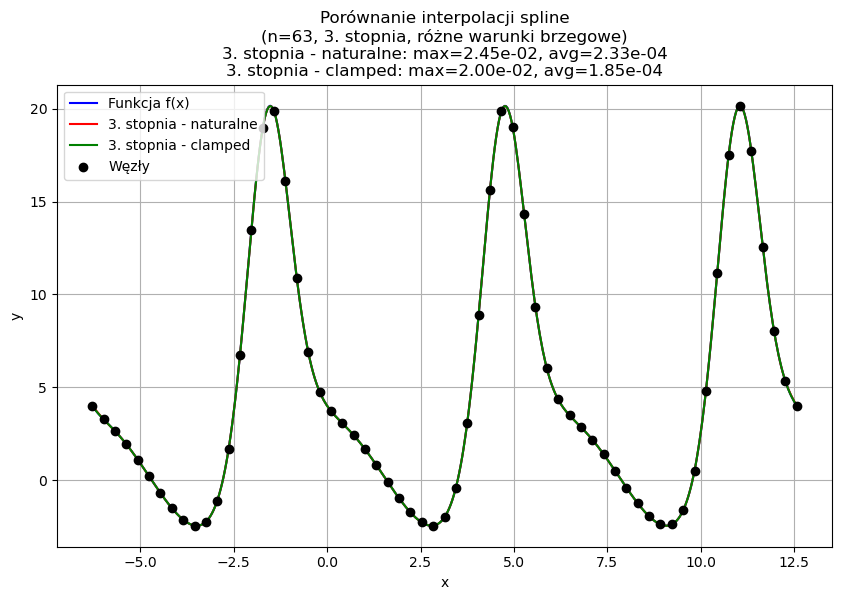

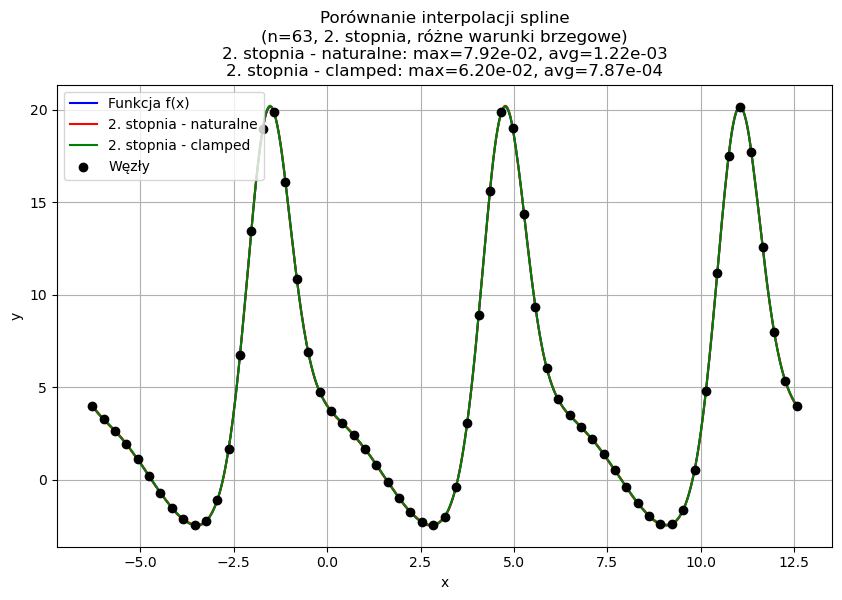

------------------
 Dla n = 63 węzłów
------------------

Cubic natural: błąd maksymalny = 2.451e-02, błąd średni = 2.330e-04
Cubic clamped: błąd maksymalny = 2.004e-02, błąd średni = 1.848e-04
Quadratic natural: błąd maksymalny = 7.918e-02, błąd średni = 1.216e-03
Quadratic clamped: błąd maksymalny = 6.198e-02, błąd średni = 7.865e-04
------------------
 Dla n = 64 węzłów
------------------



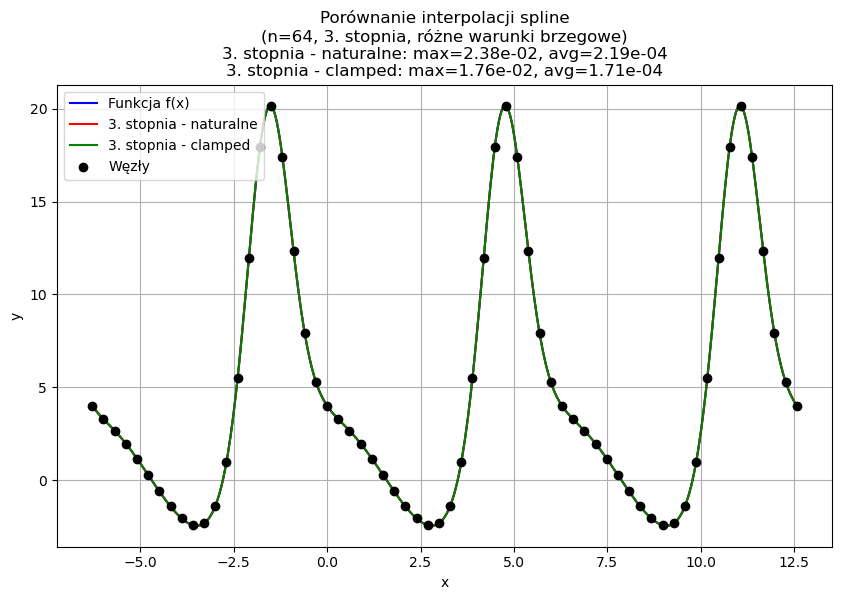

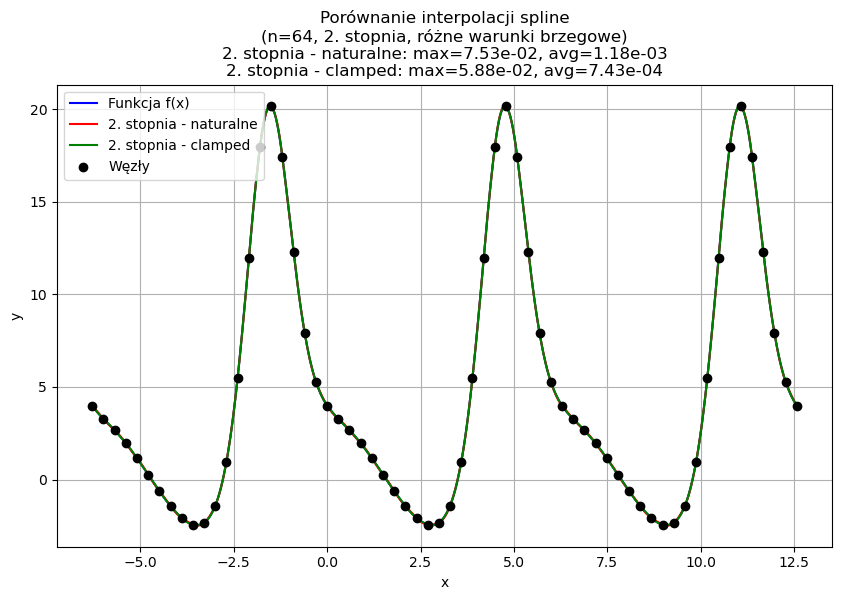

------------------
 Dla n = 64 węzłów
------------------

Cubic natural: błąd maksymalny = 2.382e-02, błąd średni = 2.192e-04
Cubic clamped: błąd maksymalny = 1.761e-02, błąd średni = 1.712e-04
Quadratic natural: błąd maksymalny = 7.531e-02, błąd średni = 1.183e-03
Quadratic clamped: błąd maksymalny = 5.881e-02, błąd średni = 7.432e-04
------------------
 Dla n = 65 węzłów
------------------



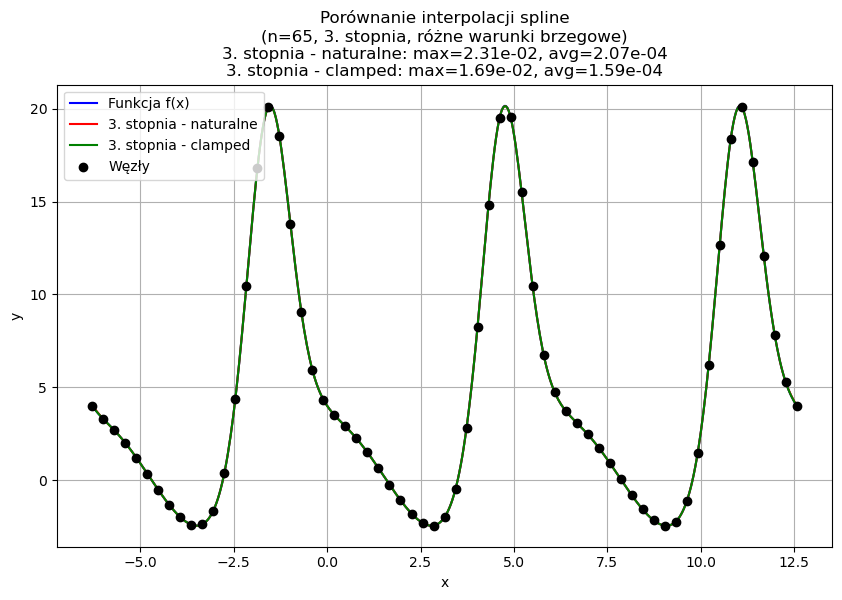

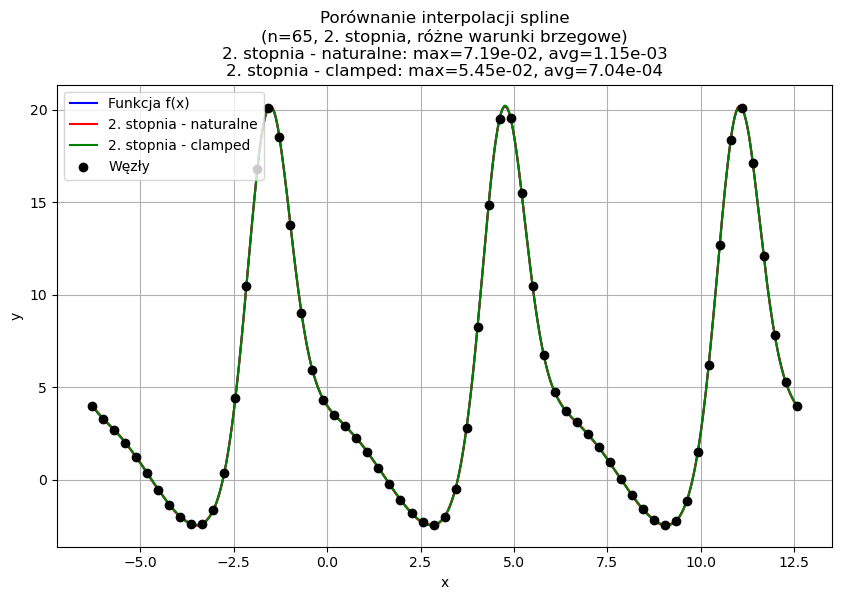

------------------
 Dla n = 65 węzłów
------------------

Cubic natural: błąd maksymalny = 2.314e-02, błąd średni = 2.066e-04
Cubic clamped: błąd maksymalny = 1.691e-02, błąd średni = 1.588e-04
Quadratic natural: błąd maksymalny = 7.191e-02, błąd średni = 1.151e-03
Quadratic clamped: błąd maksymalny = 5.451e-02, błąd średni = 7.036e-04
------------------
 Dla n = 66 węzłów
------------------



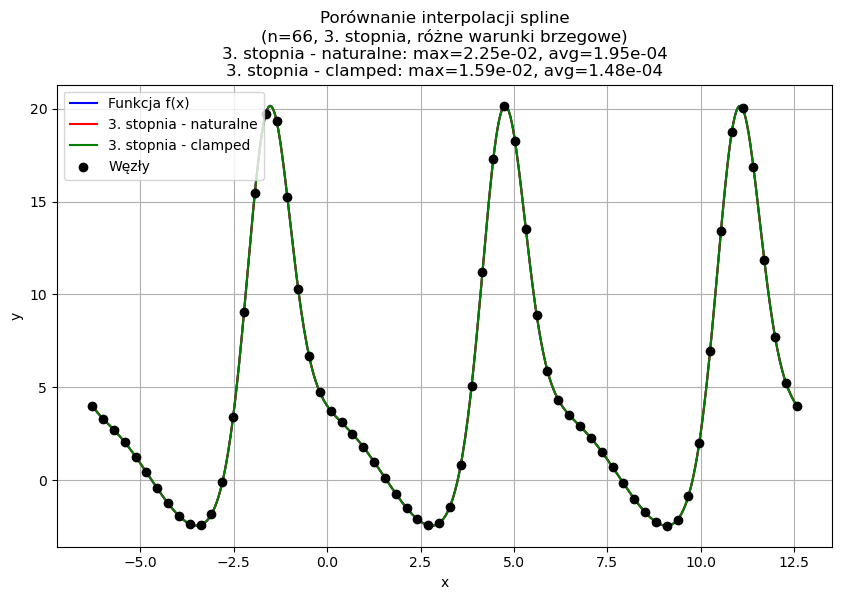

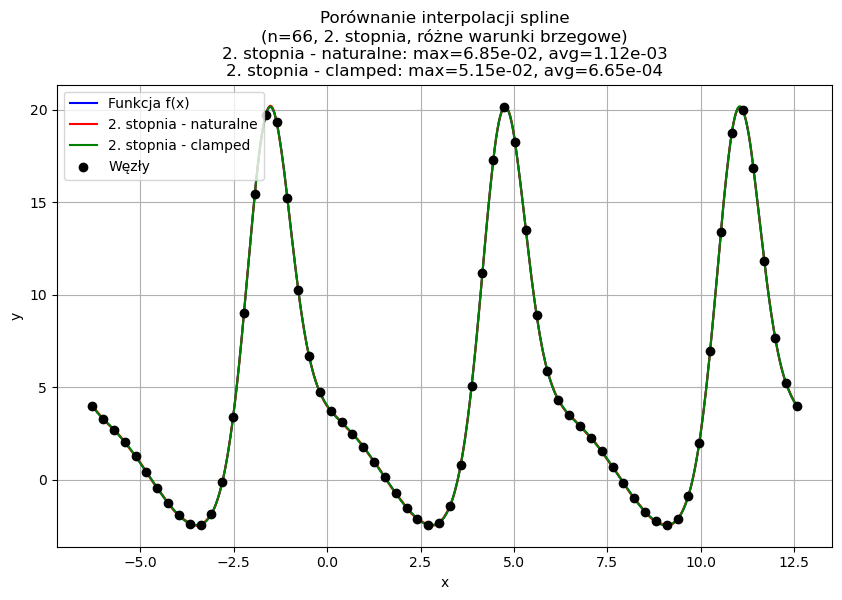

------------------
 Dla n = 66 węzłów
------------------

Cubic natural: błąd maksymalny = 2.249e-02, błąd średni = 1.950e-04
Cubic clamped: błąd maksymalny = 1.590e-02, błąd średni = 1.476e-04
Quadratic natural: błąd maksymalny = 6.847e-02, błąd średni = 1.124e-03
Quadratic clamped: błąd maksymalny = 5.148e-02, błąd średni = 6.649e-04
------------------
 Dla n = 67 węzłów
------------------



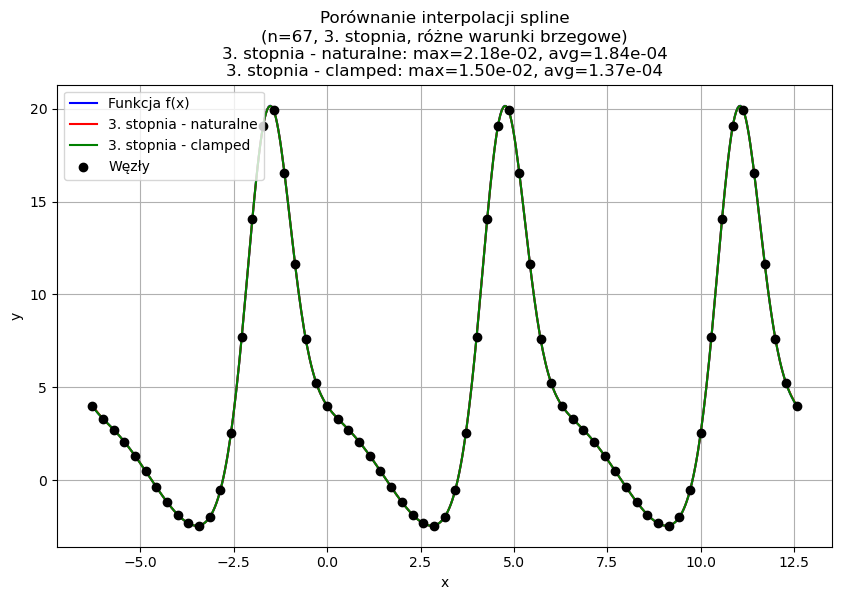

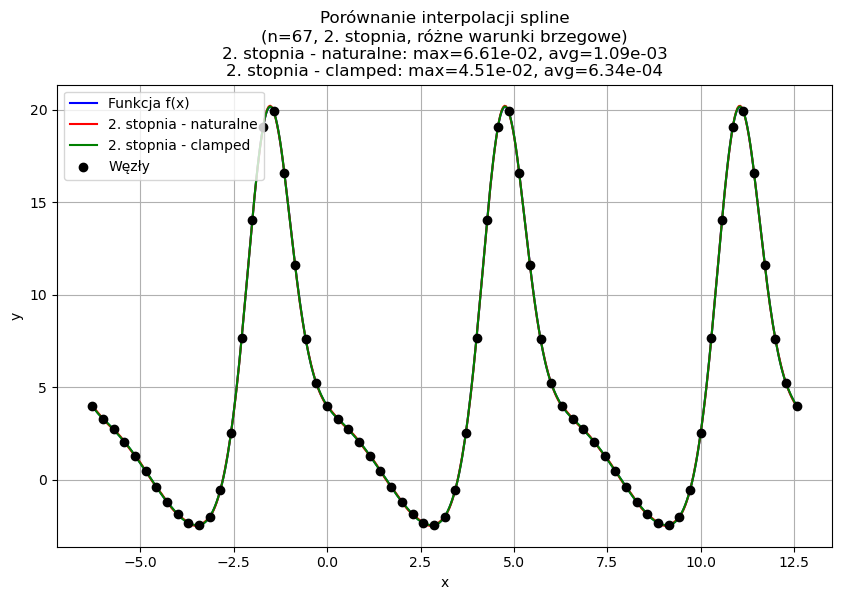

------------------
 Dla n = 67 węzłów
------------------

Cubic natural: błąd maksymalny = 2.185e-02, błąd średni = 1.844e-04
Cubic clamped: błąd maksymalny = 1.499e-02, błąd średni = 1.373e-04
Quadratic natural: błąd maksymalny = 6.614e-02, błąd średni = 1.092e-03
Quadratic clamped: błąd maksymalny = 4.511e-02, błąd średni = 6.337e-04
------------------
 Dla n = 68 węzłów
------------------



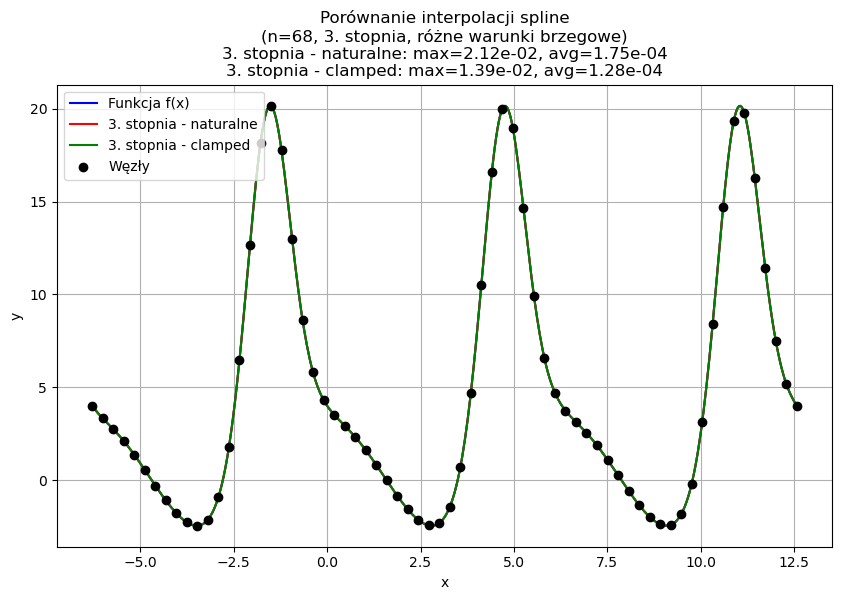

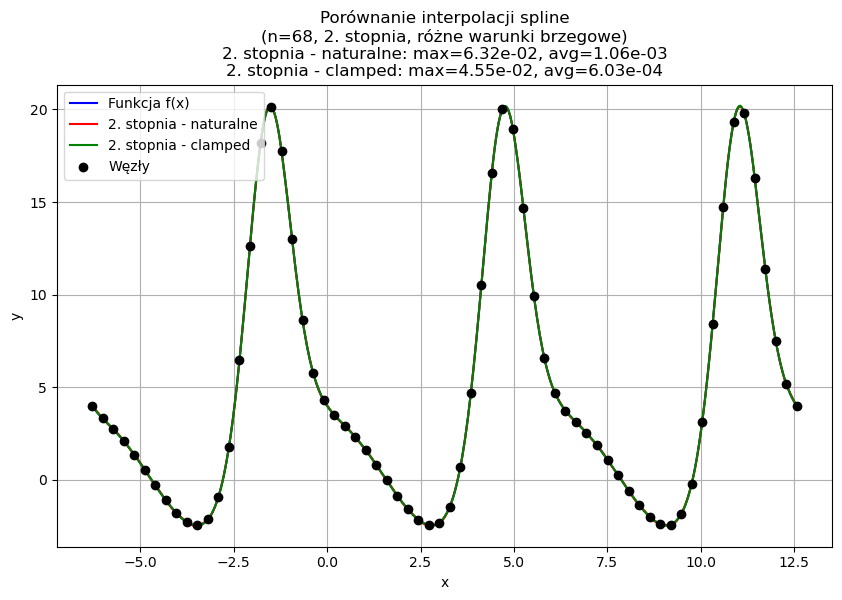

------------------
 Dla n = 68 węzłów
------------------

Cubic natural: błąd maksymalny = 2.123e-02, błąd średni = 1.747e-04
Cubic clamped: błąd maksymalny = 1.390e-02, błąd średni = 1.279e-04
Quadratic natural: błąd maksymalny = 6.320e-02, błąd średni = 1.063e-03
Quadratic clamped: błąd maksymalny = 4.548e-02, błąd średni = 6.030e-04
------------------
 Dla n = 69 węzłów
------------------



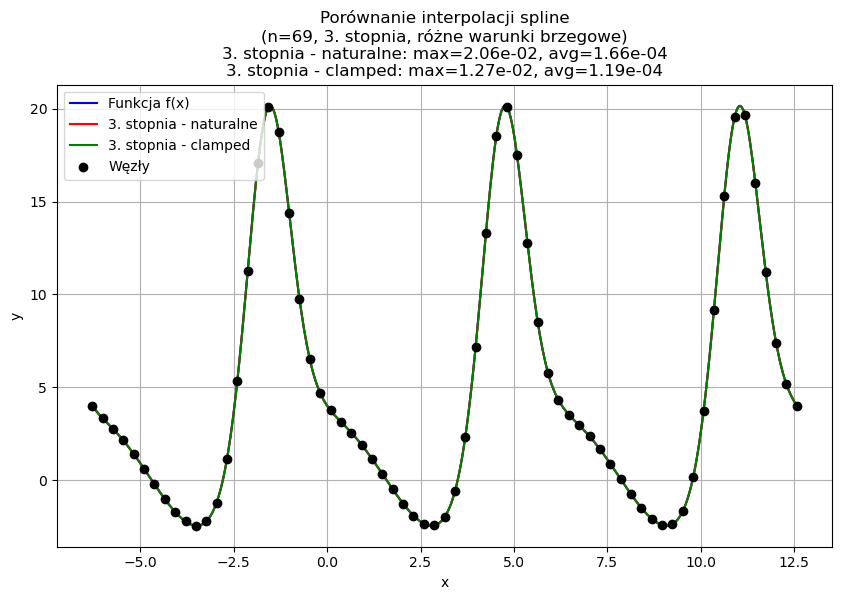

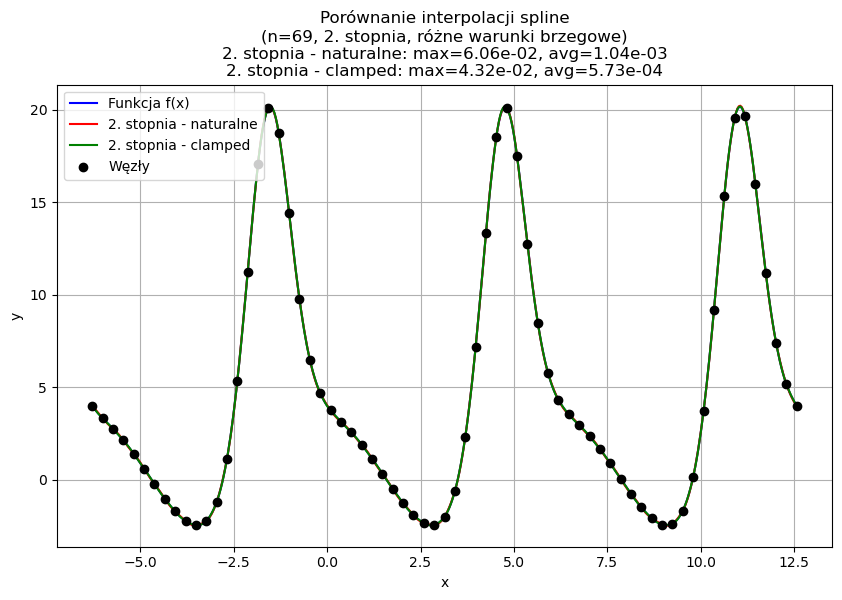

------------------
 Dla n = 69 węzłów
------------------

Cubic natural: błąd maksymalny = 2.062e-02, błąd średni = 1.658e-04
Cubic clamped: błąd maksymalny = 1.269e-02, błąd średni = 1.194e-04
Quadratic natural: błąd maksymalny = 6.058e-02, błąd średni = 1.039e-03
Quadratic clamped: błąd maksymalny = 4.317e-02, błąd średni = 5.731e-04
------------------
 Dla n = 70 węzłów
------------------



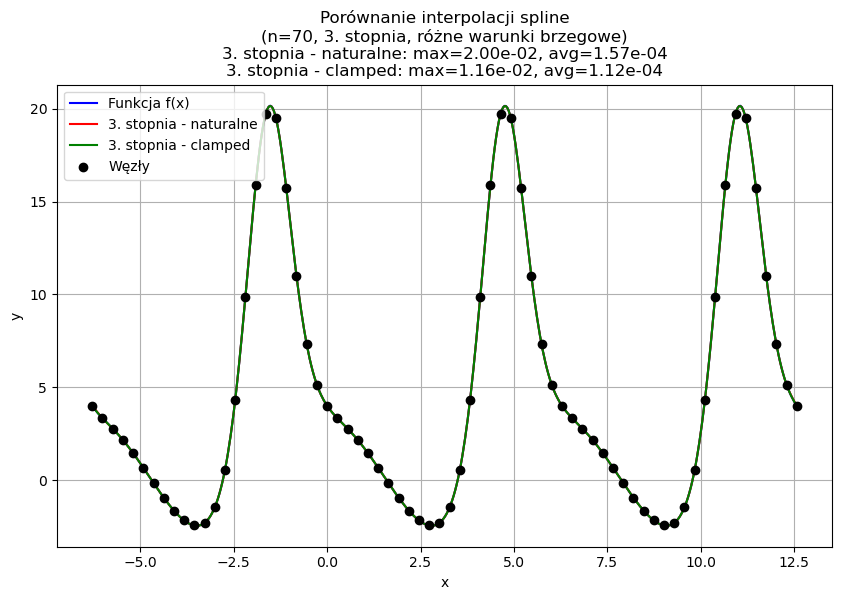

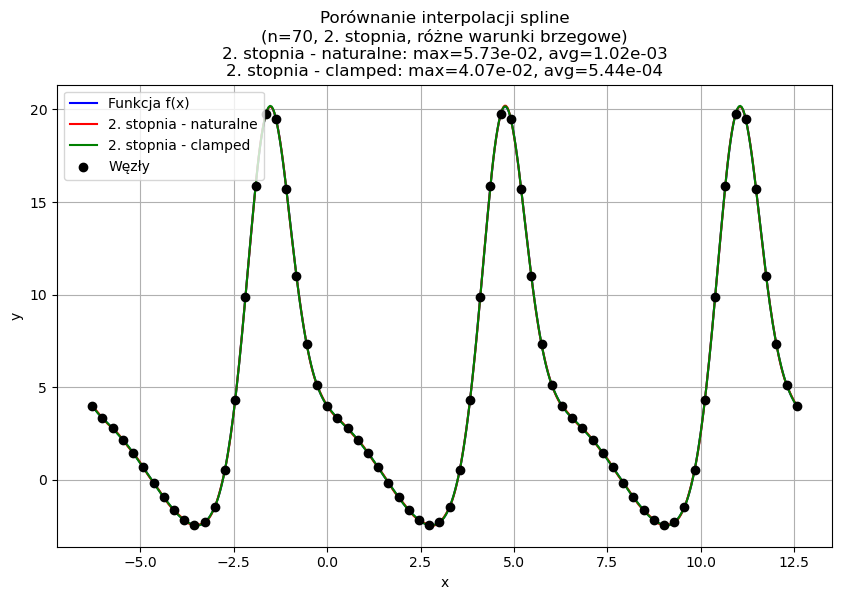

------------------
 Dla n = 70 węzłów
------------------

Cubic natural: błąd maksymalny = 2.004e-02, błąd średni = 1.575e-04
Cubic clamped: błąd maksymalny = 1.162e-02, błąd średni = 1.115e-04
Quadratic natural: błąd maksymalny = 5.732e-02, błąd średni = 1.017e-03
Quadratic clamped: błąd maksymalny = 4.071e-02, błąd średni = 5.442e-04
------------------
 Dla n = 71 węzłów
------------------



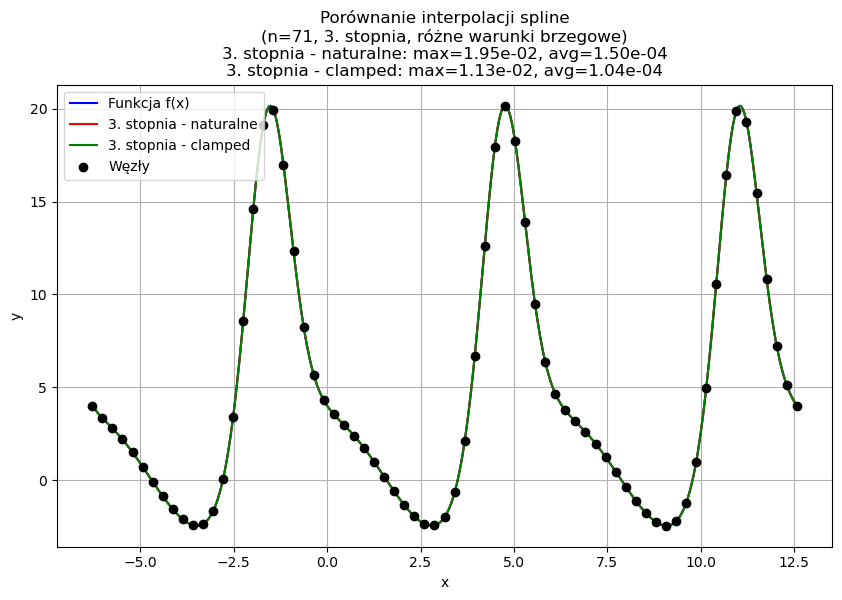

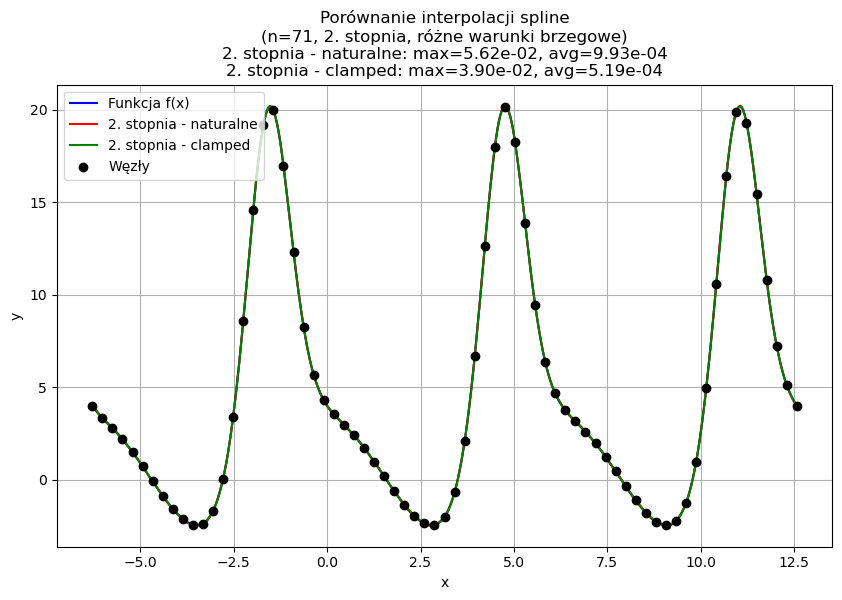

------------------
 Dla n = 71 węzłów
------------------

Cubic natural: błąd maksymalny = 1.947e-02, błąd średni = 1.498e-04
Cubic clamped: błąd maksymalny = 1.131e-02, błąd średni = 1.043e-04
Quadratic natural: błąd maksymalny = 5.620e-02, błąd średni = 9.929e-04
Quadratic clamped: błąd maksymalny = 3.900e-02, błąd średni = 5.188e-04
------------------
 Dla n = 72 węzłów
------------------



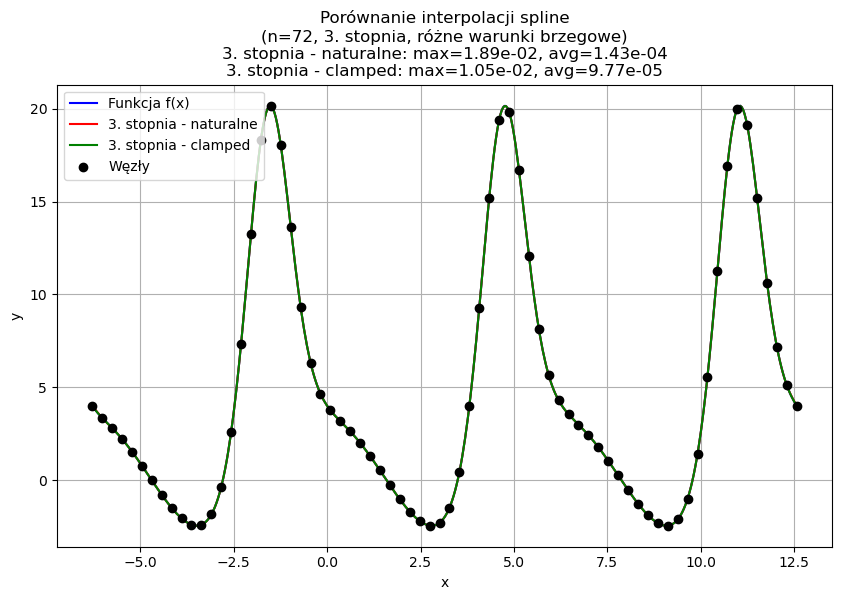

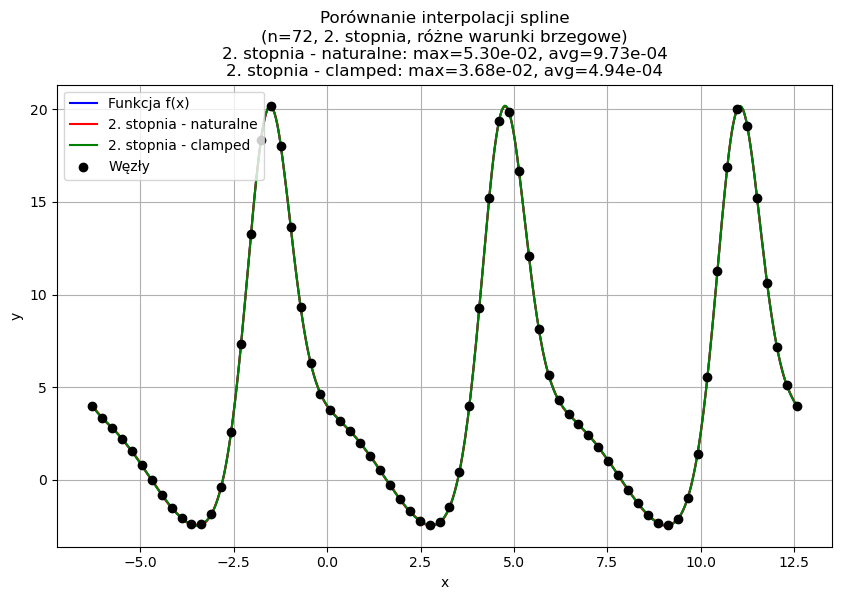

------------------
 Dla n = 72 węzłów
------------------

Cubic natural: błąd maksymalny = 1.891e-02, błąd średni = 1.427e-04
Cubic clamped: błąd maksymalny = 1.050e-02, błąd średni = 9.766e-05
Quadratic natural: błąd maksymalny = 5.304e-02, błąd średni = 9.726e-04
Quadratic clamped: błąd maksymalny = 3.678e-02, błąd średni = 4.936e-04
------------------
 Dla n = 73 węzłów
------------------



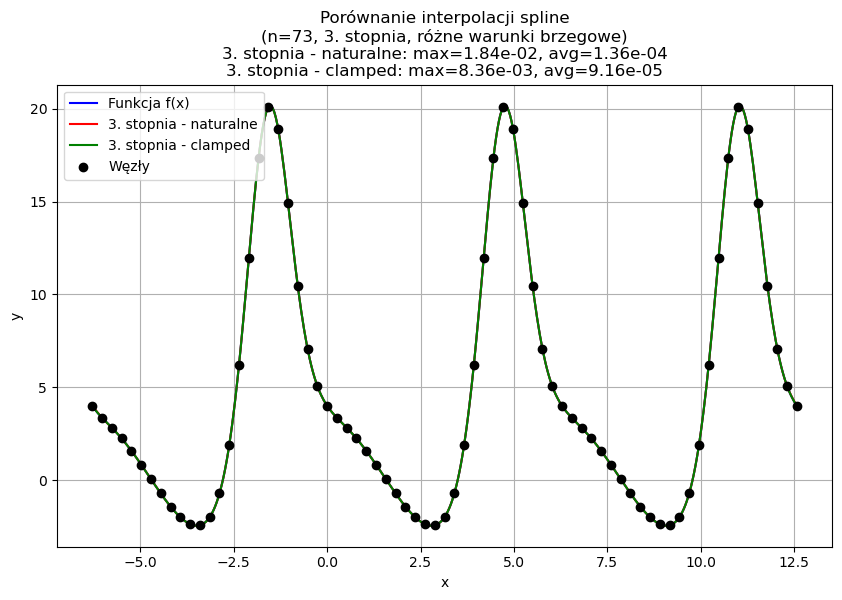

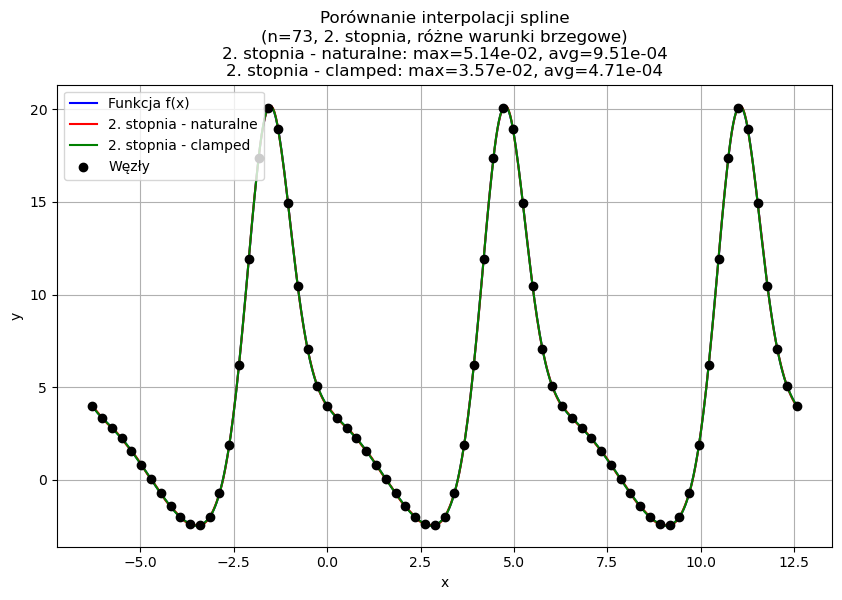

------------------
 Dla n = 73 węzłów
------------------

Cubic natural: błąd maksymalny = 1.837e-02, błąd średni = 1.361e-04
Cubic clamped: błąd maksymalny = 8.356e-03, błąd średni = 9.156e-05
Quadratic natural: błąd maksymalny = 5.140e-02, błąd średni = 9.512e-04
Quadratic clamped: błąd maksymalny = 3.572e-02, błąd średni = 4.711e-04
------------------
 Dla n = 74 węzłów
------------------



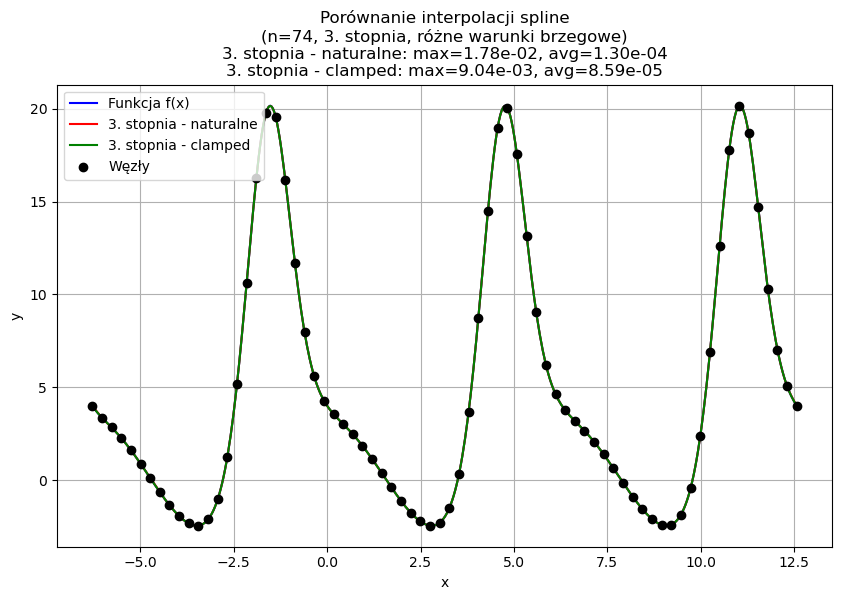

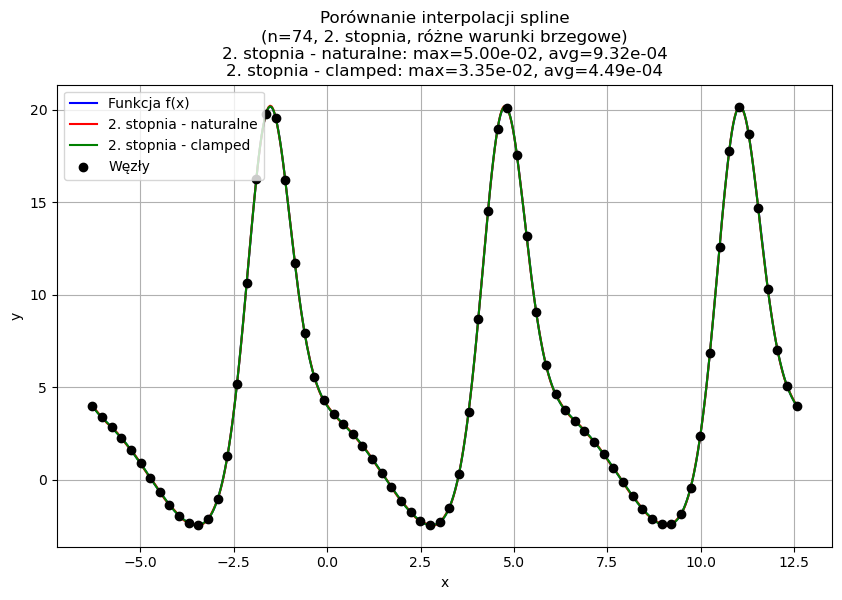

------------------
 Dla n = 74 węzłów
------------------

Cubic natural: błąd maksymalny = 1.785e-02, błąd średni = 1.300e-04
Cubic clamped: błąd maksymalny = 9.038e-03, błąd średni = 8.594e-05
Quadratic natural: błąd maksymalny = 5.000e-02, błąd średni = 9.317e-04
Quadratic clamped: błąd maksymalny = 3.354e-02, błąd średni = 4.494e-04
------------------
 Dla n = 75 węzłów
------------------



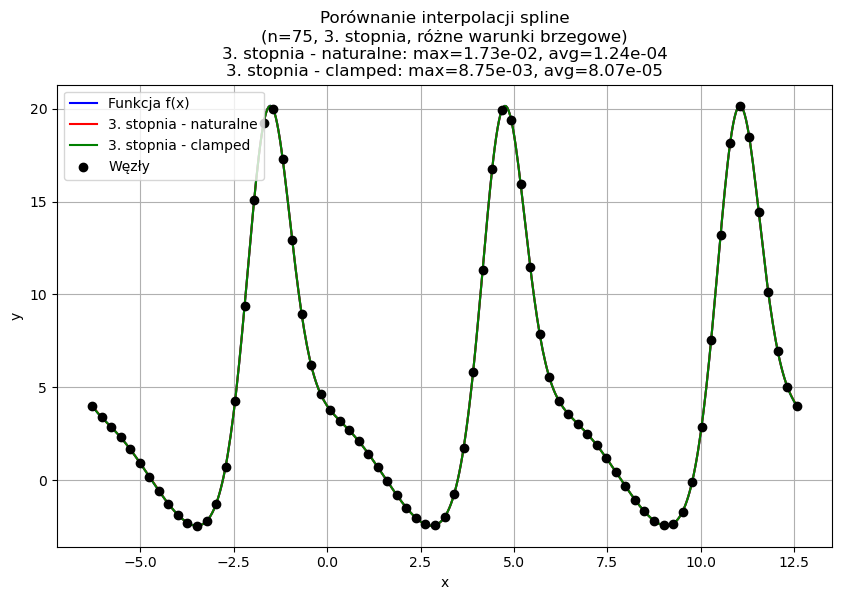

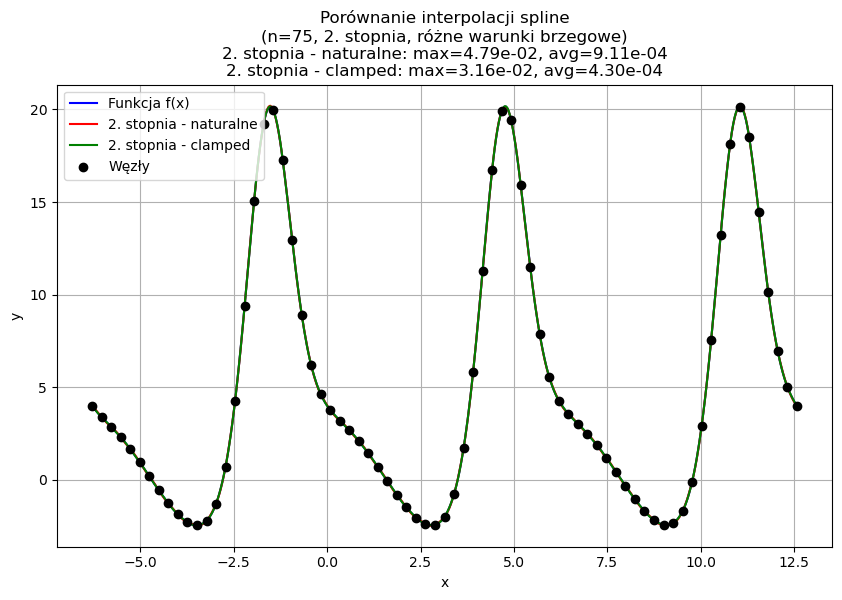

------------------
 Dla n = 75 węzłów
------------------

Cubic natural: błąd maksymalny = 1.734e-02, błąd średni = 1.243e-04
Cubic clamped: błąd maksymalny = 8.752e-03, błąd średni = 8.074e-05
Quadratic natural: błąd maksymalny = 4.792e-02, błąd średni = 9.114e-04
Quadratic clamped: błąd maksymalny = 3.162e-02, błąd średni = 4.300e-04
------------------
 Dla n = 76 węzłów
------------------



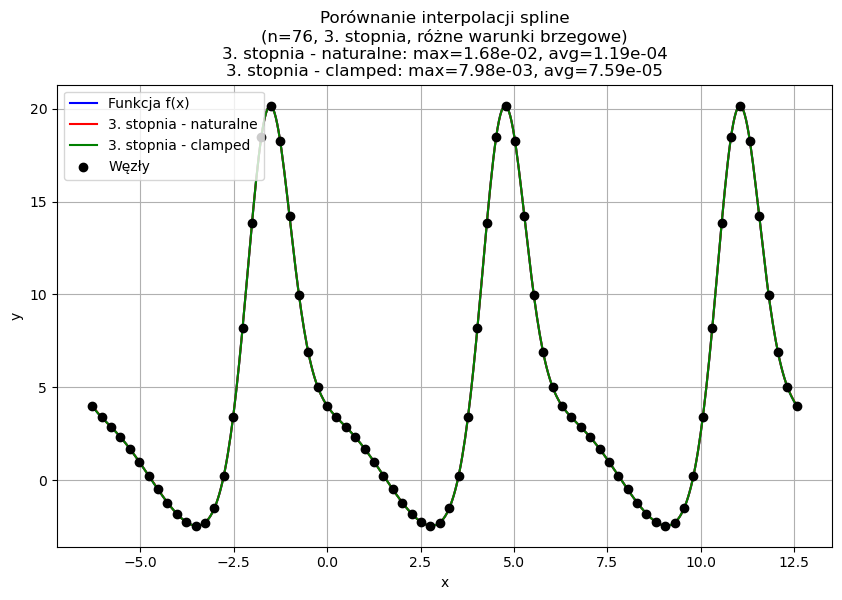

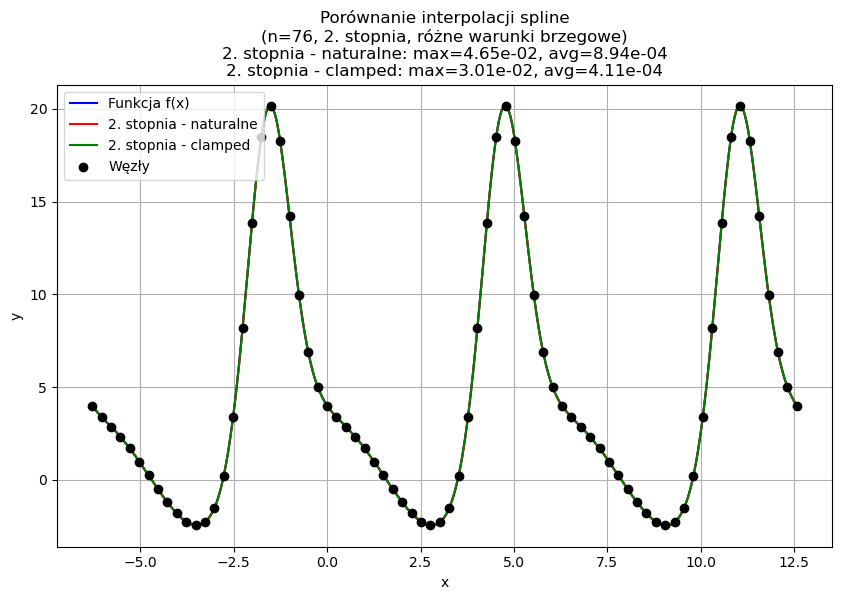

------------------
 Dla n = 76 węzłów
------------------

Cubic natural: błąd maksymalny = 1.684e-02, błąd średni = 1.190e-04
Cubic clamped: błąd maksymalny = 7.985e-03, błąd średni = 7.594e-05
Quadratic natural: błąd maksymalny = 4.653e-02, błąd średni = 8.937e-04
Quadratic clamped: błąd maksymalny = 3.013e-02, błąd średni = 4.105e-04
------------------
 Dla n = 77 węzłów
------------------



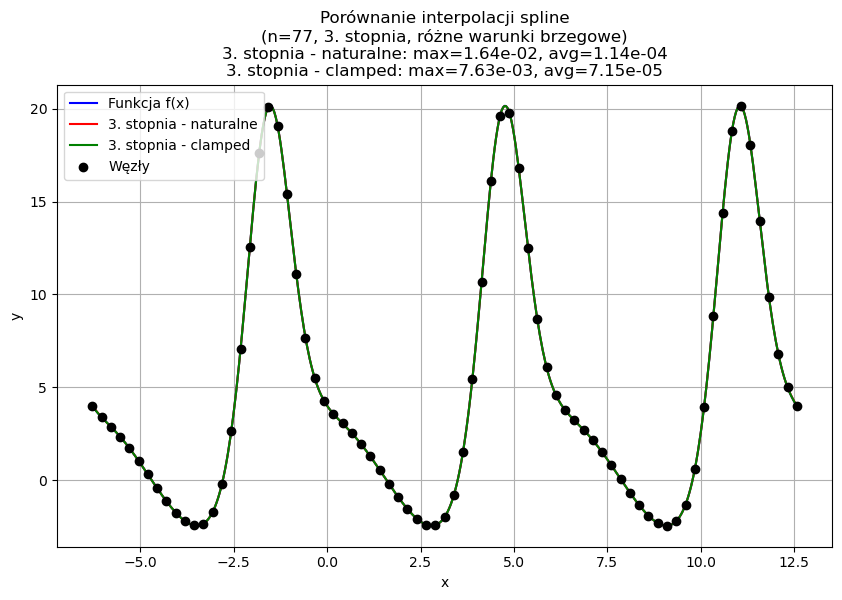

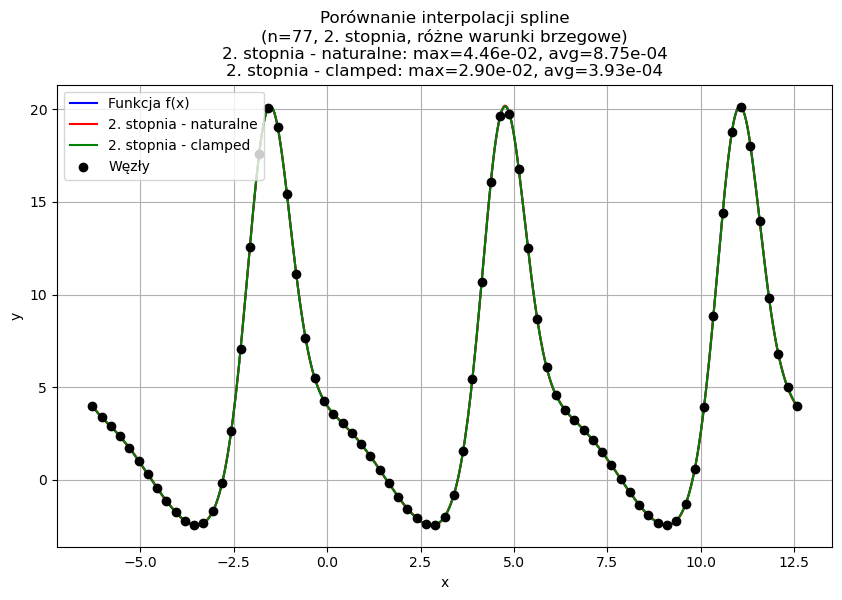

------------------
 Dla n = 77 węzłów
------------------

Cubic natural: błąd maksymalny = 1.644e-02, błąd średni = 1.140e-04
Cubic clamped: błąd maksymalny = 7.627e-03, błąd średni = 7.149e-05
Quadratic natural: błąd maksymalny = 4.464e-02, błąd średni = 8.750e-04
Quadratic clamped: błąd maksymalny = 2.904e-02, błąd średni = 3.934e-04
------------------
 Dla n = 78 węzłów
------------------



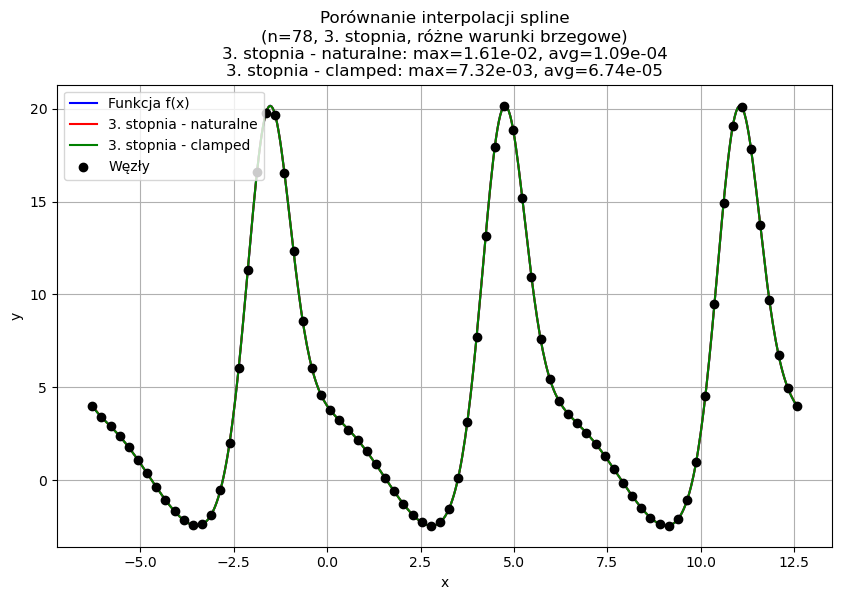

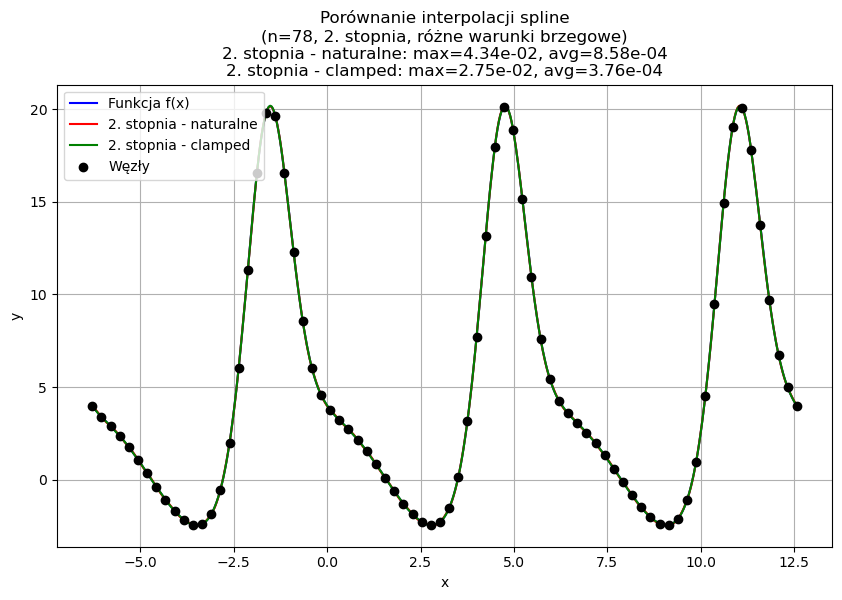

------------------
 Dla n = 78 węzłów
------------------

Cubic natural: błąd maksymalny = 1.610e-02, błąd średni = 1.093e-04
Cubic clamped: błąd maksymalny = 7.317e-03, błąd średni = 6.737e-05
Quadratic natural: błąd maksymalny = 4.335e-02, błąd średni = 8.584e-04
Quadratic clamped: błąd maksymalny = 2.755e-02, błąd średni = 3.762e-04
------------------
 Dla n = 79 węzłów
------------------



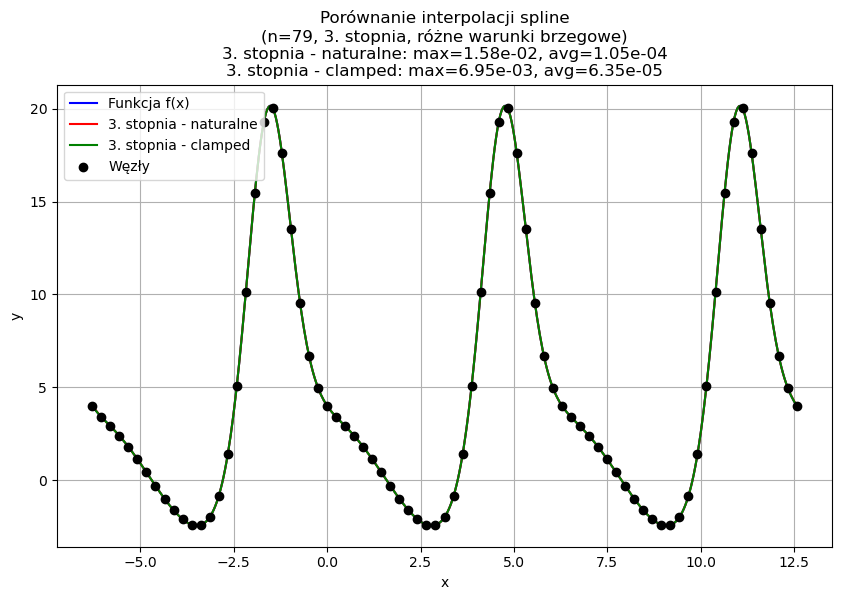

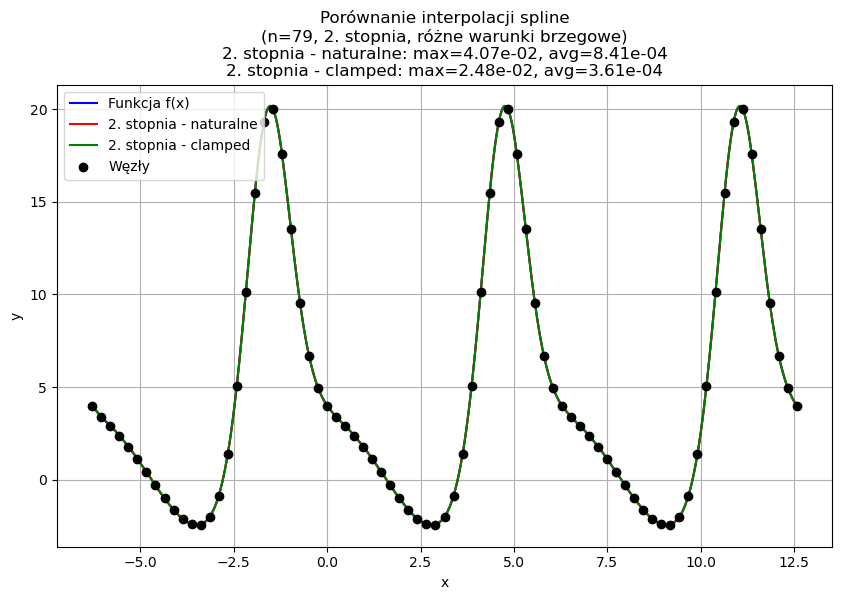

------------------
 Dla n = 79 węzłów
------------------

Cubic natural: błąd maksymalny = 1.576e-02, błąd średni = 1.049e-04
Cubic clamped: błąd maksymalny = 6.950e-03, błąd średni = 6.355e-05
Quadratic natural: błąd maksymalny = 4.066e-02, błąd średni = 8.411e-04
Quadratic clamped: błąd maksymalny = 2.484e-02, błąd średni = 3.608e-04
------------------
 Dla n = 80 węzłów
------------------



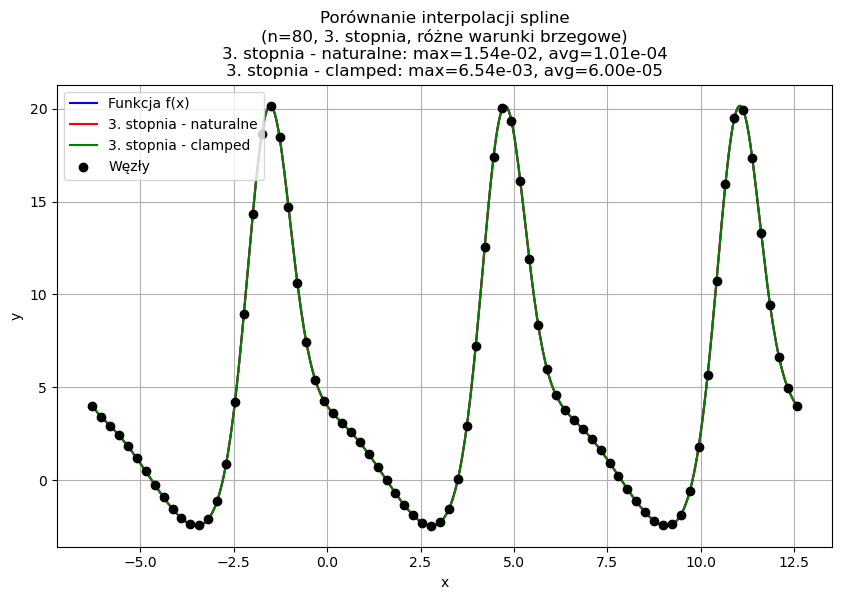

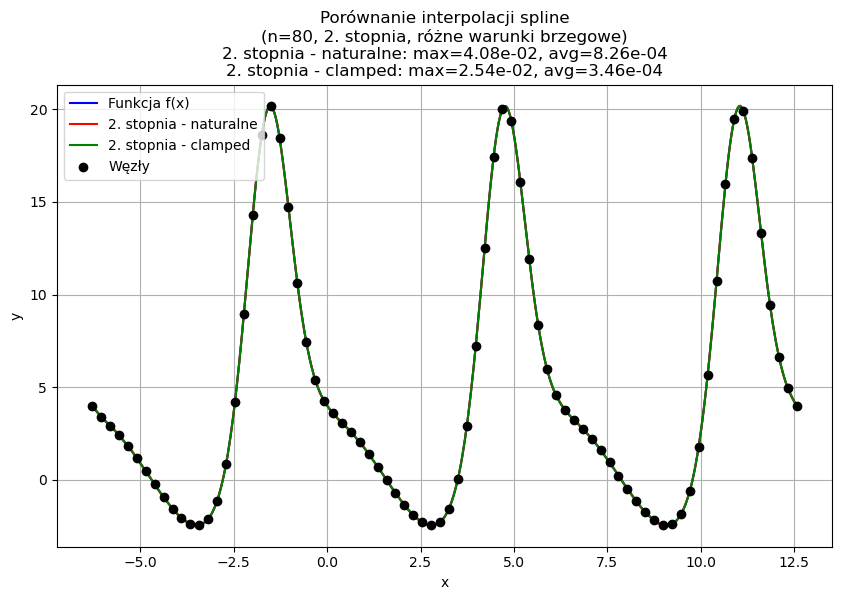

------------------
 Dla n = 80 węzłów
------------------

Cubic natural: błąd maksymalny = 1.543e-02, błąd średni = 1.008e-04
Cubic clamped: błąd maksymalny = 6.543e-03, błąd średni = 5.999e-05
Quadratic natural: błąd maksymalny = 4.076e-02, błąd średni = 8.256e-04
Quadratic clamped: błąd maksymalny = 2.540e-02, błąd średni = 3.455e-04
------------------
 Dla n = 81 węzłów
------------------



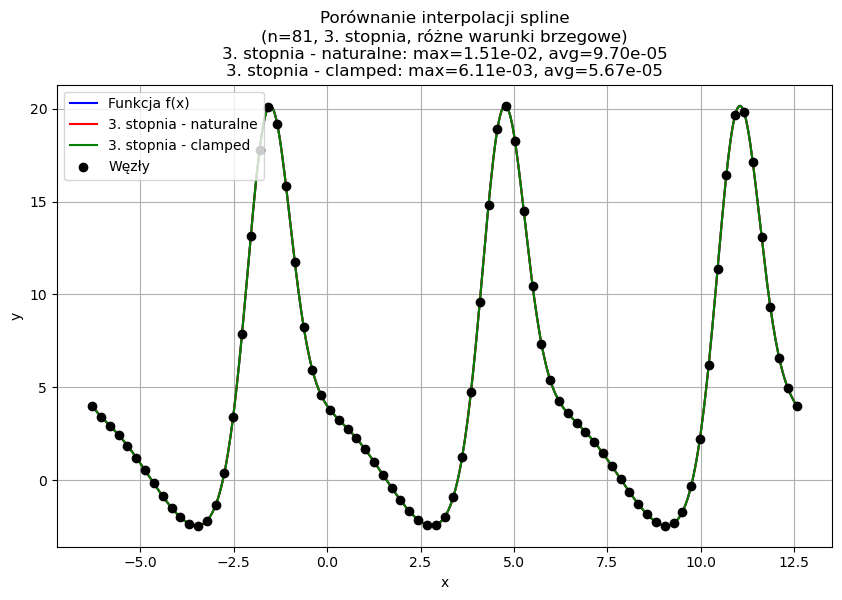

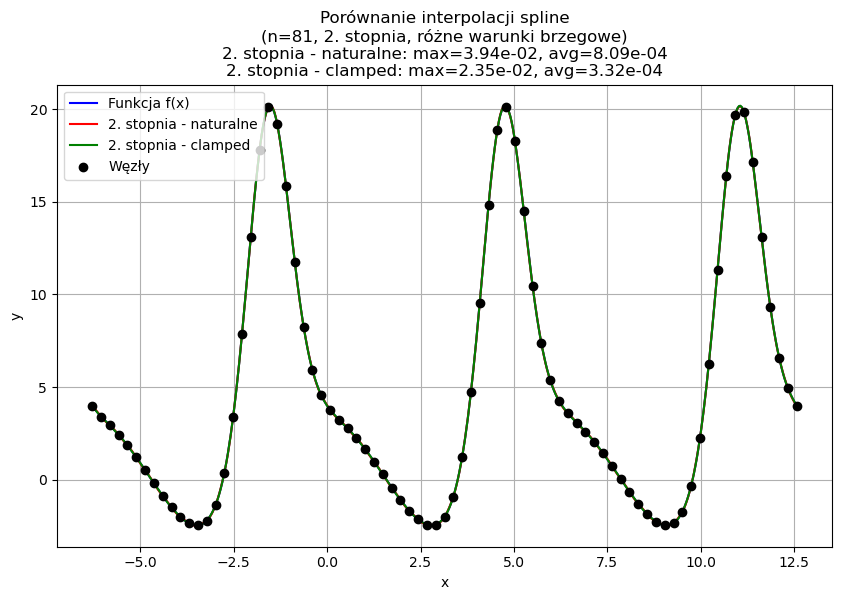

------------------
 Dla n = 81 węzłów
------------------

Cubic natural: błąd maksymalny = 1.511e-02, błąd średni = 9.697e-05
Cubic clamped: błąd maksymalny = 6.113e-03, błąd średni = 5.669e-05
Quadratic natural: błąd maksymalny = 3.938e-02, błąd średni = 8.094e-04
Quadratic clamped: błąd maksymalny = 2.349e-02, błąd średni = 3.318e-04
------------------
 Dla n = 82 węzłów
------------------



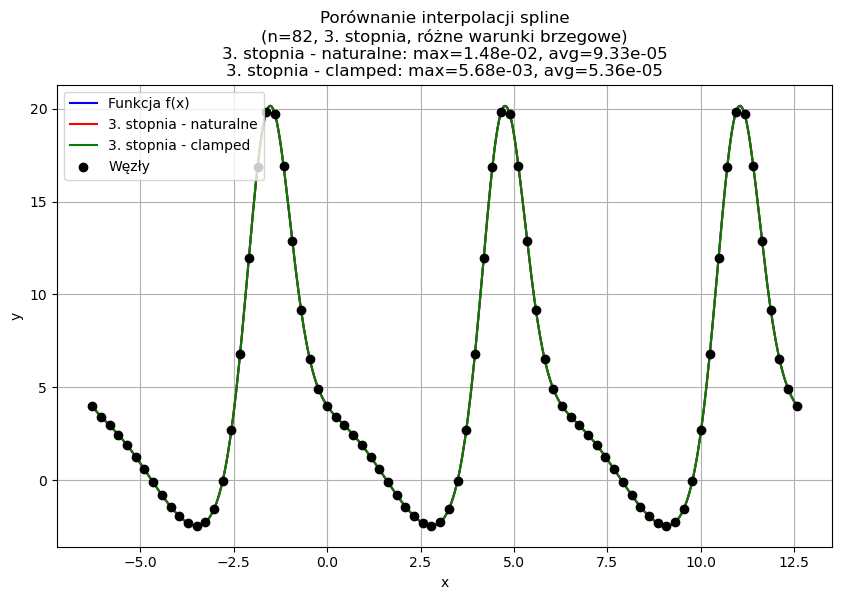

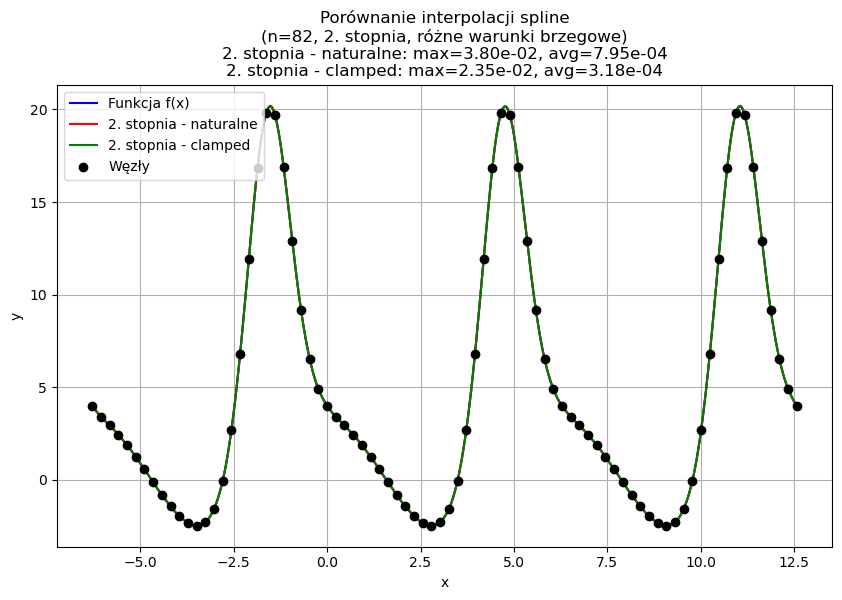

------------------
 Dla n = 82 węzłów
------------------

Cubic natural: błąd maksymalny = 1.480e-02, błąd średni = 9.332e-05
Cubic clamped: błąd maksymalny = 5.678e-03, błąd średni = 5.361e-05
Quadratic natural: błąd maksymalny = 3.796e-02, błąd średni = 7.948e-04
Quadratic clamped: błąd maksymalny = 2.354e-02, błąd średni = 3.182e-04
------------------
 Dla n = 83 węzłów
------------------



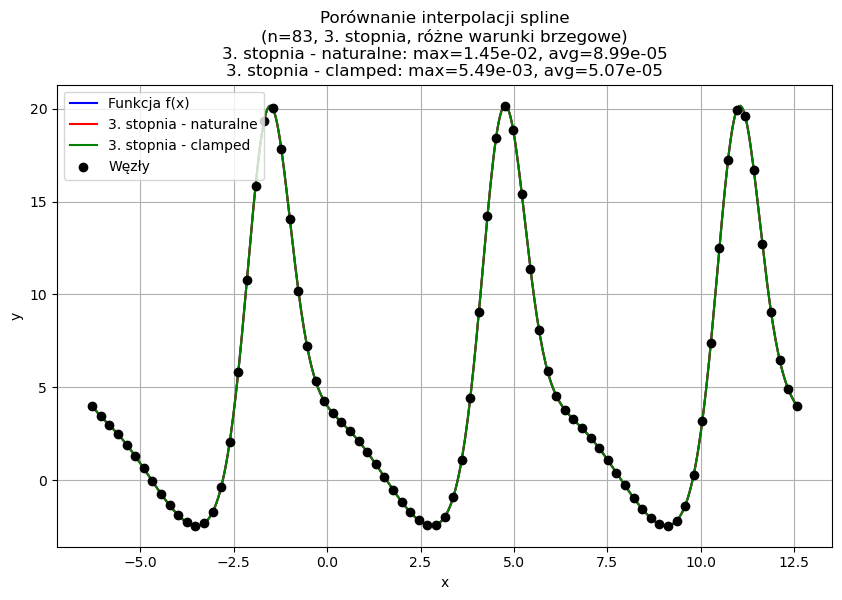

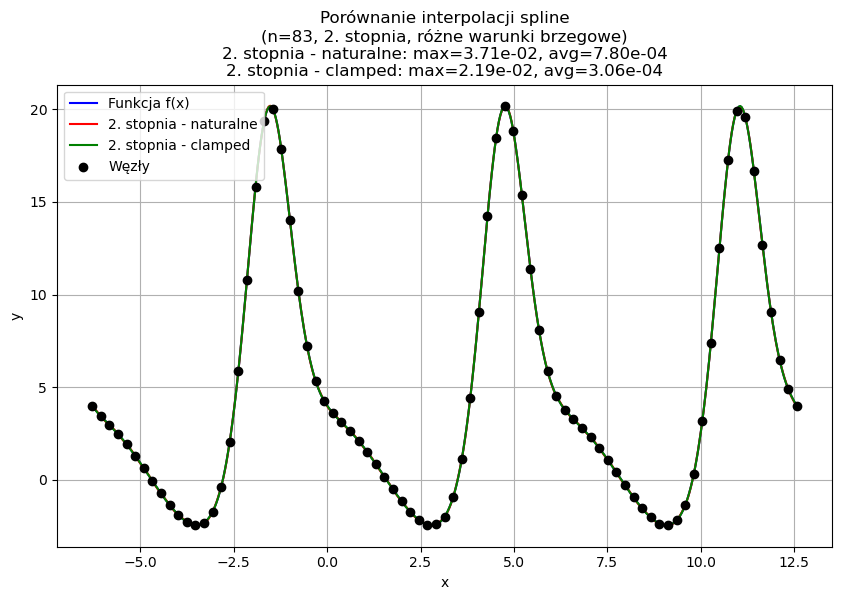

------------------
 Dla n = 83 węzłów
------------------

Cubic natural: błąd maksymalny = 1.450e-02, błąd średni = 8.988e-05
Cubic clamped: błąd maksymalny = 5.491e-03, błąd średni = 5.075e-05
Quadratic natural: błąd maksymalny = 3.708e-02, błąd średni = 7.797e-04
Quadratic clamped: błąd maksymalny = 2.194e-02, błąd średni = 3.059e-04
------------------
 Dla n = 84 węzłów
------------------



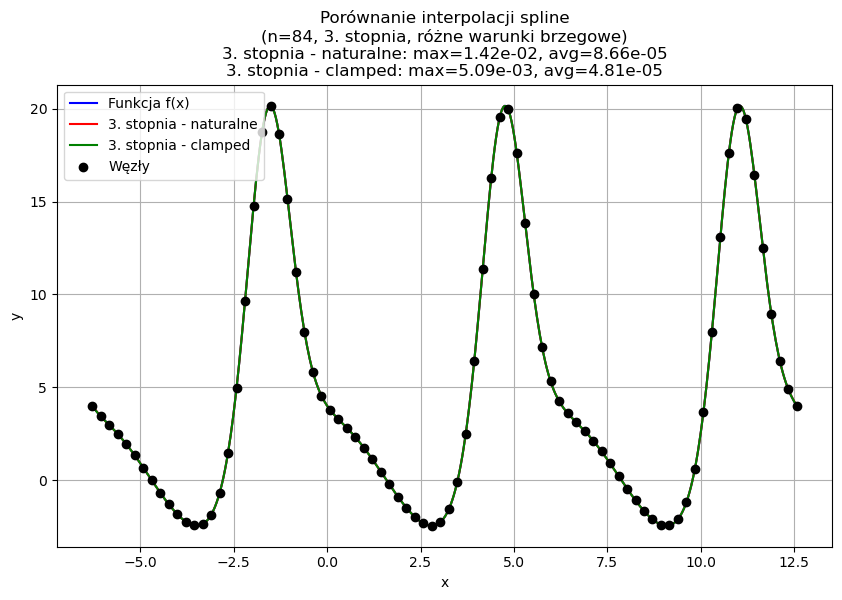

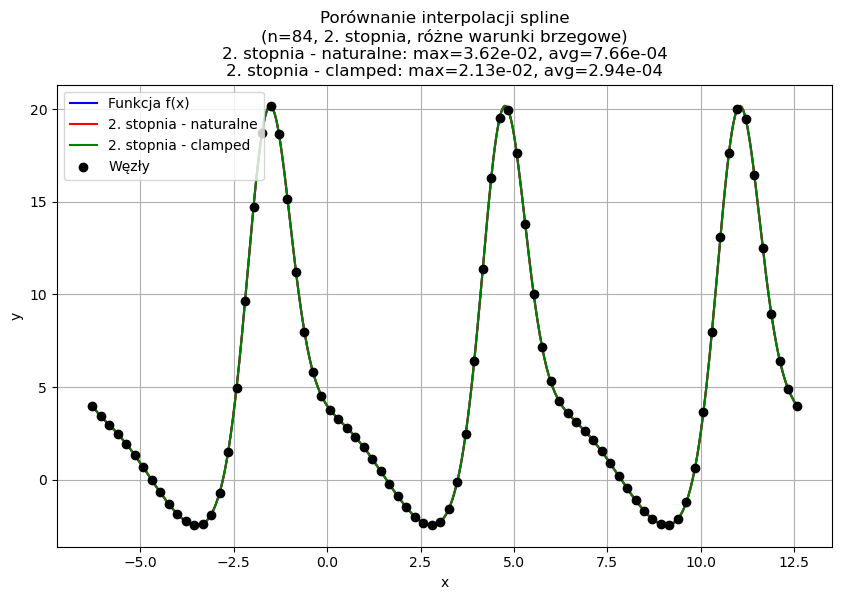

------------------
 Dla n = 84 węzłów
------------------

Cubic natural: błąd maksymalny = 1.420e-02, błąd średni = 8.664e-05
Cubic clamped: błąd maksymalny = 5.087e-03, błąd średni = 4.807e-05
Quadratic natural: błąd maksymalny = 3.621e-02, błąd średni = 7.659e-04
Quadratic clamped: błąd maksymalny = 2.134e-02, błąd średni = 2.937e-04
------------------
 Dla n = 85 węzłów
------------------



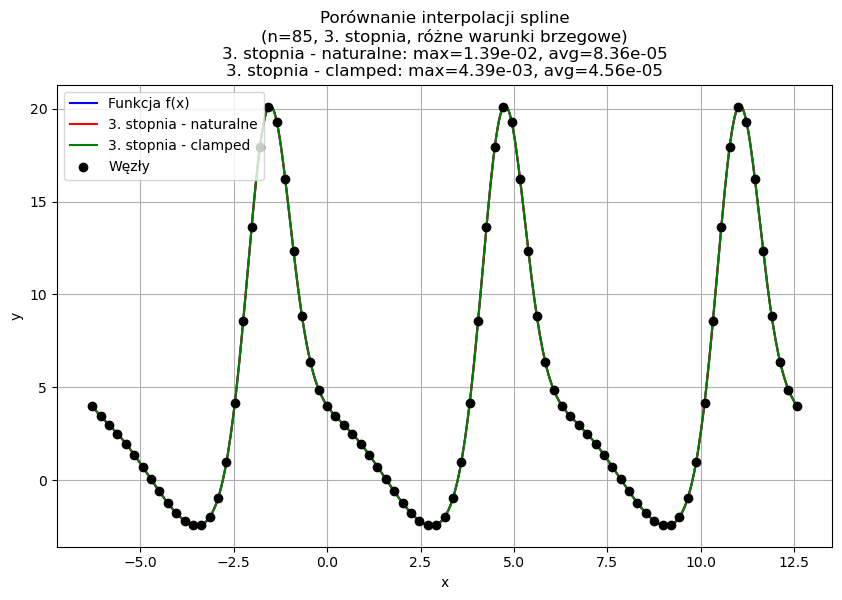

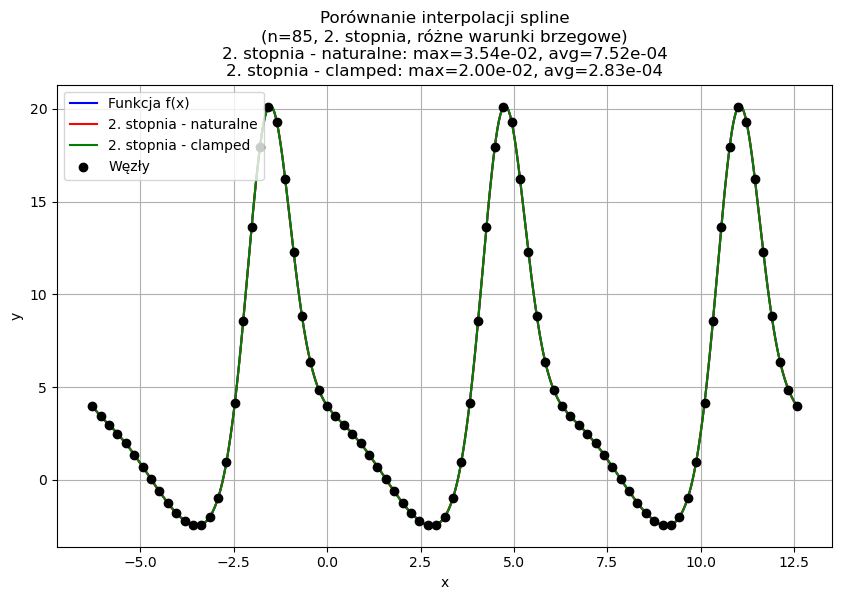

------------------
 Dla n = 85 węzłów
------------------

Cubic natural: błąd maksymalny = 1.391e-02, błąd średni = 8.357e-05
Cubic clamped: błąd maksymalny = 4.392e-03, błąd średni = 4.557e-05
Quadratic natural: błąd maksymalny = 3.535e-02, błąd średni = 7.516e-04
Quadratic clamped: błąd maksymalny = 2.004e-02, błąd średni = 2.827e-04
------------------
 Dla n = 86 węzłów
------------------



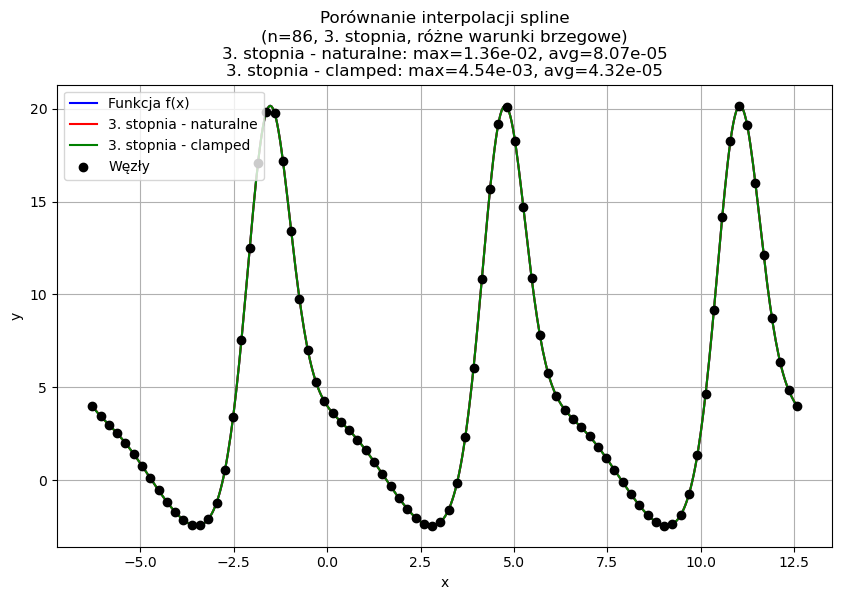

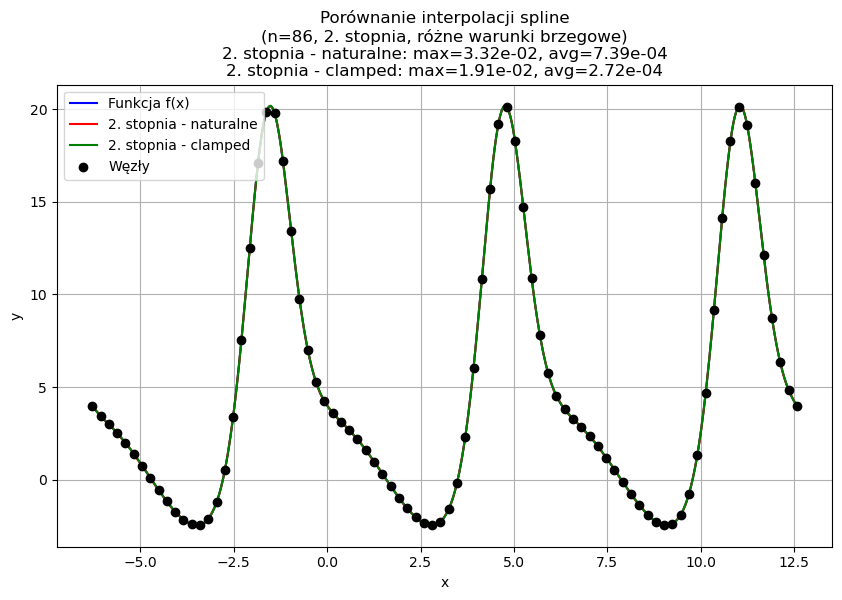

------------------
 Dla n = 86 węzłów
------------------

Cubic natural: błąd maksymalny = 1.362e-02, błąd średni = 8.067e-05
Cubic clamped: błąd maksymalny = 4.542e-03, błąd średni = 4.323e-05
Quadratic natural: błąd maksymalny = 3.315e-02, błąd średni = 7.386e-04
Quadratic clamped: błąd maksymalny = 1.913e-02, błąd średni = 2.717e-04
------------------
 Dla n = 87 węzłów
------------------



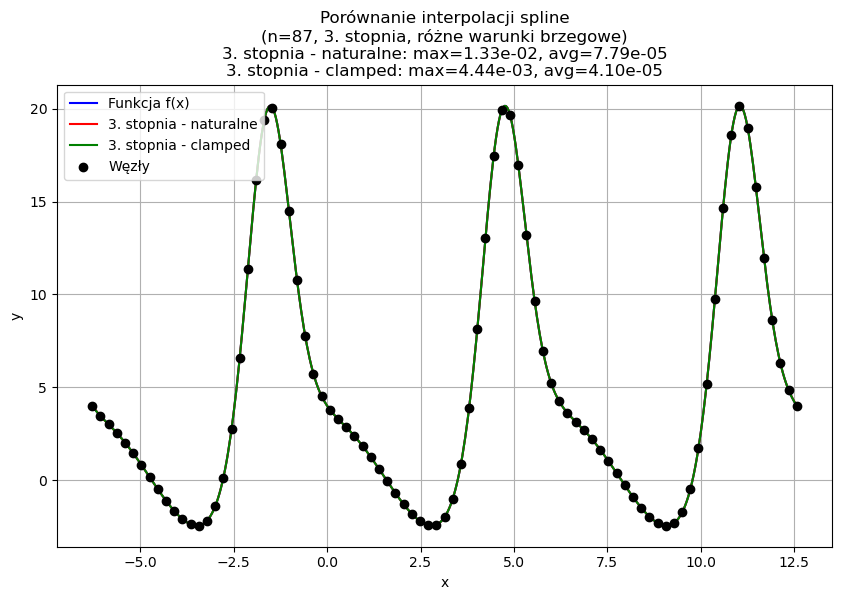

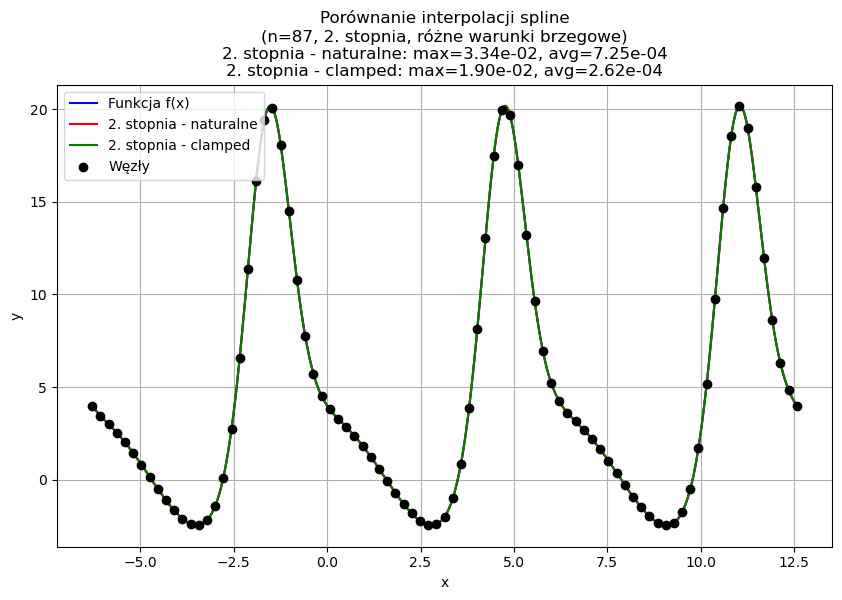

------------------
 Dla n = 87 węzłów
------------------

Cubic natural: błąd maksymalny = 1.334e-02, błąd średni = 7.791e-05
Cubic clamped: błąd maksymalny = 4.437e-03, błąd średni = 4.105e-05
Quadratic natural: błąd maksymalny = 3.339e-02, błąd średni = 7.252e-04
Quadratic clamped: błąd maksymalny = 1.901e-02, błąd średni = 2.618e-04
------------------
 Dla n = 88 węzłów
------------------



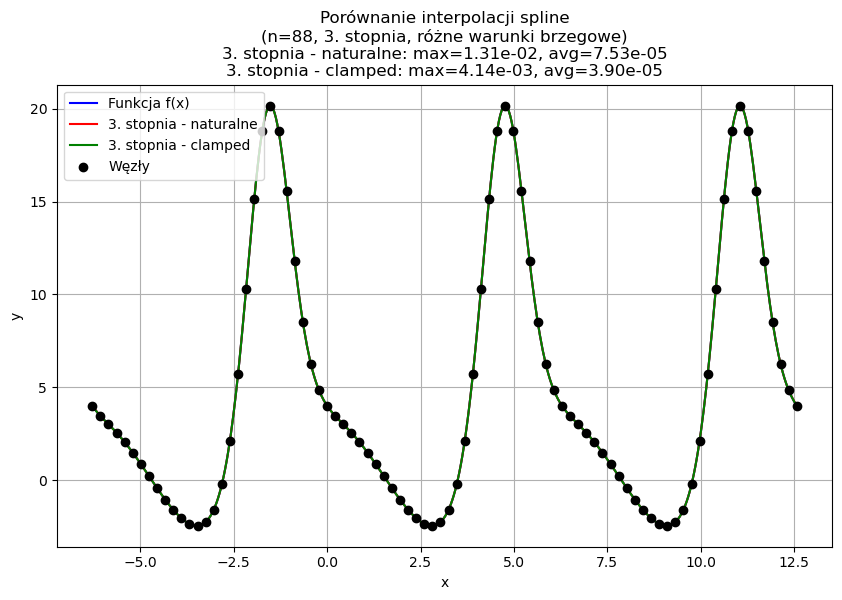

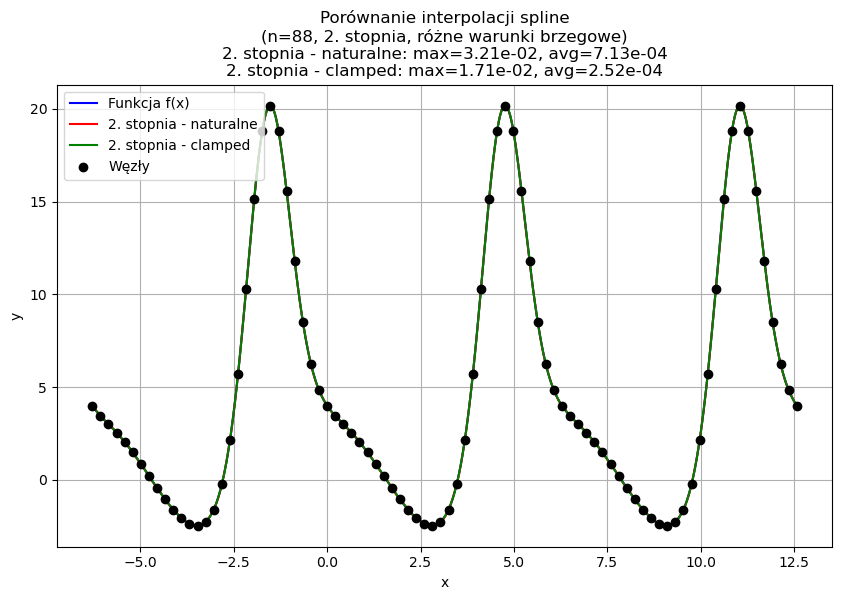

------------------
 Dla n = 88 węzłów
------------------

Cubic natural: błąd maksymalny = 1.307e-02, błąd średni = 7.530e-05
Cubic clamped: błąd maksymalny = 4.145e-03, błąd średni = 3.900e-05
Quadratic natural: błąd maksymalny = 3.208e-02, błąd średni = 7.128e-04
Quadratic clamped: błąd maksymalny = 1.709e-02, błąd średni = 2.519e-04
------------------
 Dla n = 89 węzłów
------------------



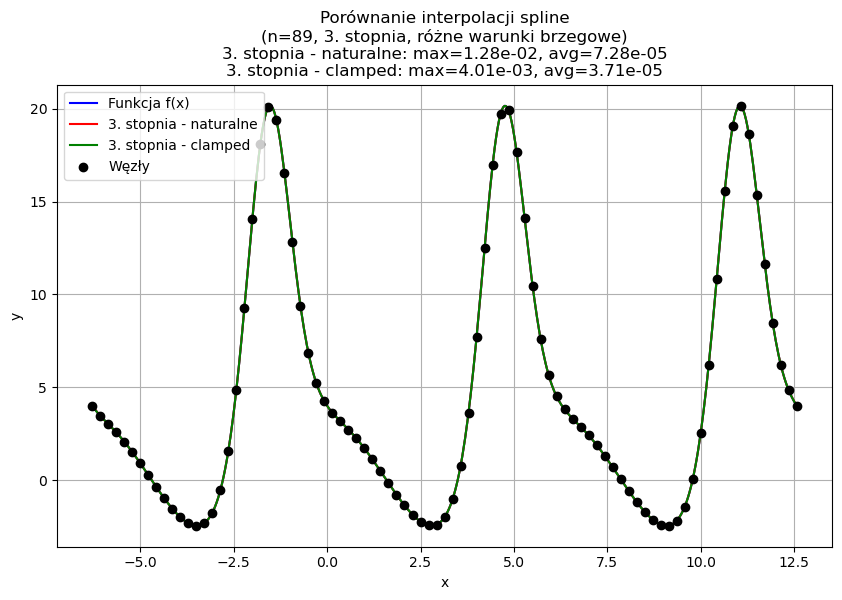

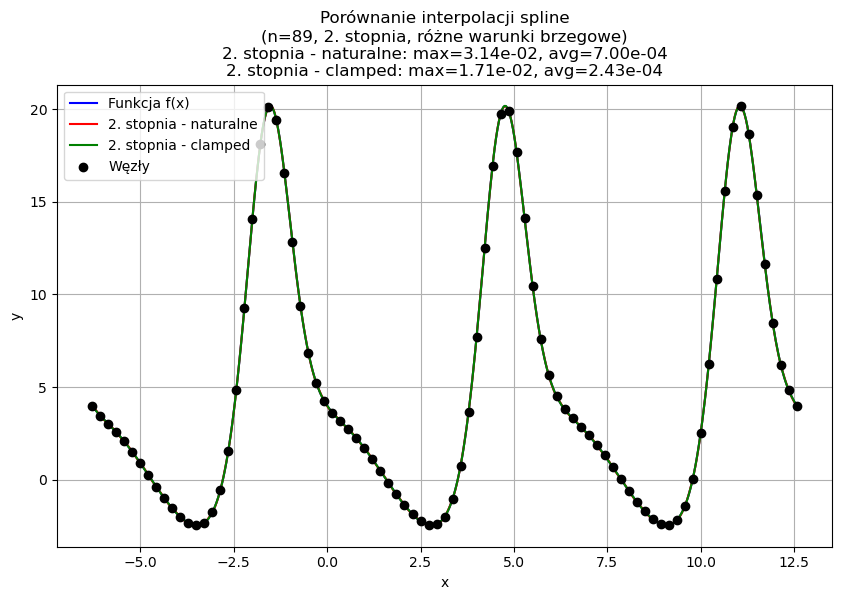

------------------
 Dla n = 89 węzłów
------------------

Cubic natural: błąd maksymalny = 1.281e-02, błąd średni = 7.282e-05
Cubic clamped: błąd maksymalny = 4.009e-03, błąd średni = 3.708e-05
Quadratic natural: błąd maksymalny = 3.143e-02, błąd średni = 7.003e-04
Quadratic clamped: błąd maksymalny = 1.708e-02, błąd średni = 2.429e-04
------------------
 Dla n = 90 węzłów
------------------



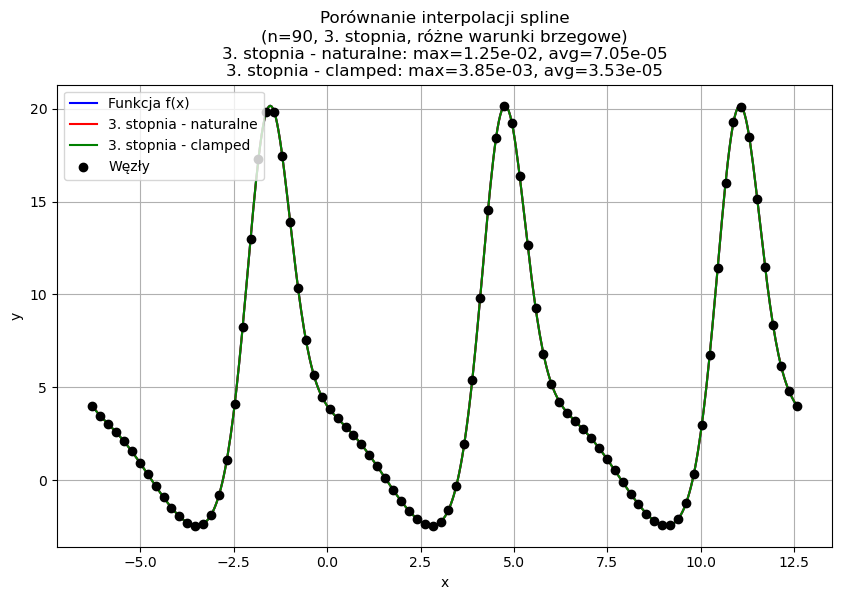

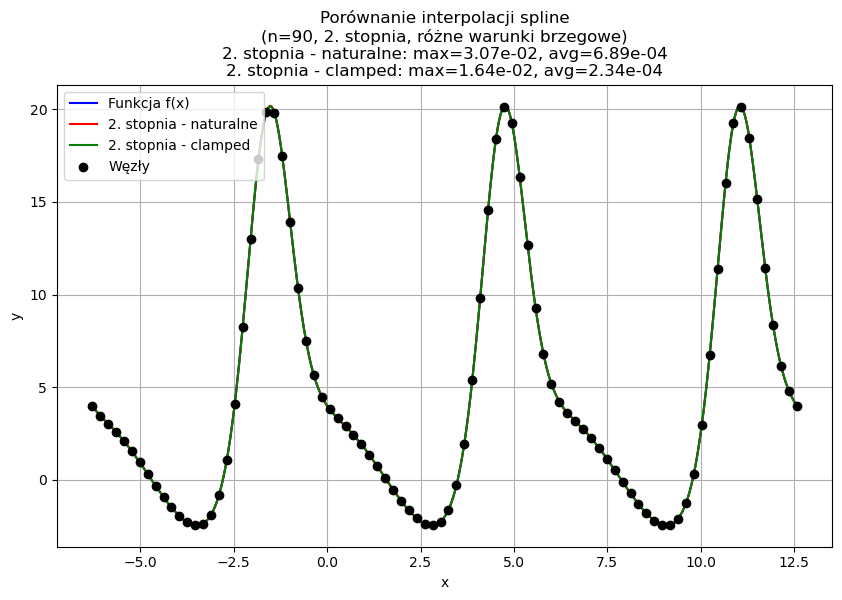

------------------
 Dla n = 90 węzłów
------------------

Cubic natural: błąd maksymalny = 1.255e-02, błąd średni = 7.047e-05
Cubic clamped: błąd maksymalny = 3.849e-03, błąd średni = 3.528e-05
Quadratic natural: błąd maksymalny = 3.069e-02, błąd średni = 6.885e-04
Quadratic clamped: błąd maksymalny = 1.644e-02, błąd średni = 2.340e-04
------------------
 Dla n = 91 węzłów
------------------



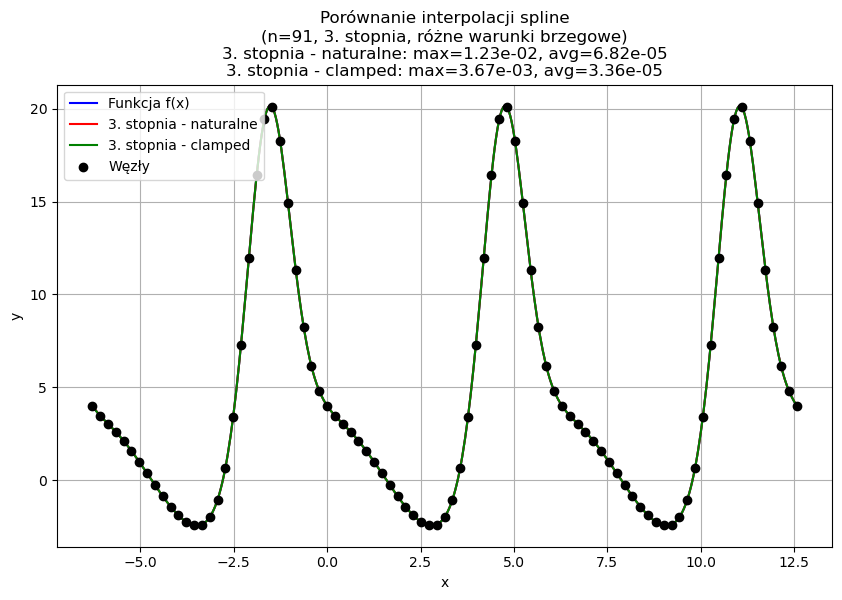

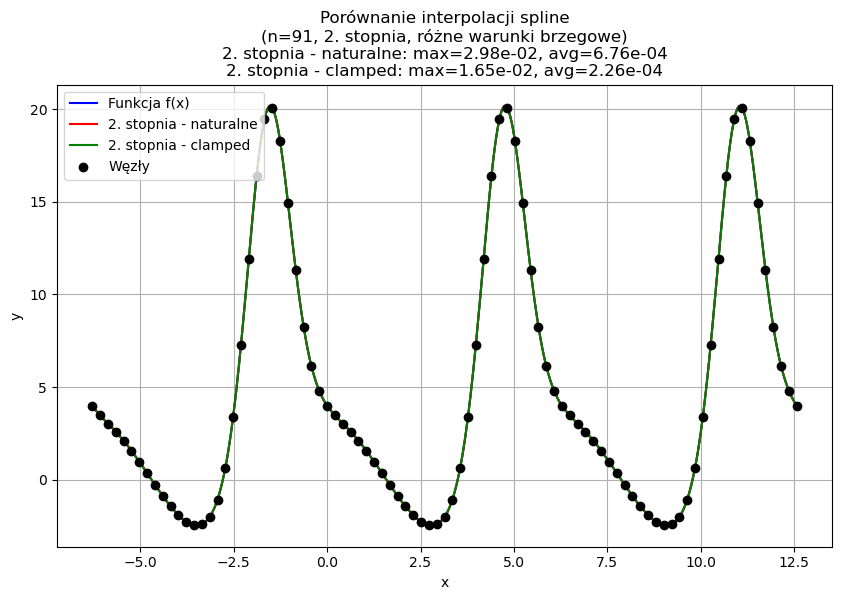

------------------
 Dla n = 91 węzłów
------------------

Cubic natural: błąd maksymalny = 1.229e-02, błąd średni = 6.822e-05
Cubic clamped: błąd maksymalny = 3.674e-03, błąd średni = 3.358e-05
Quadratic natural: błąd maksymalny = 2.982e-02, błąd średni = 6.765e-04
Quadratic clamped: błąd maksymalny = 1.654e-02, błąd średni = 2.259e-04
------------------
 Dla n = 92 węzłów
------------------



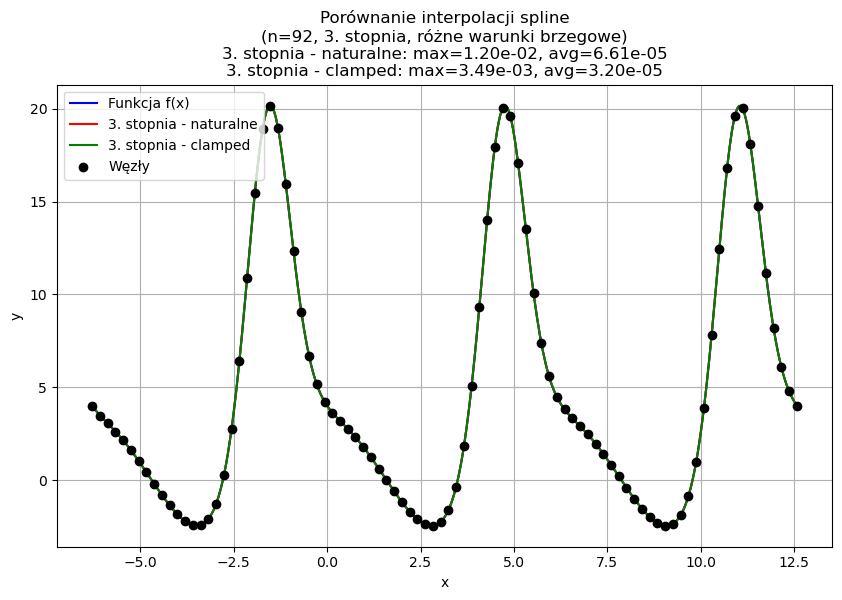

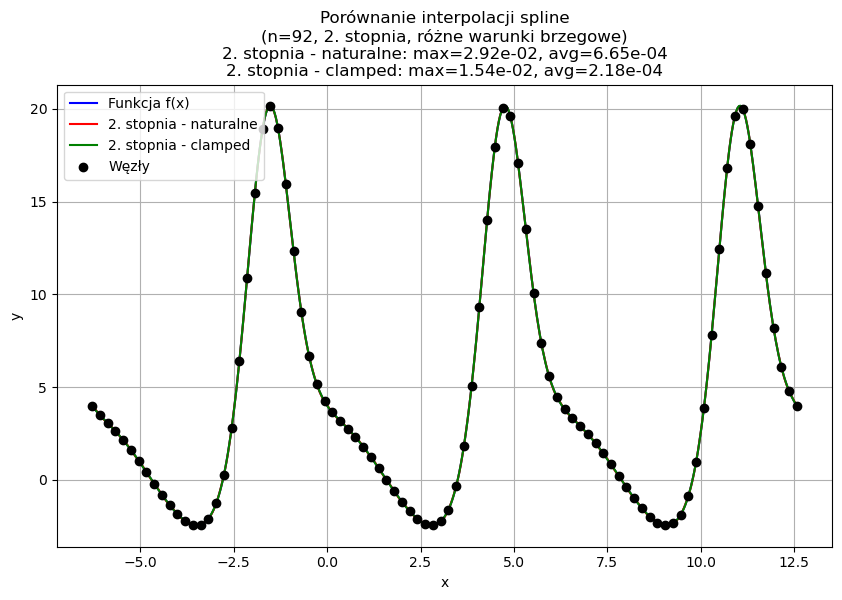

------------------
 Dla n = 92 węzłów
------------------

Cubic natural: błąd maksymalny = 1.204e-02, błąd średni = 6.609e-05
Cubic clamped: błąd maksymalny = 3.486e-03, błąd średni = 3.199e-05
Quadratic natural: błąd maksymalny = 2.918e-02, błąd średni = 6.653e-04
Quadratic clamped: błąd maksymalny = 1.535e-02, błąd średni = 2.178e-04
------------------
 Dla n = 93 węzłów
------------------



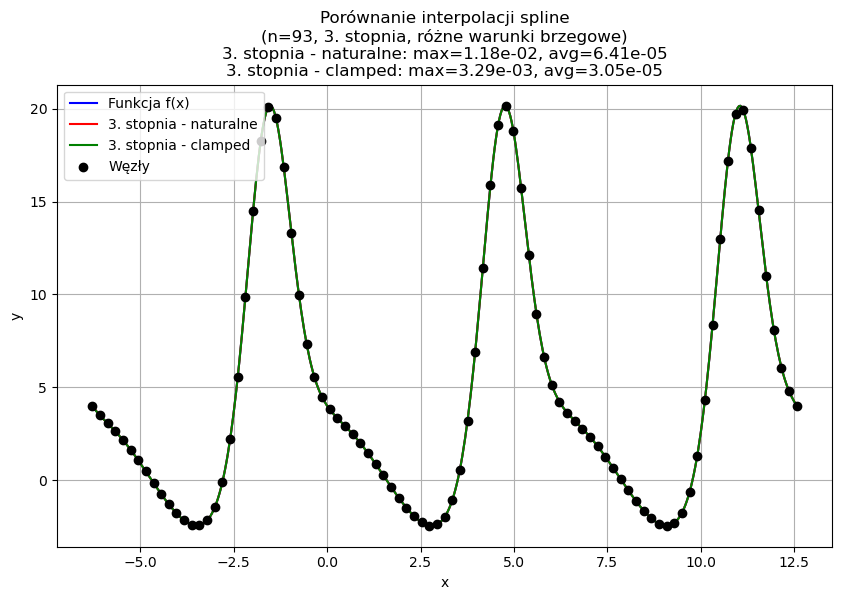

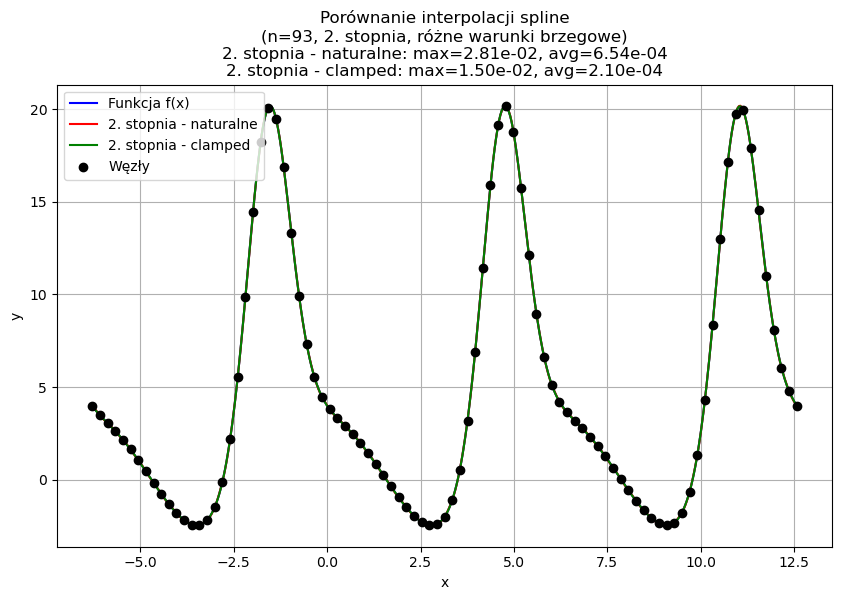

------------------
 Dla n = 93 węzłów
------------------

Cubic natural: błąd maksymalny = 1.180e-02, błąd średni = 6.405e-05
Cubic clamped: błąd maksymalny = 3.286e-03, błąd średni = 3.049e-05
Quadratic natural: błąd maksymalny = 2.805e-02, błąd średni = 6.540e-04
Quadratic clamped: błąd maksymalny = 1.500e-02, błąd średni = 2.104e-04
------------------
 Dla n = 94 węzłów
------------------



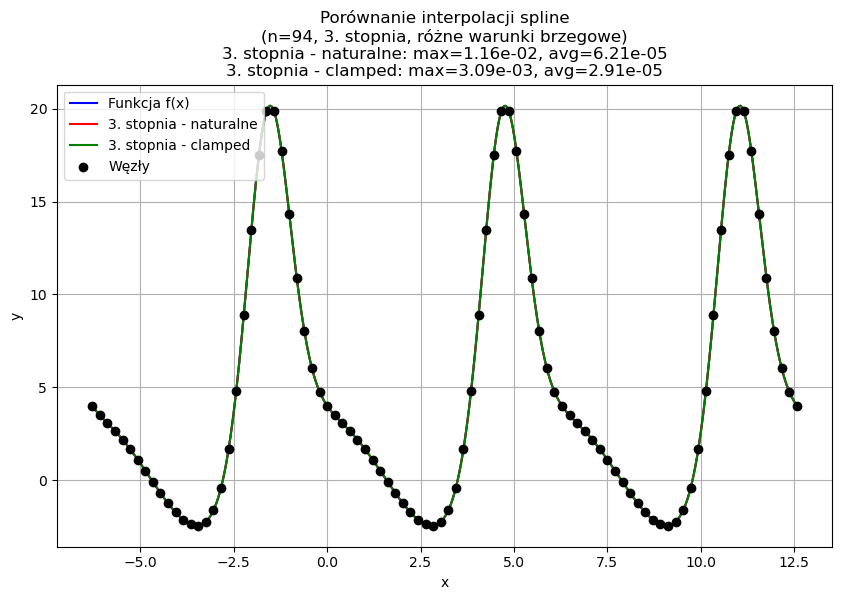

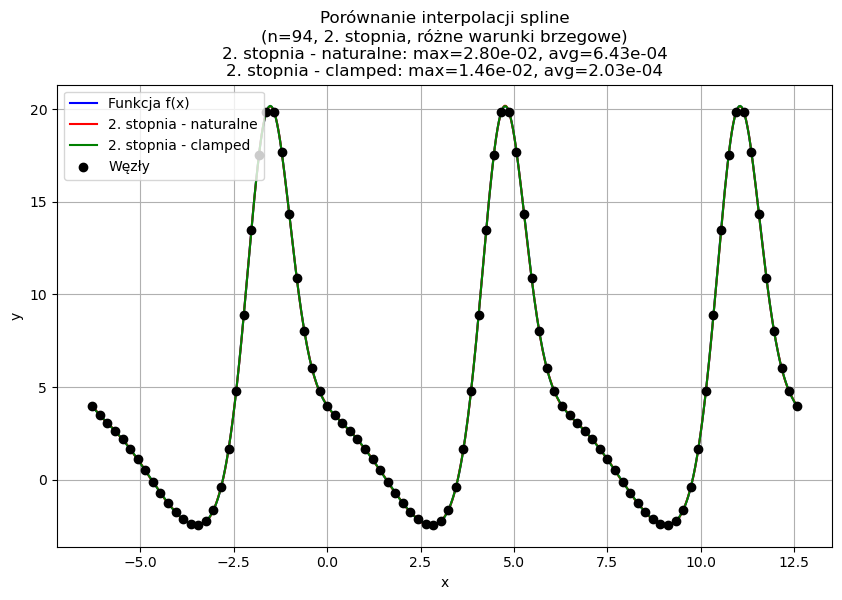

------------------
 Dla n = 94 węzłów
------------------

Cubic natural: błąd maksymalny = 1.156e-02, błąd średni = 6.211e-05
Cubic clamped: błąd maksymalny = 3.094e-03, błąd średni = 2.908e-05
Quadratic natural: błąd maksymalny = 2.797e-02, błąd średni = 6.432e-04
Quadratic clamped: błąd maksymalny = 1.455e-02, błąd średni = 2.032e-04
------------------
 Dla n = 95 węzłów
------------------



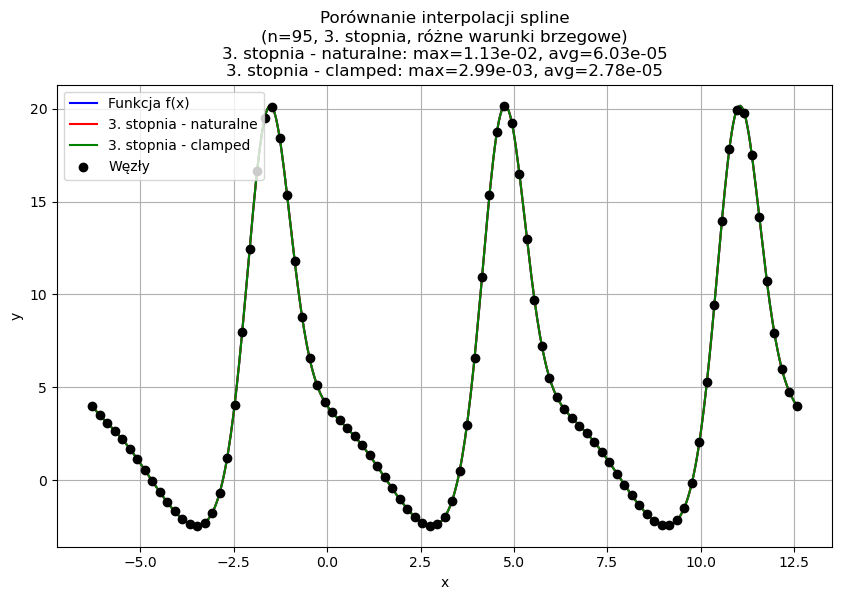

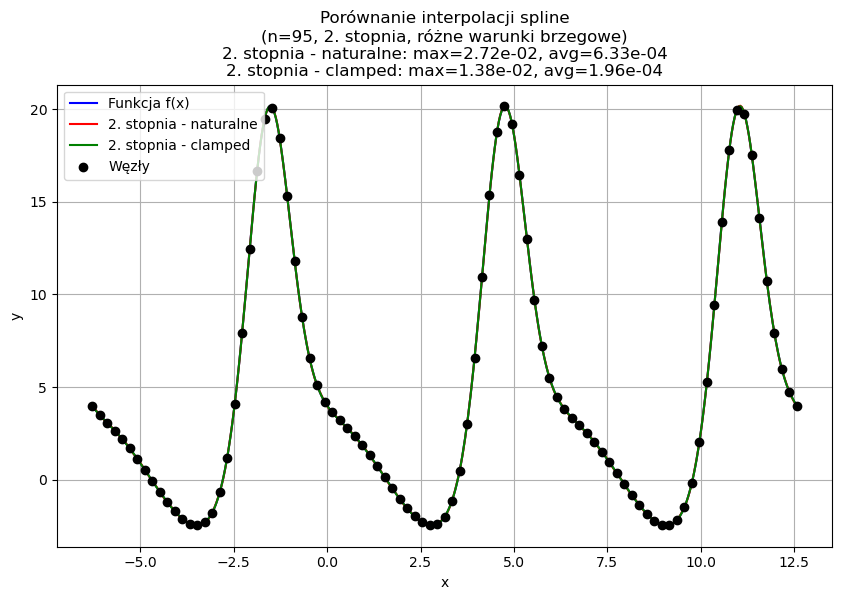

------------------
 Dla n = 95 węzłów
------------------

Cubic natural: błąd maksymalny = 1.133e-02, błąd średni = 6.025e-05
Cubic clamped: błąd maksymalny = 2.993e-03, błąd średni = 2.776e-05
Quadratic natural: błąd maksymalny = 2.715e-02, błąd średni = 6.326e-04
Quadratic clamped: błąd maksymalny = 1.376e-02, błąd średni = 1.964e-04
------------------
 Dla n = 96 węzłów
------------------



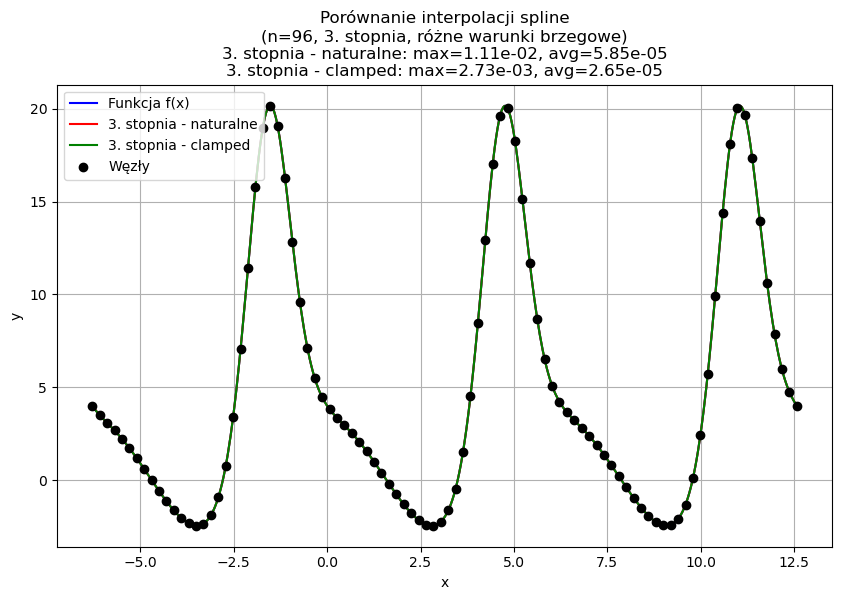

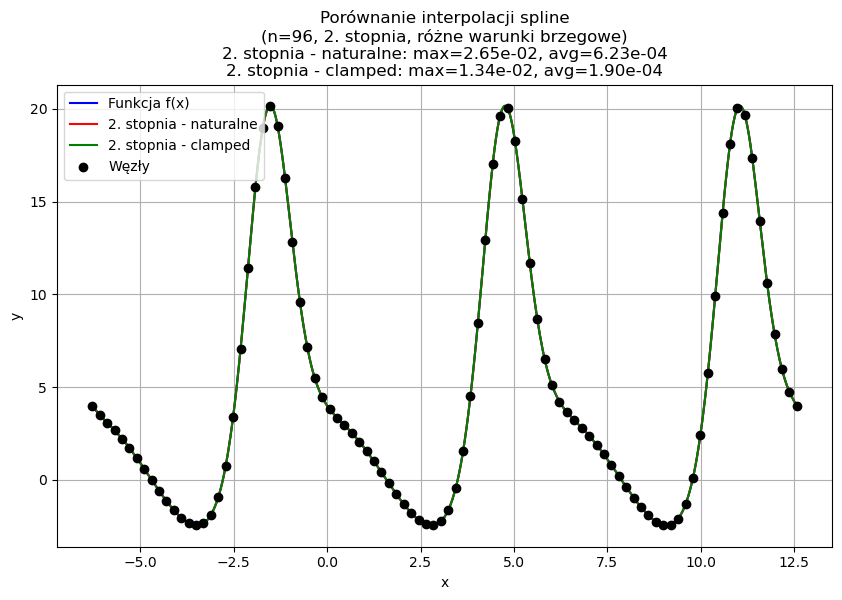

------------------
 Dla n = 96 węzłów
------------------

Cubic natural: błąd maksymalny = 1.110e-02, błąd średni = 5.848e-05
Cubic clamped: błąd maksymalny = 2.734e-03, błąd średni = 2.651e-05
Quadratic natural: błąd maksymalny = 2.648e-02, błąd średni = 6.226e-04
Quadratic clamped: błąd maksymalny = 1.336e-02, błąd średni = 1.900e-04
------------------
 Dla n = 97 węzłów
------------------



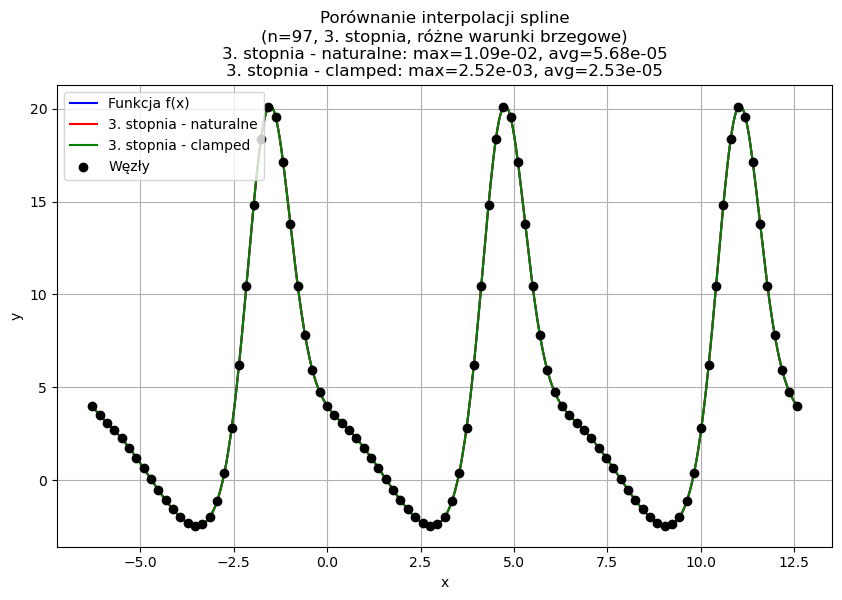

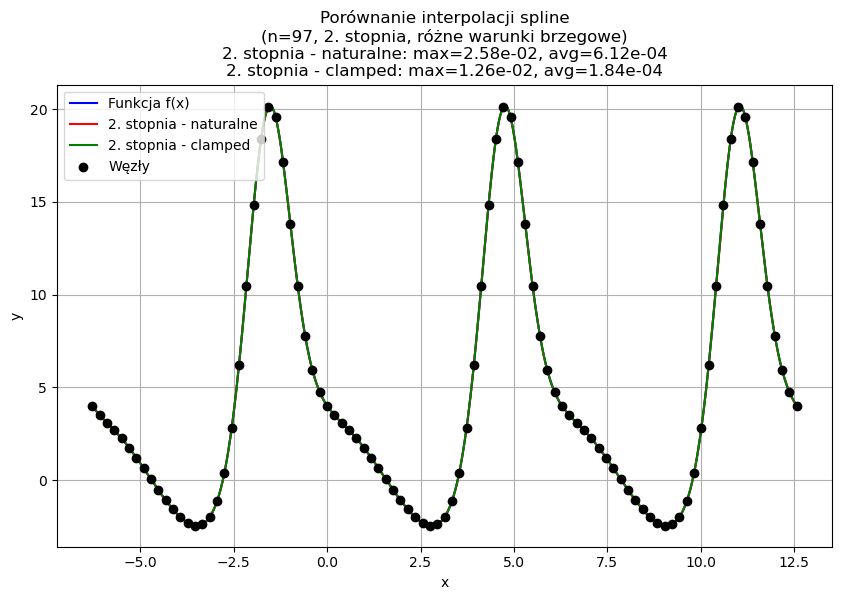

------------------
 Dla n = 97 węzłów
------------------

Cubic natural: błąd maksymalny = 1.088e-02, błąd średni = 5.678e-05
Cubic clamped: błąd maksymalny = 2.521e-03, błąd średni = 2.532e-05
Quadratic natural: błąd maksymalny = 2.578e-02, błąd średni = 6.123e-04
Quadratic clamped: błąd maksymalny = 1.257e-02, błąd średni = 1.835e-04
------------------
 Dla n = 98 węzłów
------------------



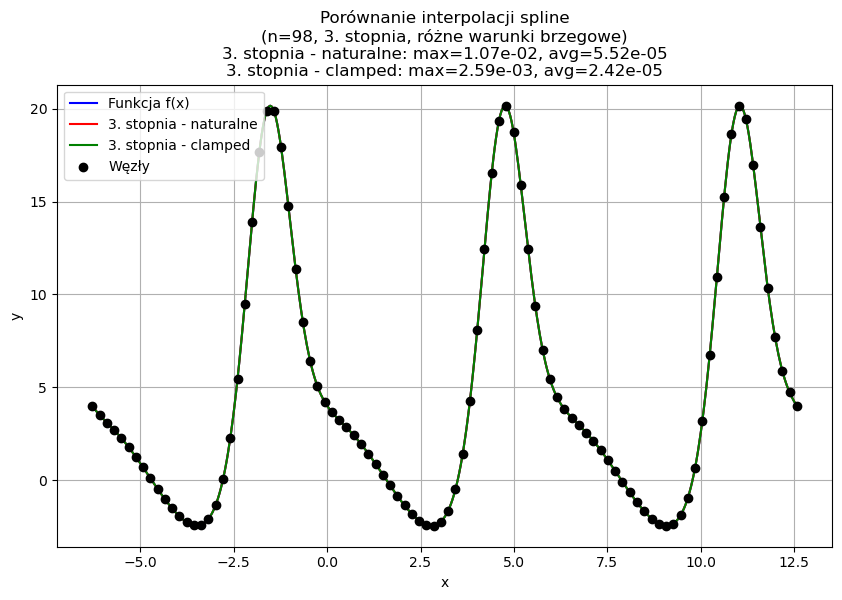

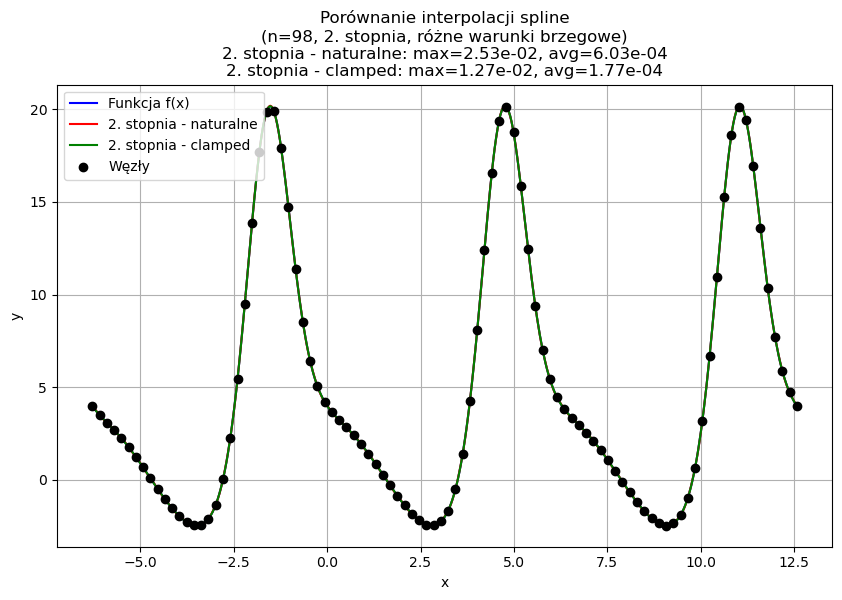

------------------
 Dla n = 98 węzłów
------------------

Cubic natural: błąd maksymalny = 1.066e-02, błąd średni = 5.516e-05
Cubic clamped: błąd maksymalny = 2.590e-03, błąd średni = 2.421e-05
Quadratic natural: błąd maksymalny = 2.529e-02, błąd średni = 6.027e-04
Quadratic clamped: błąd maksymalny = 1.267e-02, błąd średni = 1.774e-04
------------------
 Dla n = 99 węzłów
------------------



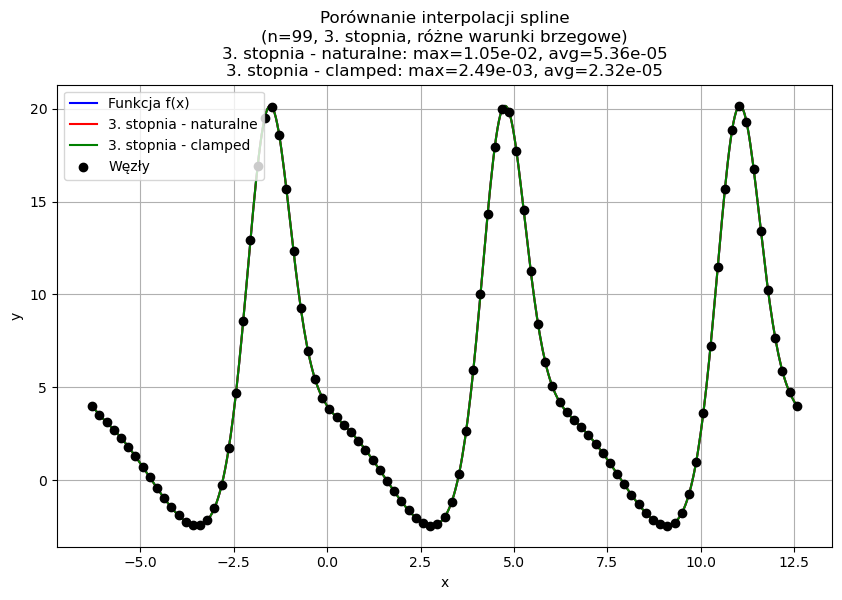

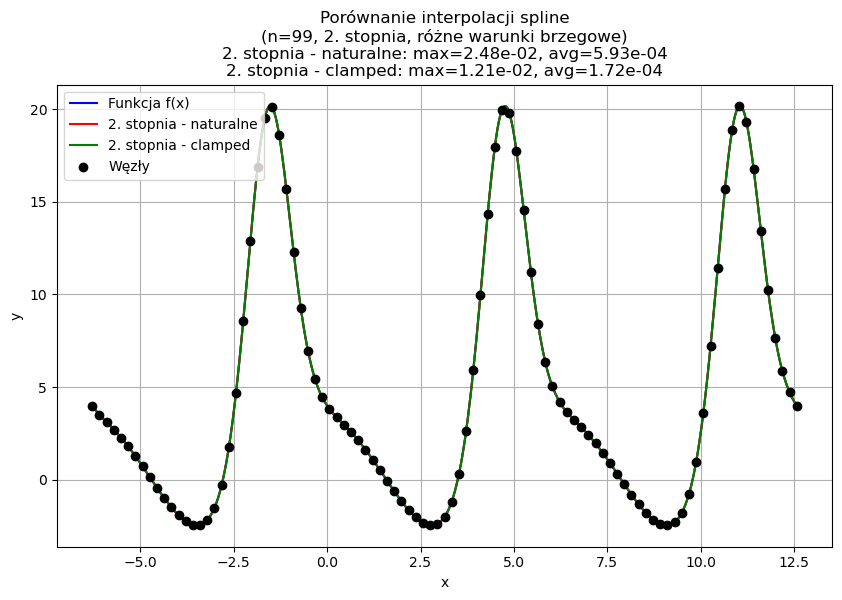

------------------
 Dla n = 99 węzłów
------------------

Cubic natural: błąd maksymalny = 1.045e-02, błąd średni = 5.361e-05
Cubic clamped: błąd maksymalny = 2.493e-03, błąd średni = 2.315e-05
Quadratic natural: błąd maksymalny = 2.480e-02, błąd średni = 5.929e-04
Quadratic clamped: błąd maksymalny = 1.211e-02, błąd średni = 1.717e-04
------------------
 Dla n = 100 węzłów
------------------



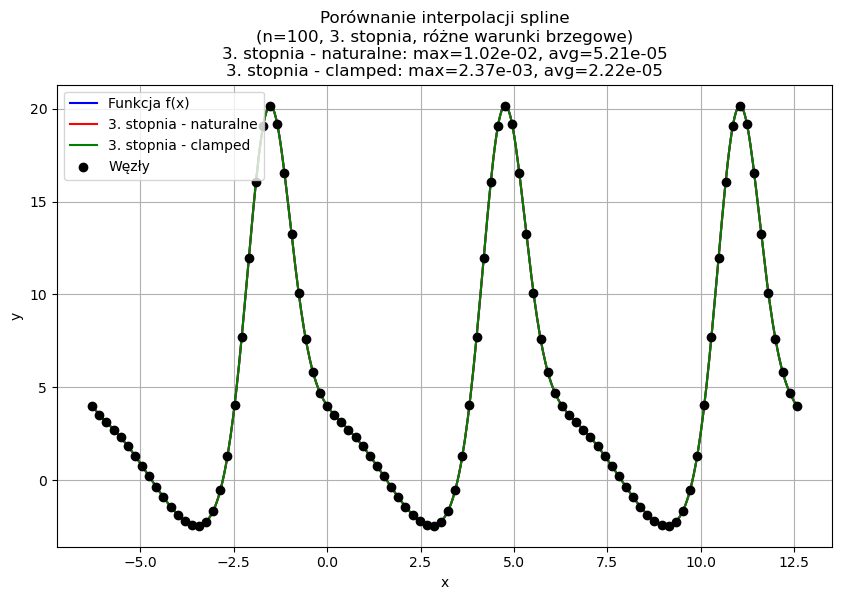

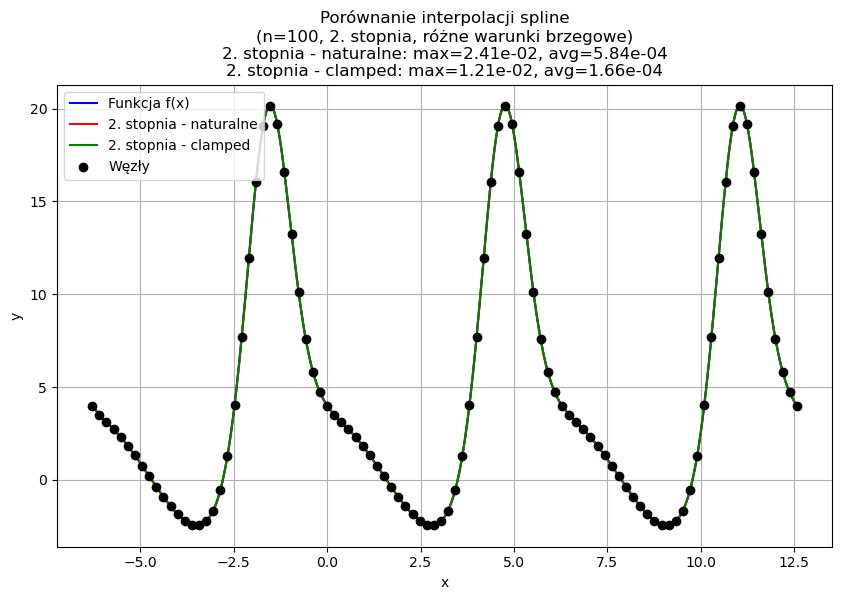

------------------
 Dla n = 100 węzłów
------------------

Cubic natural: błąd maksymalny = 1.024e-02, błąd średni = 5.212e-05
Cubic clamped: błąd maksymalny = 2.367e-03, błąd średni = 2.216e-05
Quadratic natural: błąd maksymalny = 2.411e-02, błąd średni = 5.838e-04
Quadratic clamped: błąd maksymalny = 1.205e-02, błąd średni = 1.662e-04


In [9]:
for n in range(3,101):
    print("------------------\n Dla n = {n} węzłów\n------------------\n".format(n=n))
    n_nodes = n
    x_nodes = uniform_nodes(a, b, n_nodes)
    y_nodes = f(x_nodes)

    # Spline sześcienne: naturalny i clamped
    cubic_coeffs_nat = cubic_spline_coeffs(x_nodes, y_nodes, bc_type='natural')
    cubic_coeffs_clamped = cubic_spline_coeffs(x_nodes, y_nodes, bc_type='clamped', f_deriv_func=f_deriv)

    # Funkcje interpolacyjne dla spline sześciennych
    def cubic_nat(x):
        return eval_cubic_spline(x, x_nodes, cubic_coeffs_nat)
    def cubic_clamped(x):
        return eval_cubic_spline(x, x_nodes, cubic_coeffs_clamped)

    plot_splines(
        x_nodes, y_nodes,
        spline_funcs=[cubic_nat, cubic_clamped],
        labels=["3. stopnia - naturalne", "3. stopnia - clamped"],
        title=f"Porównanie interpolacji spline\n(n={n}, 3. stopnia, różne warunki brzegowe)",
        true_func=f,
        a=a, b=b
    )

    # Spline kwadratowe: naturalny i clamped
    quad_coeffs_nat = quadratic_spline_coeffs(x_nodes, y_nodes, bc_type='natural')
    quad_coeffs_clamped = quadratic_spline_coeffs(x_nodes, y_nodes, bc_type='clamped', f_deriv_func=f_deriv)

    # Funkcje interpolacyjne dla spline kwadratowych
    def quad_nat(x):
        return eval_quadratic_spline(x, x_nodes, quad_coeffs_nat)
    def quad_clamped(x):
        return eval_quadratic_spline(x, x_nodes, quad_coeffs_clamped)

    plot_splines(
        x_nodes, y_nodes,
        spline_funcs=[quad_nat, quad_clamped],
        labels=["2. stopnia - naturalne", "2. stopnia - clamped"],
        title=f"Porównanie interpolacji spline\n(n={n}, 2. stopnia, różne warunki brzegowe)",
        true_func=f,
        a=a, b=b
    )
    
    print("------------------\n Dla n = {n} węzłów\n------------------\n".format(n=n))

    x_eval = np.linspace(a, b, 500)
    for name, spline in [("Cubic natural", cubic_nat),
                        ("Cubic clamped", cubic_clamped),
                        ("Quadratic natural", quad_nat),
                        ("Quadratic clamped", quad_clamped)]:
        max_err, mean_err = calculate_error(f, spline, x_eval)
        print(f"{name}: błąd maksymalny = {max_err:.3e}, błąd średni = {mean_err:.3e}")